The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


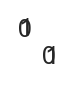

In [4]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
f,a = plt.subplots(1,1,figsize=(1e-2, 1e-2))
mpl.rcParams['figure.dpi'] = 150
sns.set_style('darkgrid')
import os,sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
import warnings
warnings.filterwarnings("ignore")
import glob
from tqdm.auto import tqdm
from datetime import datetime as dt
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import LabelEncoder
import torch
from torch import optim
from torch.utils.data import RandomSampler, SequentialSampler
from torch import nn
from torch.nn import functional as F
mpl.rcParams['figure.dpi'] = 180
# Load models together
%load_ext autoreload
%autoreload 2
    
from src.torch_utils import load_model_full
from src.utils import get_class_initcode_keys
from torch.utils.data import SequentialSampler
from src.datasets import *
from src.models import *
from src.utils import mkdirs, convert_path, pkl_dump, pkl_load, add_median_labels, get_palette
from src.data_processing import BL62_VALUES, BL62FREQ_VALUES, HLAS, AA_KEYS
from src.utils import pkl_load, pkl_dump, get_palette
from src.sim_utils import make_dist_matrix
from src.torch_utils import save_checkpoint, load_checkpoint
from src.train_eval import predict_model, train_eval_loops
from src.models import FullTCRVAE, TwoStageVAECLF
from src.multimodal_datasets import MultimodalMarginalLatentDataset
from src.multimodal_models import BSSVAE, JMVAE
from src.multimodal_train_eval import predict_multimodal
from src.metrics import reconstruction_accuracy, VAELoss, TripletLoss, CombinedVAELoss, compute_cosine_distance
from src.datasets import TCRSpecificDataset, FullTCRDataset
from src.cluster_utils import get_latent_df, load_model_full

# inits

In [2]:
from src.cluster_utils import get_all_rpauc
from joblib import Parallel, delayed

def get_best_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_best_not_agg(pd.read_csv(path)).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['epoch'] = out['input_type']
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    return out[[x for x in out.columns if not 'Unnamed' in x]]
    
def get_agg_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_agg(path).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    
    return out[[x for x in out.columns if not 'Unnamed' in x]]

def get_rpcurve_stats(maindir, set, which, idf='', filters=None):
    res = get_agg_given_dir_diag2(maindir, set, idf, None) if which=='agg' else get_best_given_dir_diag2(maindir, set, idf, None)
    # stupid for loop
    out = []
    for k in res.input_type.unique():
        tmp = res.query('input_type==@k')
        out.append(get_all_rpauc(tmp['retention'].values[1:-1], tmp['mean_purity'].values[1:-1], tmp['input_type'].unique()[0], tmp['name'].unique()[0]))
    return pd.DataFrame(out).sort_values('p70_r35_auc',ascending=False)
def rpauc_wrapper(df, input_type):
    tmp = df.query('input_type==@input_type')
    ret = tmp['retention'].values[1:-1]
    pur = tmp['mean_purity'].values[1:-1]
    return get_all_rpauc(ret, pur, input_type, None)
    
def find_best_not_agg(intervals, nm=None):
    tmp = intervals.query('not input_type.str.contains("TBCR") and not input_type.str.startswith("agg") and not input_type.str.contains("tcrdist")')
    results = pd.DataFrame(Parallel(n_jobs=5)(delayed(rpauc_wrapper)(df=tmp, input_type=k) for k in tmp.input_type.unique()))
    best=results.sort_values('p70_r35_auc', ascending=False).head(1).input_type.item()
    return tmp.query('input_type==@best')

def find_agg(fn):
    return pd.read_csv(fn).query('input_type.str.contains("agg")')


def get_agg_given_dir(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    return pd.concat([baselines] + [find_agg(x) for x in folders]).assign(identifier=idf)
    
def get_best_given_dir(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    return pd.concat([baselines] + [find_best_not_agg(pd.read_csv(x)) for x in folders]).assign(identifier=idf)

In [ ]:
# Joakim functions
from src.networkx_utils import collect_init_subgraphs, create_graph_from_subgraphsets, trim_graph_into_subgraphs
priority_abags = set()

#create initial graphs
#abag_adjmatrix np.array (nr_seq, nr_seqs)
init_graph = nx.Graph(agg_array)
datasize = len(init_graph)
size_cutoff = 3

okay_subgraphs, subgraphs_to_trim = collect_init_subgraphs(init_graph, size_cutoff = size_cutoff)
print(f"Number of decently sized subgraphs  {len(okay_subgraphs)}")
print(f"Number of subgraphs that need to be trimmed {len(subgraphs_to_trim)}")

if subgraphs_to_trim:
    trimmed_subgraphs = []
    for g in subgraphs_to_trim: trimmed_subgraphs.extend(trim_graph_into_subgraphs(g, size_cutoff=size_cutoff, priority_nodes=priority_abags,
                                                                                   remove_multnodes=remove_multnodes, priority_limit=priority_limit))
#trim the graphs
all_graphs = okay_subgraphs + trimmed_subgraphs
finalG = create_graph_from_subgraphsets(init_graph, all_graphs)
finalG_subgraphs = list(nx.connected_components(finalG))
final_sizes = [len(t) for t in finalG_subgraphs ]
print(f"Final graph sizes {final_sizes}")

In [5]:
new_df = pd.read_csv('../data/multimodal/240311_nettcr_pairedAB_expanded_noswap.csv')
old_df = pd.read_csv('../data/filtered/240416_nettcr_old_26pep_no_swaps.csv')
new_df_78 = pd.read_csv('../data/filtered/240507_nettcr_exp_pruned_noswap_78peps.csv')
new_df_17 = pd.read_csv('../data/filtered/240418_nettcr_expanded_20binders_17pep_POSONLY.csv')
old_df_15 = pd.read_csv('../data/filtered/240416_nettcr_old_top15peps_no_swaps.csv')
old_df_20 = pd.read_csv('../data/filtered/240507_nettcr_old_pruned_noswap_20peps.csv')

In [4]:
tbcr = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0)
tbcr_valid = tbcr.query('partition==0')
tbcr_valid = tbcr_valid[[str(x) for x in tbcr_valid.index]+['peptide','binder','partition','raw_index']]
tbcr_array = tbcr_valid.iloc[:len(tbcr_valid), :len(tbcr_valid)].values

In [5]:
tcrdist = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_cdr3_distmatrix_140peps_labeled.csv')

In [6]:
import networkx as nx
from src.cluster_utils import *

# Checking distmatrix 

## old stuff

In [13]:
files_dict = pkl_load('../output/240411_ClusteringTests/files_dict.pkl')
comp_dict = pkl_load('../output/240411_ClusteringTests/comp_dict.pkl')

In [37]:
# Select the best model from FullExp 0200 KL 1e-1
folder = files_dict['FullExp_KL_1e-1']
join = '_'.join([comp_dict['FullExp_KL_1e-1'][-2], comp_dict['FullExp_KL_1e-1'][-1]])+'_'
js = glob.glob(f'{folder}*kwargs*.json')[0]
pt = glob.glob(f'{folder}*{join}*.pt')[0]
model = load_model_full(pt, js, map_location='cpu')
latent_df = get_latent_df(model, pd.read_csv('../data/filtered/240418_nettcr_expanded_20binders_17pep_POSONLY.csv').query('partition==0'))

Reloading best model:
epoch: 10000
total: 0.133039653301239
reconstruction: 0.0919111892580986
kld: 0.024339670315384865
triplet: 0.016788793727755547
seq_accuracy: 0.9892194867134094
pos_accuracy: 0.9978100657463074
{'max_len_a1': 7, 'max_len_a2': 8, 'max_len_a3': 22, 'max_len_b1': 6, 'max_len_b2': 7, 'max_len_b3': 23, 'max_len_pep': 0, 'encoding': 'BL50LO', 'pad_scale': -20, 'a1_col': 'A1', 'a2_col': 'A2', 'a3_col': 'A3', 'b1_col': 'B1', 'b2_col': 'B2', 'b3_col': 'B3', 'pep_col': 'peptide', 'add_positional_encoding': True}


In [39]:
tbcr_valid['original_peptide'] = tbcr_valid['peptide']
tbcr_valid, tbcr_array = resort_baseline(tbcr_valid, latent_df, 'raw_index')
dist_matrix, dist_array, features, labels, encoded_labels, label_encoder = get_distances_labels_from_latent(latent_df)
other_array = tbcr_valid.iloc[:len(tbcr_valid), :len(tbcr_valid)].values
agg_array = 1 - np.multiply(1-dist_array, 1-other_array)


1471


In [40]:
len(latent_df), agg_array.shape

(1471, (1471, 1471))

In [41]:
G = nx.Graph(agg_array)
G

In [42]:
G.get_edge_data(1,2), agg_array[1,2]

({'weight': 0.4357023471901318}, 0.4357023471901318)

In [43]:
T = nx.minimum_spanning_tree(G)

In [ ]:
from src.networkx_utils import collect_init_subgraphs, create_graph_from_subgraphsets, trim_graph_into_subgraphs
priority_abags = set()

#create initial graphs
#abag_adjmatrix np.array (nr_seq, nr_seqs)
init_graph = nx.Graph(agg_array)
datasize = len(init_graph)
size_cutoff = 3

okay_subgraphs, subgraphs_to_trim = collect_init_subgraphs(init_graph, size_cutoff = size_cutoff)
print(f"Number of decently sized subgraphs  {len(okay_subgraphs)}")
print(f"Number of subgraphs that need to be trimmed {len(subgraphs_to_trim)}")

if subgraphs_to_trim:
    trimmed_subgraphs = []
    for g in subgraphs_to_trim: trimmed_subgraphs.extend(trim_graph_into_subgraphs(g, size_cutoff=size_cutoff, priority_nodes=priority_abags,
                                                                                   remove_multnodes=remove_multnodes, priority_limit=priority_limit))
#trim the graphs
all_graphs = okay_subgraphs + trimmed_subgraphs
finalG = create_graph_from_subgraphsets(init_graph, all_graphs)
finalG_subgraphs = list(nx.connected_components(finalG))
final_sizes = [len(t) for t in finalG_subgraphs ]
print(f"Final graph sizes {final_sizes}")

## Check with a small subset

In [9]:
subset_df = pd.read_csv('../data/filtered/240326_nettcr_paired_NOswaps.csv').query('peptide in ["GILGFVFTL", "RAKFKQLL", "LLWNGPMAV", "YLQPRTFLL","ELAGIGILTV"] and partition==0')

In [10]:
# load a CNN expAll small model to run agg matrix on the side
# load CNNVAE_ExpAl|_Smallerepoch_2500
# model = load_model_full('../output/240516_CNNVAE_DiffDatasets/240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch/epoch_2500_interval_checkpoint__fold00_kcv_240326_nettcr_paired_NOswaps_f00_240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch.pt',
#                         '../output/240516_CNNVAE_DiffDatasets/240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch_JSON_kwargs.json')

model = load_model_full('../output/240527_DiagnosticRound2/RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy.pt',
                        '../output/240527_DiagnosticRound2/RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy_JSON_kwargs.json')

latent = get_latent_df(model, subset_df)
xx = get_distances_labels_from_latent(latent, index_col='raw_index')
dm, da, labels = xx[0], xx[1], xx[3]

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
No GPUs available. Using CPU.
Reloading best model:
Best epoch: 19887
total: 0.08891265526269541
reconstruction: 0.07188191963953366
kld: 0.0003216291428662358
triplet: 0.016709108045253444
seq_accuracy: 0.9925578236579895
pos_accuracy: 0.9987985491752625


In [11]:
tbcr_subset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('peptide in ["GILGFVFTL", "RAKFKQLL", "LLWNGPMAV", "YLQPRTFLL","ELAGIGILTV"] and partition==0')
tbcr_subset.groupby('peptide').count()

,0,1,2,3,4,5,6,7,8,9,...,9763,9764,9765,9766,9767,9768,original_peptide,binder,partition,raw_index
peptide,,,,,,,,,,,,,,,,,,,,,
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,...,92,92,92,92,92,92,92,92,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,...,233,233,233,233,233,233,233,233,233,233
LLWNGPMAV,75,75,75,75,75,75,75,75,75,75,...,75,75,75,75,75,75,75,75,75,75
RAKFKQLL,166,166,166,166,166,166,166,166,166,166,...,166,166,166,166,166,166,166,166,166,166
YLQPRTFLL,80,80,80,80,80,80,80,80,80,80,...,80,80,80,80,80,80,80,80,80,80


In [12]:
tbcr_subset, tbcr_subda = resort_baseline(tbcr_subset, dm, 'raw_index')

In [13]:
# Reset index and columns for DM so they match the tbcr subset 
dm.reset_index(drop=True, inplace=True)
dm.index = tbcr_subset.index.copy()
dm.columns = [list(tbcr_subset.index.copy()) + ['peptide', 'binder', 'origin', 'original_peptide', 'raw_index']]

# THEN CAN do the same subsampling //

In [14]:
# subsample to 4 and subsample a few
subsample = []
for p in tbcr_subset.peptide.unique():
    if p=="GILGFVFTL" or p=="RAKFKQLL":
        frac=0.5
    else:
        frac=0.9
    subsample.append(tbcr_subset.query('peptide==@p').sample(frac=frac, random_state=13))
tbcr_test = pd.concat(subsample)
tbcr_test = tbcr_test[[str(x) for x in tbcr_test.index]+['binder','partition','raw_index','peptide','original_peptide']]
dm_test = dm.loc[tbcr_test.index][list(tbcr_test.index.copy())+['peptide','binder','origin','original_peptide','raw_index']]
# Reset index to ordinal to match NetworkX tree just for this example
tbcr_test.reset_index(drop=True, inplace=True)
dm_test.reset_index(drop=True, inplace=True)
tbcr_test.columns = tbcr_test.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
dm_test.columns = dm_test.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
tbcr_test.groupby('peptide').count()

dm_test = dm_test.sort_values('peptide')
dm_test = dm_test[dm_test.index.tolist() + ['binder','partition','raw_index','peptide']]
tbcr_test = tbcr_test.sort_values('peptide')
tbcr_test = tbcr_test[tbcr_test.index.tolist() + ['binder','partition','raw_index','peptide']]

In [15]:
tbcr_test.groupby('peptide').agg(count=(0, 'count'))

,count
peptide,
ELAGIGILTV,83
GILGFVFTL,116
LLWNGPMAV,68
RAKFKQLL,83
YLQPRTFLL,72


In [16]:
# Take min-max for better visualization
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
mms = MinMaxScaler()
le = LabelEncoder()
labels = dm_test['peptide'].values
encoded_labels = le.fit_transform(labels)

da_test = dm_test[dm_test.index].values
da_tbcr = tbcr_test[tbcr_test.index].values
da_agg1 = 1-np.multiply( mms.fit_transform((1-da_test)), mms.fit_transform((1-da_tbcr)))
da_agg2 = 1-np.multiply( (1-da_test), (1-da_tbcr))


### distance matrix stats and heatmaps 

In [17]:
import numpy as np

# Evaluate dist matrix
def evaluate_distance_matrix(distance_matrix, labels):
    unique_classes = np.unique(labels)
    intra_class_distances = []
    inter_class_distances = []

    # Compute intra-class distances
    for class_label in unique_classes:
        intra_indices = np.where(labels == class_label)[0]
        intra_class_distances.append(distance_matrix[np.ix_(intra_indices, intra_indices)].mean())

    # Compute inter-class distances
    for i, class1 in enumerate(unique_classes):
        for j, class2 in enumerate(unique_classes):
            if class1 != class2:
                indices1 = np.where(labels == class1)[0]
                indices2 = np.where(labels == class2)[0]
                inter_class_distances.append(distance_matrix[np.ix_(indices1, indices2)].mean())

    mean_intra = np.mean(intra_class_distances)
    mean_inter = np.mean(inter_class_distances)
    ratio = mean_intra / mean_inter

    return mean_intra, mean_inter, ratio

# Assuming distance_matrix1, distance_matrix2, distance_matrix3, and labels are defined
results1 = evaluate_distance_matrix(mms.fit_transform(da_test), encoded_labels)
results2 = evaluate_distance_matrix(mms.fit_transform(da_tbcr), encoded_labels)
results3 = evaluate_distance_matrix(da_agg1, encoded_labels)
results4 = evaluate_distance_matrix(mms.fit_transform(da_agg2), encoded_labels)

print("Results for CNNVAE:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results1))
print("Results for TBCRalign:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results2))
print("Results for aggregate1:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results3))
print("Results for aggregate2:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results4))


Results for CNNVAE:	Intra-class: 0.6583, Inter-class: 0.7352, Ratio: 0.8954
Results for TBCRalign:	Intra-class: 0.6832, Inter-class: 0.7416, Ratio: 0.9213
Results for aggregate1:	Intra-class: 0.8729, Inter-class: 0.9271, Ratio: 0.9415
Results for aggregate2:	Intra-class: 0.7338, Inter-class: 0.8042, Ratio: 0.9124


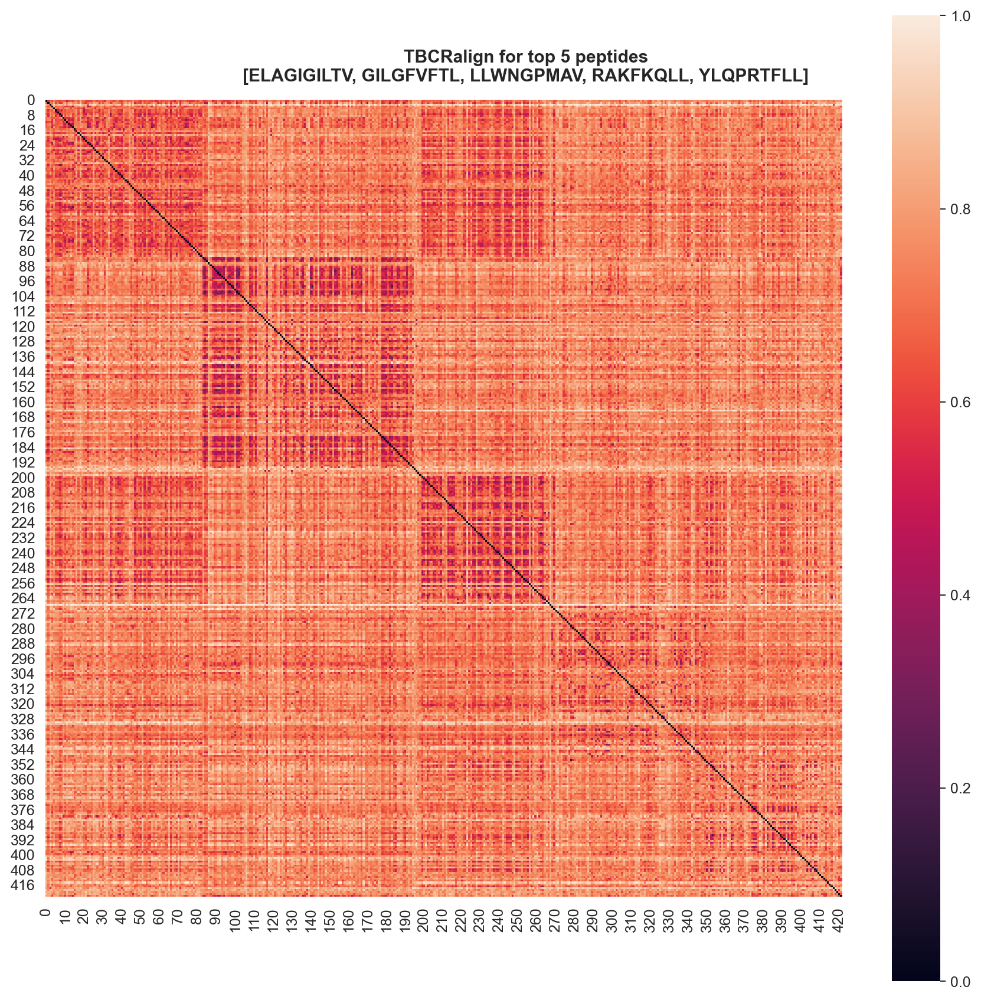

In [16]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap( mms.fit_transform(da_tbcr), square=True, ax = a)
f.suptitle('TBCRalign for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]',fontweight='semibold',  y=0.9)
f.tight_layout()

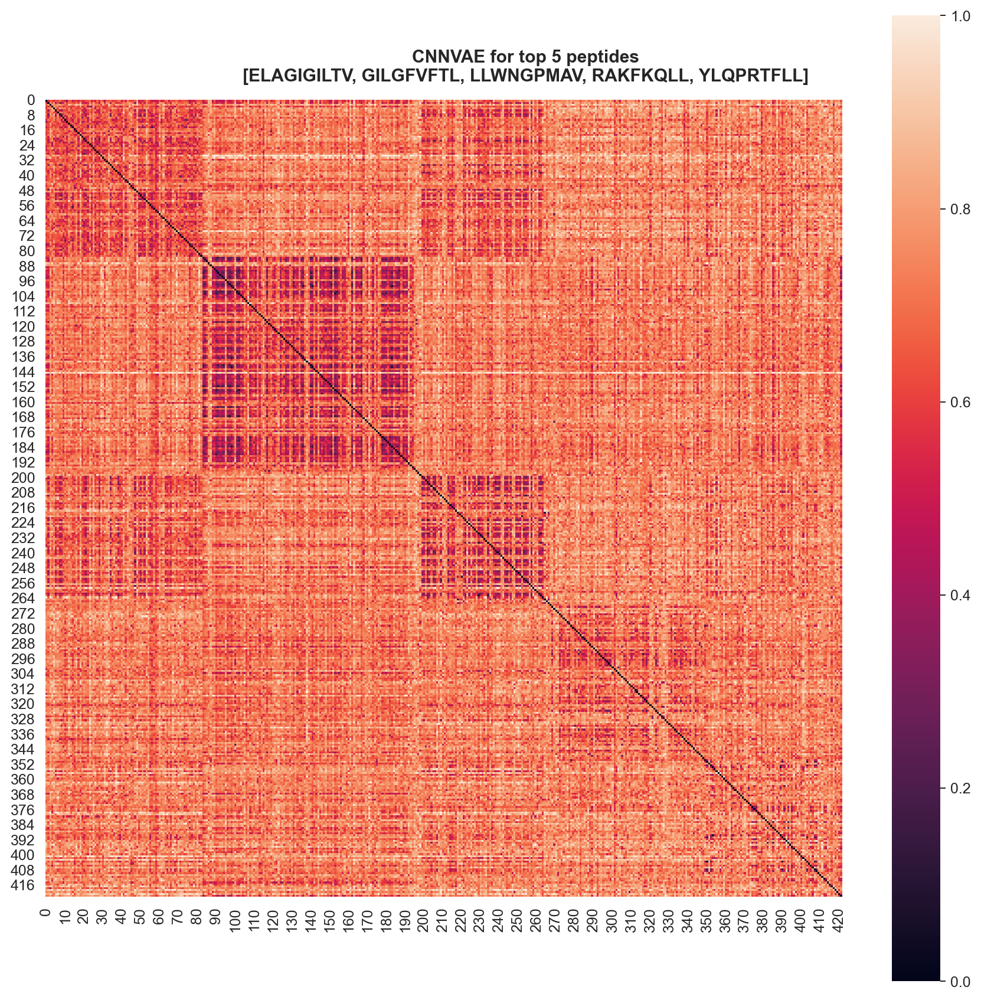

In [17]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_test), square=True, ax = a)
f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
f.tight_layout()

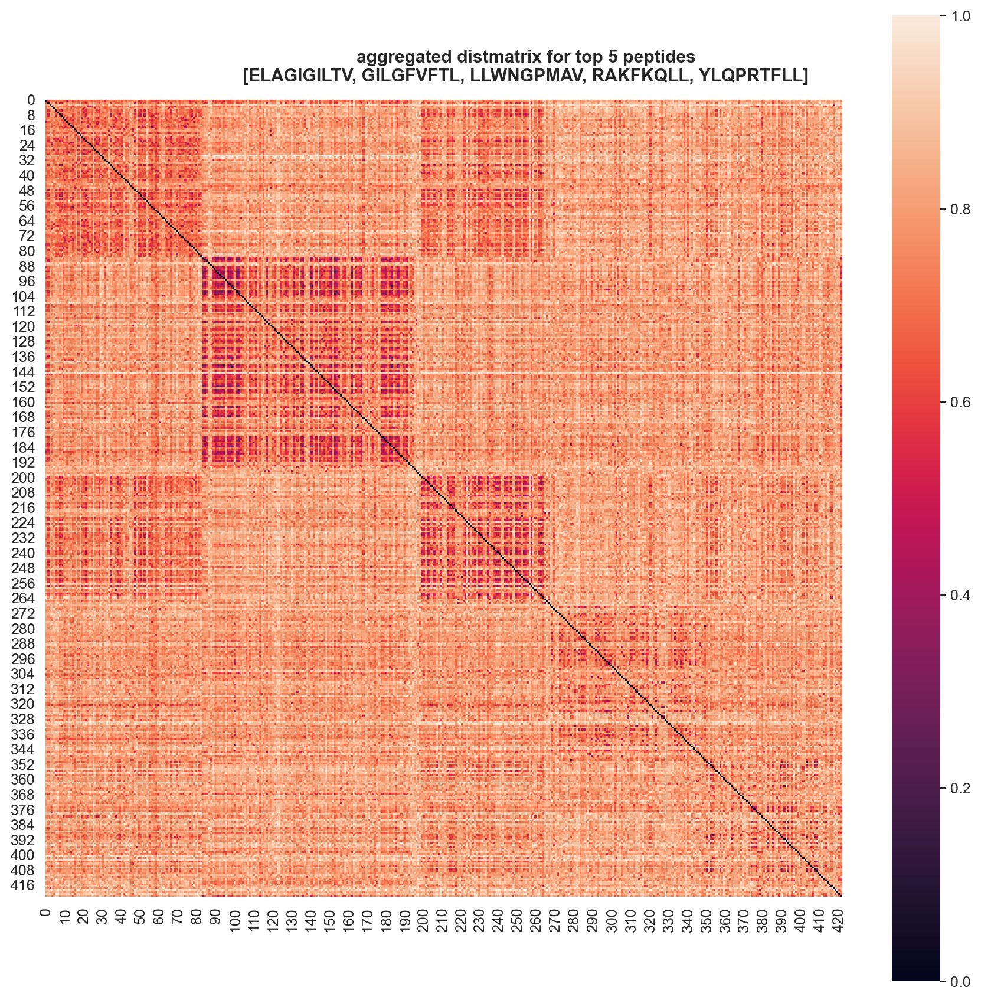

In [18]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_agg2), square=True, ax = a)
f.suptitle('aggregated distmatrix for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold',y=0.9)
f.tight_layout()

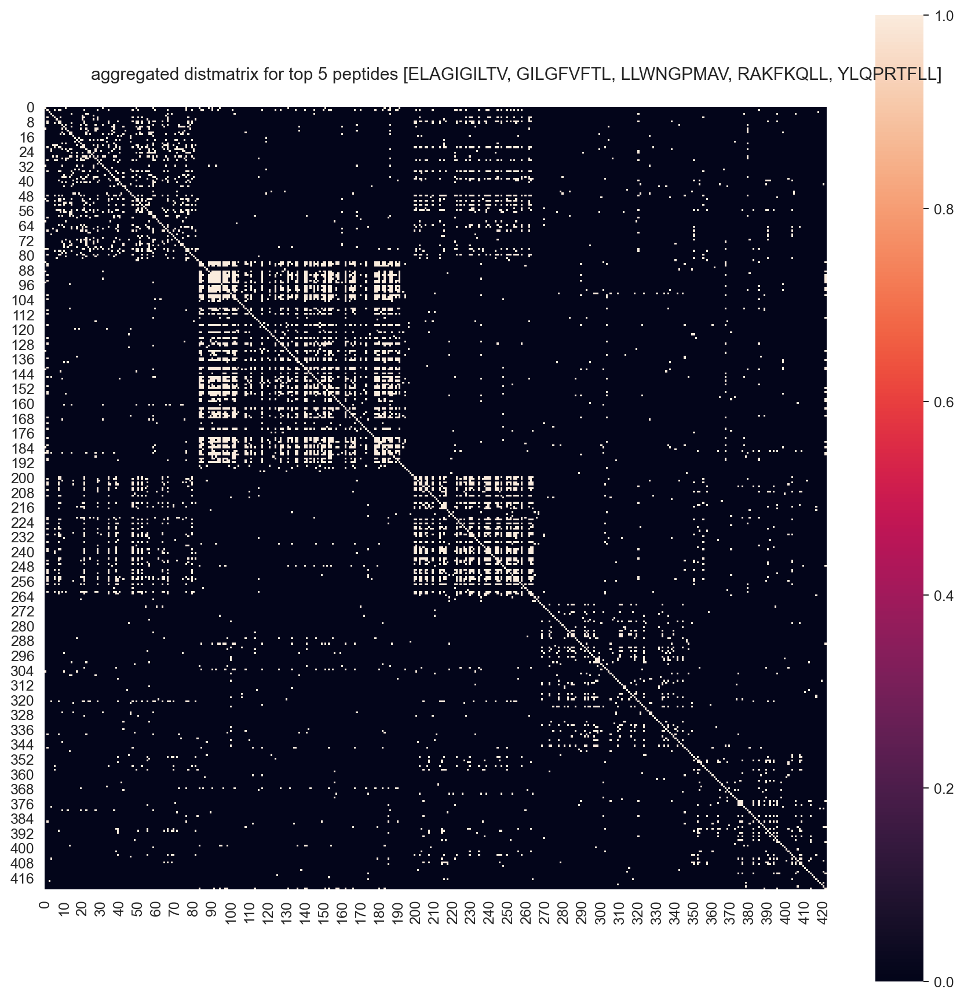

In [19]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_agg2)<0.6, square=True, ax = a)
f.suptitle('aggregated distmatrix for top 5 peptides [ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', y=0.9)
f.tight_layout()

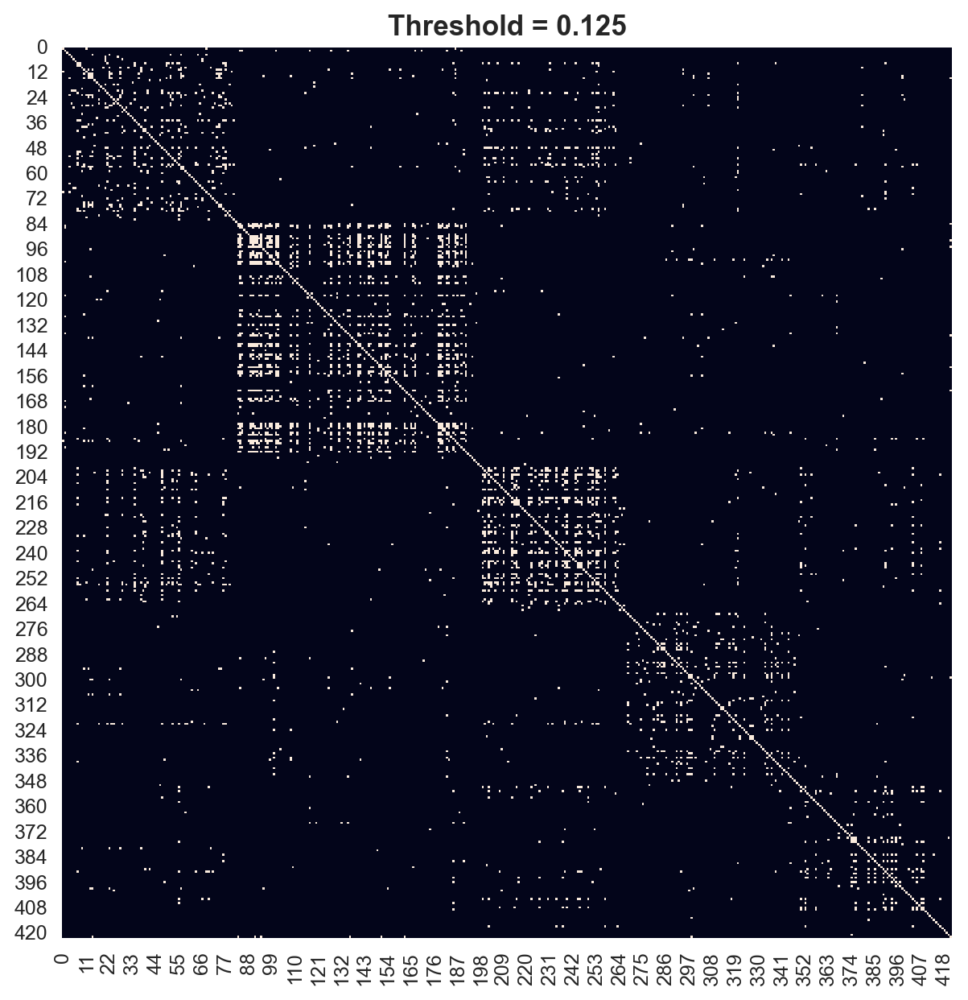

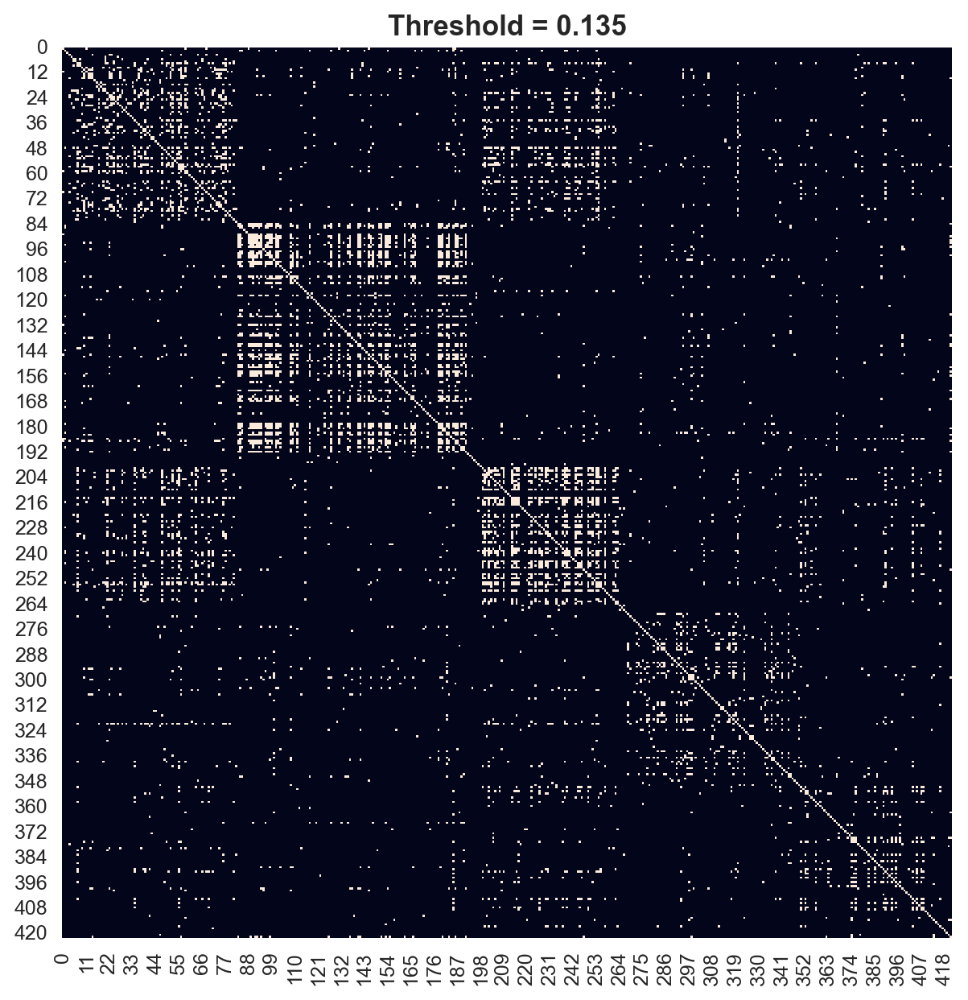

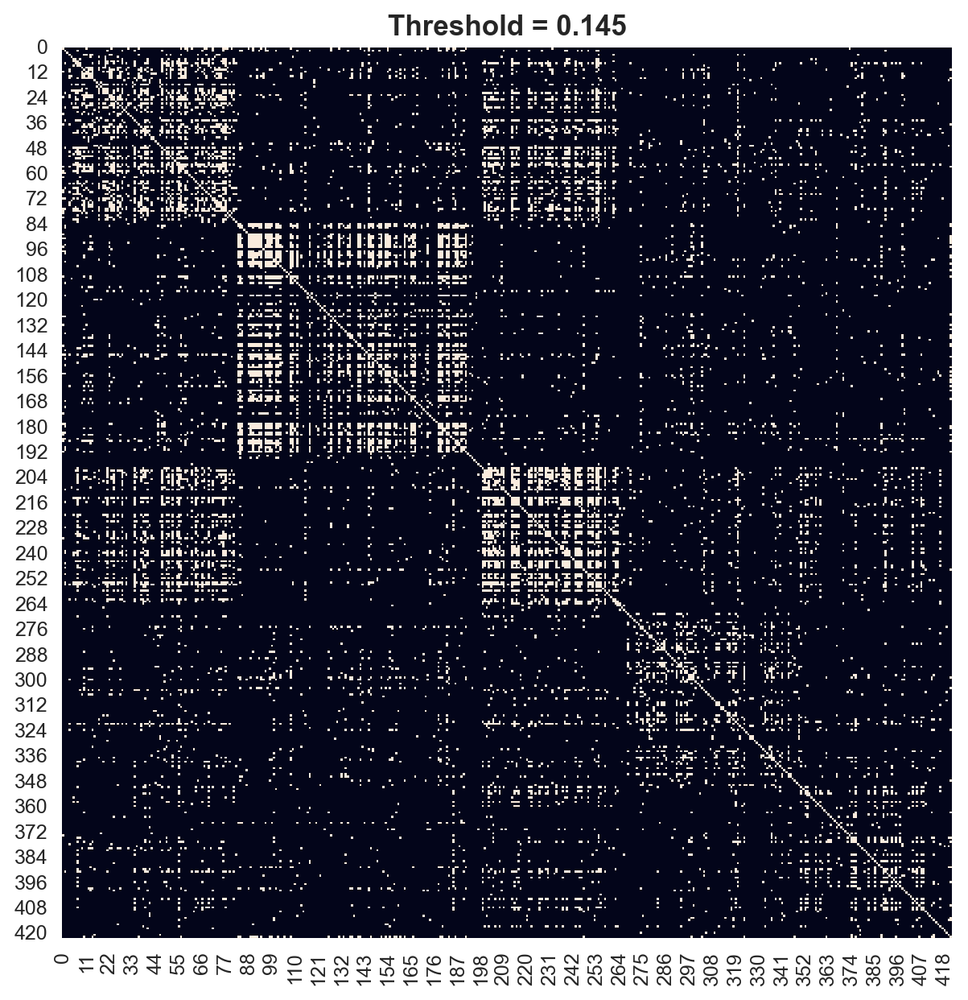

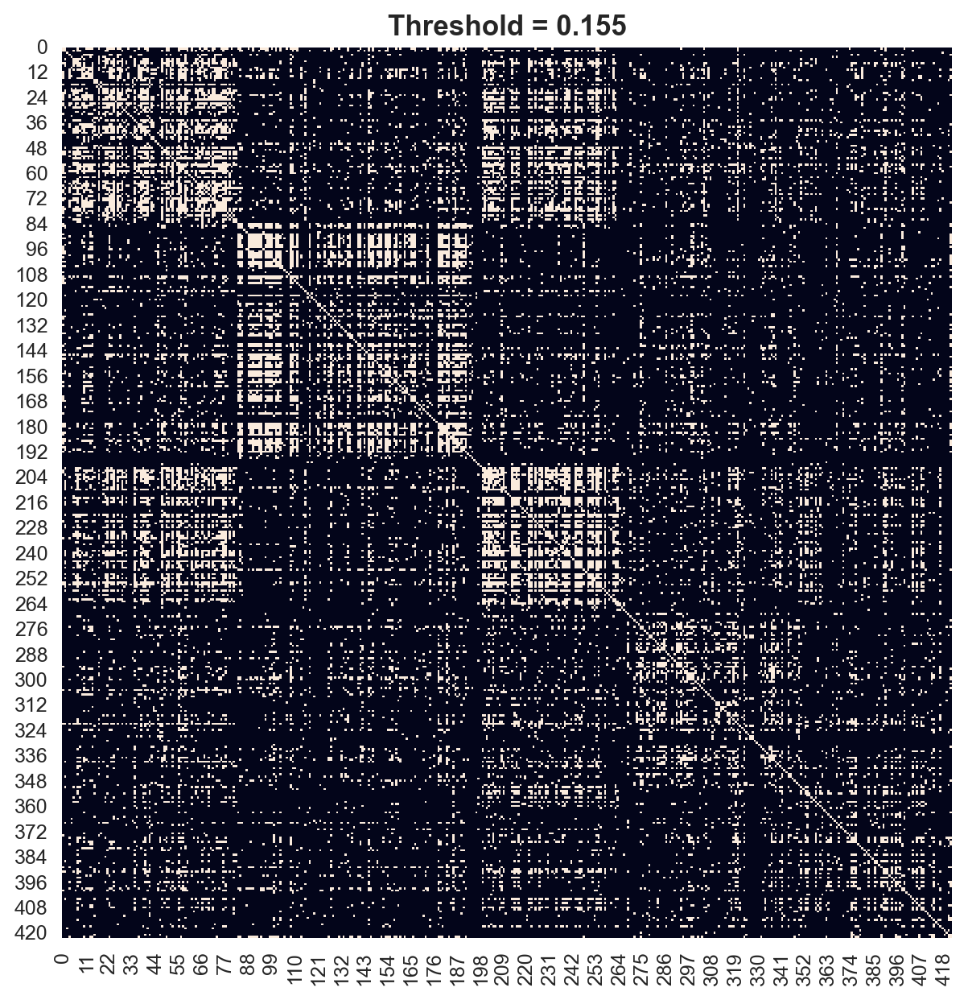

In [20]:
# for t in [0.

for t in [0.125, 0.135, 0.145, 0.155]:
    f,a = plt.subplots(1,1,figsize=(7,7))
    sns.heatmap(da_tbcr<t, square=True, ax = a, cbar=False)
    a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
    # f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
    f.tight_layout()

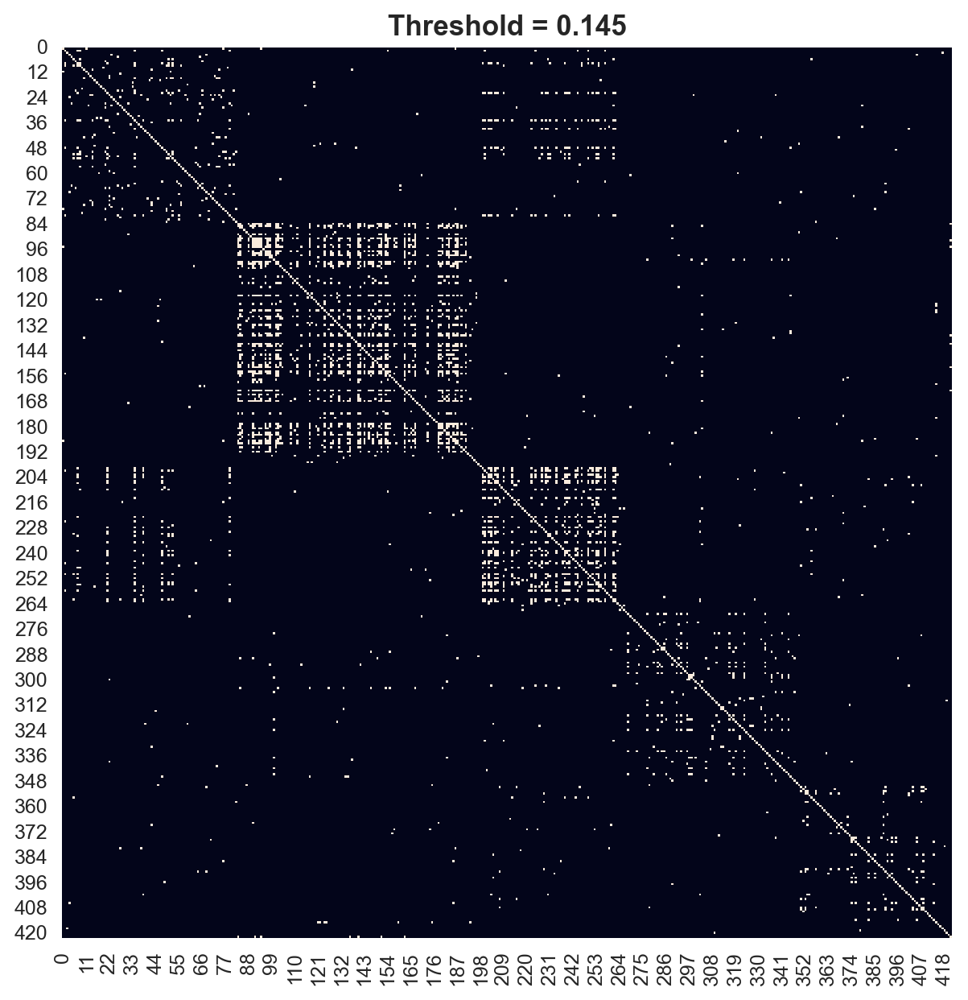

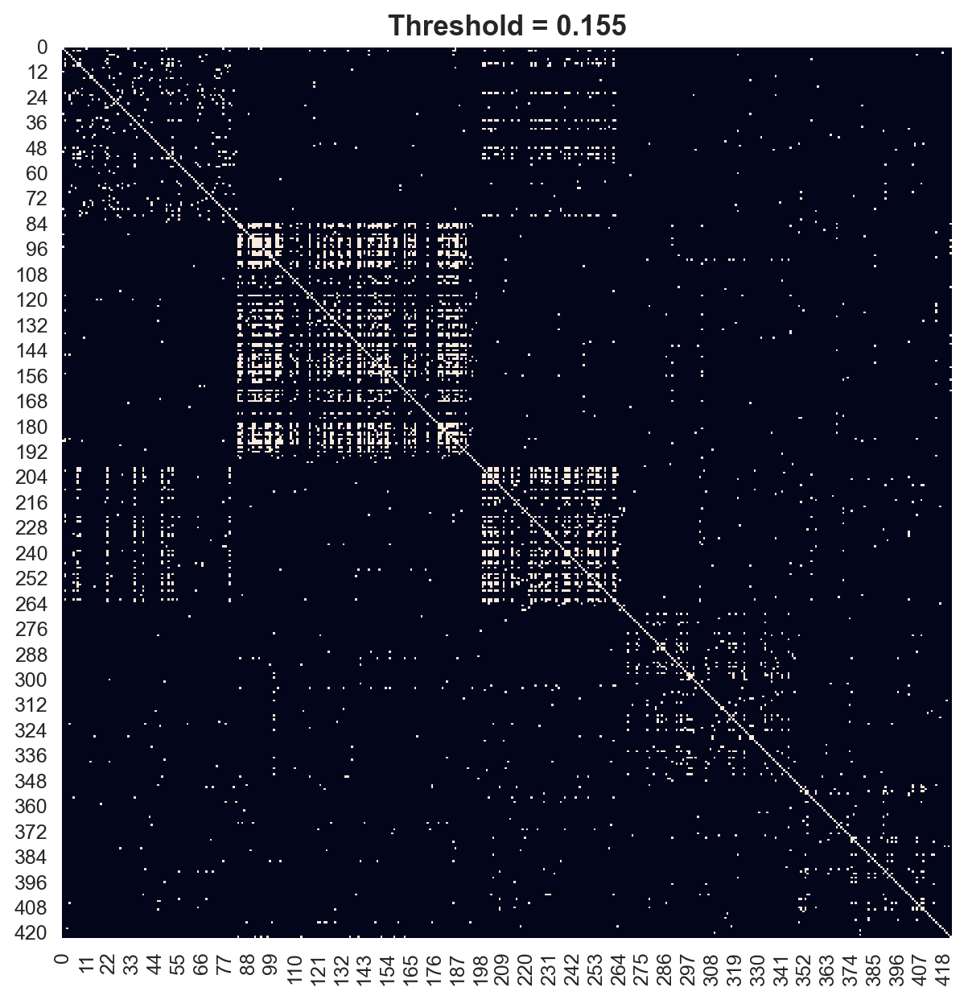

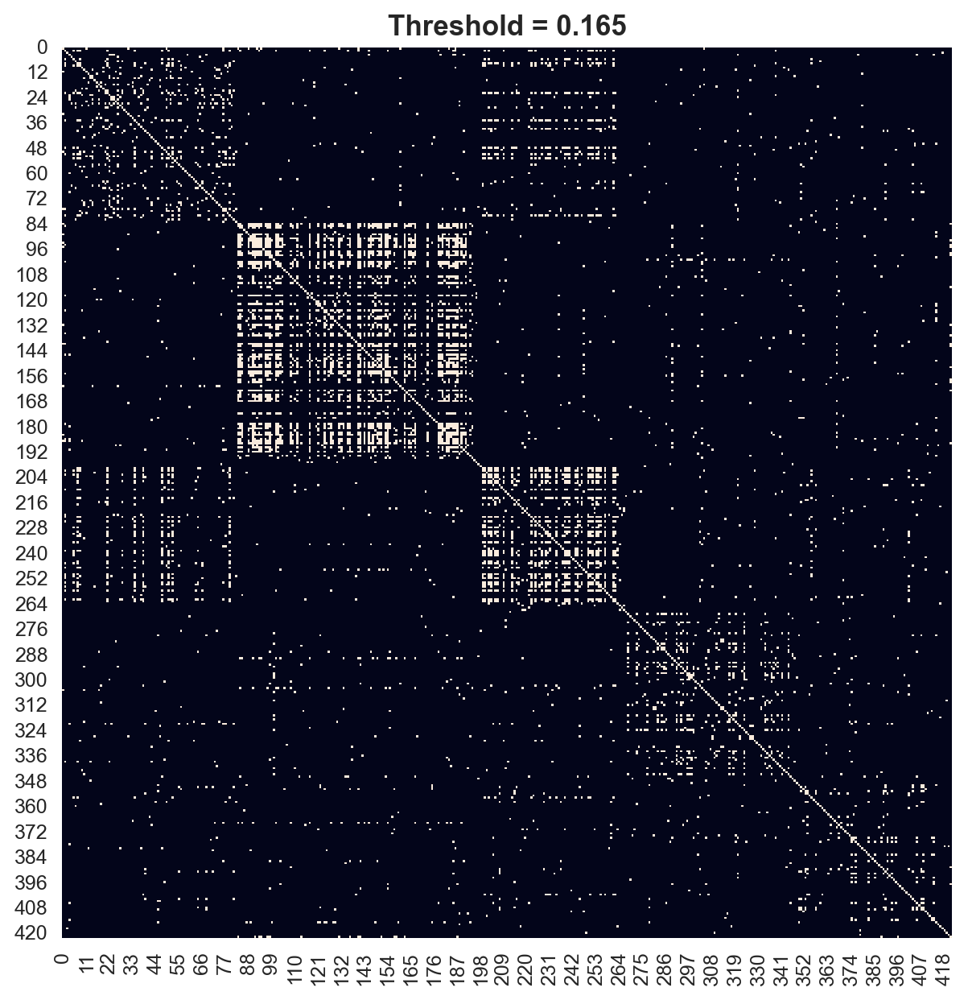

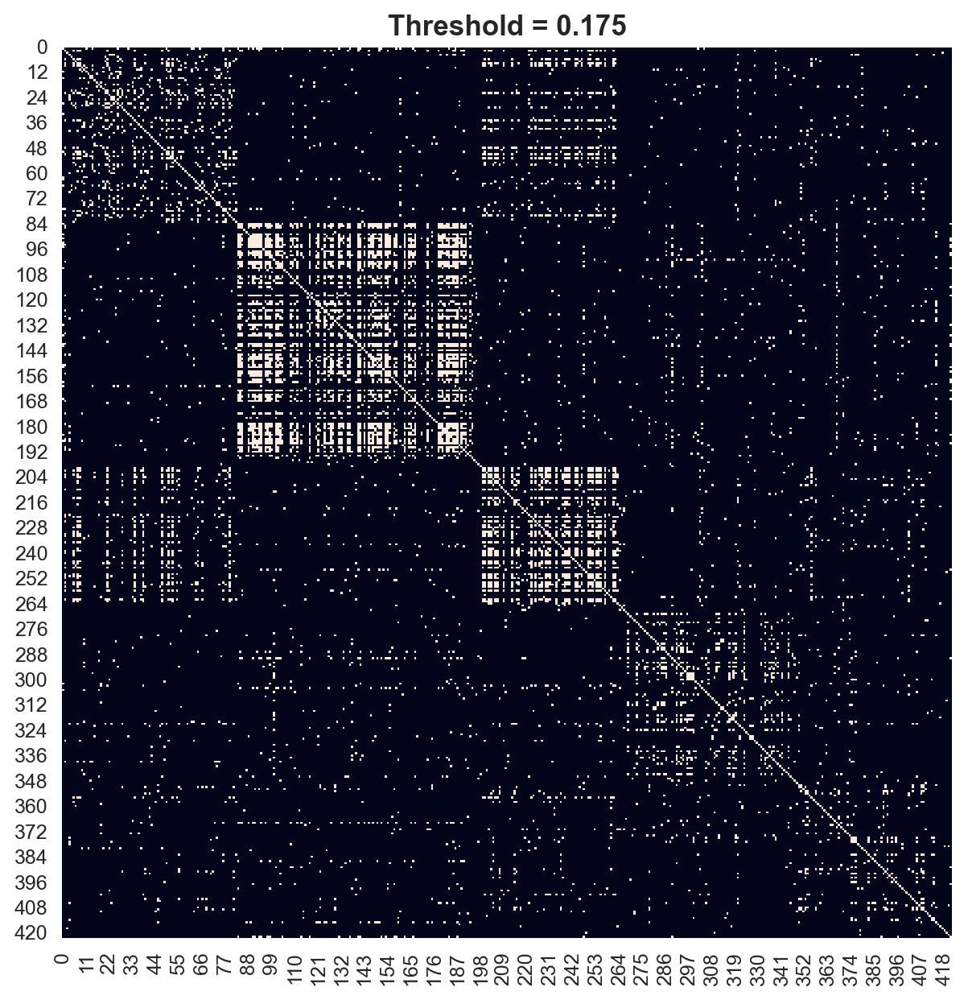

In [21]:
# for t in [0.

for t in [0.145, 0.155, 0.165, 0.175]:
    f,a = plt.subplots(1,1,figsize=(7,7))
    sns.heatmap(da_test<t, square=True, ax = a, cbar=False)
    a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
    # f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
    f.tight_layout()

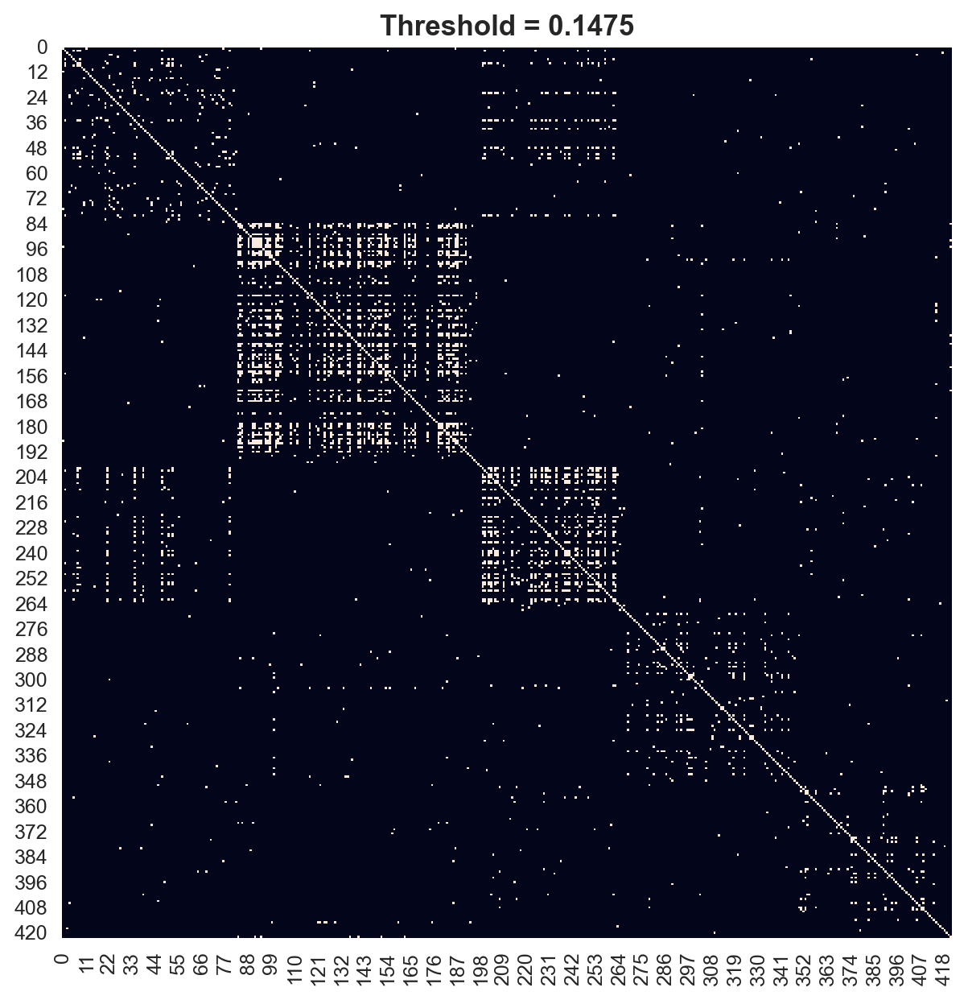

In [22]:
# for t in [0.
t=0.1475
f,a = plt.subplots(1,1,figsize=(7,7))
sns.heatmap(da_test<t, square=True, ax = a, cbar=False)
a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
# f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
f.tight_layout()

### Unsub - heatmap test

In [419]:
# subsample to 4 and subsample a few
subsample = []
for p in tbcr_subset.peptide.unique():
    subsample.append(tbcr_subset.query('peptide==@p').sample(frac=1, random_state=13))
tbcr_nosub = pd.concat(subsample)
tbcr_nosub = tbcr_nosub[[str(x) for x in tbcr_nosub.index]+['binder','partition','raw_index','peptide','original_peptide']]
# Reset index to ordinal to match NetworkX tree just for this example
tbcr_nosub.reset_index(drop=True, inplace=True)
tbcr_nosub.columns = tbcr_nosub.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
tbcr_nosub.groupby('peptide').count()

,0,1,2,3,4,5,6,7,8,9,...,640,641,642,643,644,645,binder,partition,raw_index,original_peptide
peptide,,,,,,,,,,,,,,,,,,,,,
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,...,92,92,92,92,92,92,92,92,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,...,233,233,233,233,233,233,233,233,233,233
LLWNGPMAV,75,75,75,75,75,75,75,75,75,75,...,75,75,75,75,75,75,75,75,75,75
RAKFKQLL,166,166,166,166,166,166,166,166,166,166,...,166,166,166,166,166,166,166,166,166,166
YLQPRTFLL,80,80,80,80,80,80,80,80,80,80,...,80,80,80,80,80,80,80,80,80,80


In [422]:
sorted = tbcr_nosub.sort_values('peptide')
sorted = sorted[list(sorted.index) + ['peptide','raw_index']]
sorted_vals = sorted[list(sorted.index)].values

### some pruning stats things

In [23]:
print('TBCR')
vals = tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.135, 0.16, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

TBCR
***
threshold:0.135		 51 removed edges 
25.49% of the removed edges were same-class
***
***
threshold:0.138		 44 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.141		 35 removed edges 
22.86% of the removed edges were same-class
***
***
threshold:0.143		 31 removed edges 
19.35% of the removed edges were same-class
***
***
threshold:0.146		 25 removed edges 
20.00% of the removed edges were same-class
***
***
threshold:0.149		 22 removed edges 
18.18% of the removed edges were same-class
***
***
threshold:0.152		 17 removed edges 
23.53% of the removed edges were same-class
***
***
threshold:0.154		 16 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.157		 13 removed edges 
23.08% of the removed edges were same-class
***
***
threshold:0.160		 8 removed edges 
25.00% of the removed edges were same-class
***


In [24]:
print('VAE')
vals = da_test # tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.155, 0.18, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

VAE
***
threshold:0.155		 60 removed edges 
38.33% of the removed edges were same-class
***
***
threshold:0.158		 49 removed edges 
38.78% of the removed edges were same-class
***
***
threshold:0.161		 38 removed edges 
42.11% of the removed edges were same-class
***
***
threshold:0.163		 31 removed edges 
41.94% of the removed edges were same-class
***
***
threshold:0.166		 27 removed edges 
48.15% of the removed edges were same-class
***
***
threshold:0.169		 22 removed edges 
40.91% of the removed edges were same-class
***
***
threshold:0.172		 15 removed edges 
46.67% of the removed edges were same-class
***
***
threshold:0.174		 12 removed edges 
41.67% of the removed edges were same-class
***
***
threshold:0.177		 8 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.180		 8 removed edges 
25.00% of the removed edges were same-class
***


In [25]:
print('Aggregated')
vals = da_agg2 # tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.28, 0.32, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

Aggregated
***
threshold:0.280		 57 removed edges 
31.58% of the removed edges were same-class
***
***
threshold:0.284		 49 removed edges 
30.61% of the removed edges were same-class
***
***
threshold:0.289		 42 removed edges 
30.95% of the removed edges were same-class
***
***
threshold:0.293		 33 removed edges 
33.33% of the removed edges were same-class
***
***
threshold:0.298		 28 removed edges 
35.71% of the removed edges were same-class
***
***
threshold:0.302		 19 removed edges 
36.84% of the removed edges were same-class
***
***
threshold:0.307		 15 removed edges 
26.67% of the removed edges were same-class
***
***
threshold:0.311		 12 removed edges 
16.67% of the removed edges were same-class
***
***
threshold:0.316		 9 removed edges 
22.22% of the removed edges were same-class
***
***
threshold:0.320		 7 removed edges 
14.29% of the removed edges were same-class
***


# MST / CC

In [47]:
def prune_by_distance(tree, threshold, prune_node=True, labels=None):
    tree_pruned = tree.copy()
    removed_edges = []
    
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight>=threshold: #assuming weight is a distance and not a similarity
            if labels is not None:
                l1=labels[u]
                l2=labels[v]
                same_label = l1==l2 if labels is not None else np.nan
            removed_edges.append(u,v, round(weight,4), same_label)
            tree_pruned.remove_edge(u,v)
    if prune_node:
        nodes_to_remove = list(nx.isolates(tree_pruned))
        tree_pruned.remove_nodes_from(nodes_to_remove)    
    print(f'***\nbefore pruning : {len(tree.edges())} edges, {len(tree.nodes())} nodes\n***')
    print(f'***\nafter pruning : {len(tree_pruned.edges())} edges, {len(tree_pruned.nodes())} nodes\n***')
    print(len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were actually same-class')
    return tree_pruned, removed_edges

In [19]:
vals = tbcr_test[tbcr_test.index].values
labels = tbcr_test['peptide'].values
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)

print(vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)) 
# Using distances
G = nx.Graph(vals)
for i, node in enumerate(G.nodes()):
    G.nodes[node]['peptide'] = labels[i]
    
tree = nx.minimum_spanning_tree(G)
tree_pruned = tree.copy()
threshold = 0.13
removed_edges = []
for u,v in tree_pruned.edges():
    weight = tree_pruned.get_edge_data(u,v)['weight']
    if weight >=threshold:
        label1=tbcr_test.iloc[u]['peptide']
        label2=tbcr_test.iloc[v]['peptide']
        removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
        tree_pruned.remove_edge(u,v)

nodes_to_remove=list(nx.isolates(tree_pruned))
tree_pruned.remove_nodes_from(nodes_to_remove)
print(f'***\nbefore pruning : {len(tree.edges())} edges, {len(tree.nodes())} nodes\n***')
print(f'***\nafter pruning : {len(tree_pruned.edges())} edges, {len(tree_pruned.nodes())} nodes\n***')
print(len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were actually same-class')
print('***\n')
print(removed_edges)
print(tree_pruned.edges())
color_map = {k:v for k,v in zip(sorted(np.unique(labels)), sns.color_palette('tab10', len(np.unique(labels))))}


0.0355119166666666 0.2906513333333334 0.027530748383427613 0.1814250393793565 0.18264616666666655
***
before pruning : 421 edges, 422 nodes
***
***
after pruning : 347 edges, 352 nodes
***
74 removed edges 
27.03% of the removed edges were actually same-class
***

[(0, 373, 0.1381, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (2, 417, 0.1493, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (20, 123, 0.1512, 0, 'ELAGIGILTV', 'GILGFVFTL'), (25, 187, 0.1513, 0, 'ELAGIGILTV', 'GILGFVFTL'), (34, 142, 0.1302, 0, 'ELAGIGILTV', 'GILGFVFTL'), (43, 243, 0.1321, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (43, 314, 0.1332, 0, 'ELAGIGILTV', 'RAKFKQLL'), (47, 212, 0.1434, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (48, 177, 0.1392, 0, 'ELAGIGILTV', 'GILGFVFTL'), (52, 335, 0.1307, 0, 'ELAGIGILTV', 'RAKFKQLL'), (53, 189, 0.1452, 0, 'ELAGIGILTV', 'GILGFVFTL'), (60, 207, 0.1305, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (71, 417, 0.1341, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (73, 176, 0.139, 0, 'ELAGIGILTV', 'GILGFVFTL'), (86, 398, 0.1586, 0, 'GILGFVFTL', 'YLQPRTFLL'), (100,

In [69]:
tbcr_test.to_csv('../output/240606_nettcr_distance_matrix_5peptides_tbcralign.txt')

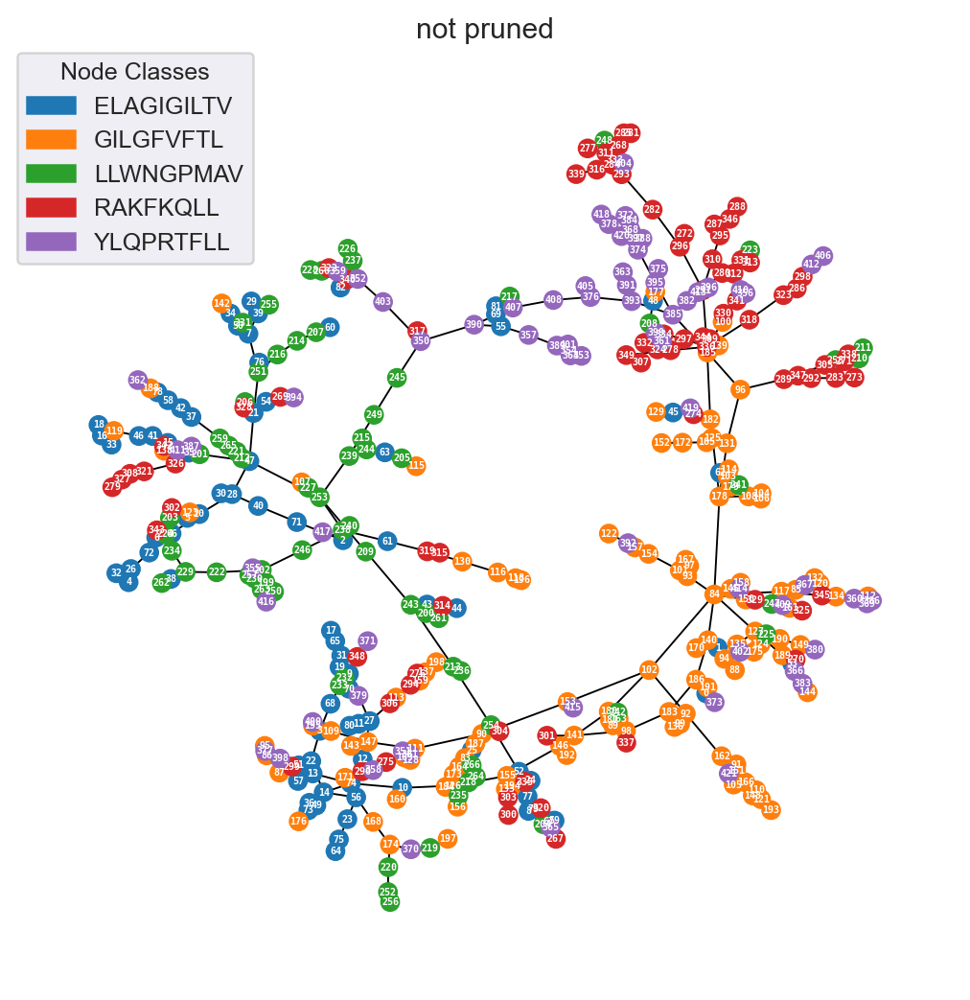

In [28]:
# unpruned tree plot
from matplotlib.patches import Patch

sns.set_style('darkgrid')
# Visualize the graph and the minimum spanning tree
f,a = plt.subplots(1,1, figsize=(7,7))
pos = nx.spring_layout(tree, iterations=300, k=0.1, threshold=1e-5, seed=13)
node_colors = [color_map[tree.nodes[node]['peptide']] for node in tree.nodes()]
nx.draw_networkx_nodes(tree, pos, node_color=node_colors, node_size=52.5, ax=a) # nx.draw_networkx_edges(G, pos, edge_color="grey")
nx.draw_networkx_labels(tree, pos, font_size=4, font_color='w', font_weight='semibold', font_family="monospace")
# nx.draw_networkx_edge_labels(
#     G, pos, edge_labels={(u, v): round(d["weight"],3) for u, v, d in tree.edges(data=True)}
# )
nx.draw_networkx_edges(tree, pos, edge_color="k", width=0.75)
# Create a legend
legend_labels = {k: color_map[k] for k in sorted(color_map.keys())}  # Sorted keys for consistent order
patches = [Patch(color=color, label=f'{label}') for label, color in legend_labels.items()]
plt.legend(handles=patches, title='Node Classes', loc='best', borderaxespad=0.)
a.set_title('not pruned')
plt.axis("off")
plt.show()

In [ ]:
# TAKE MATRIX
# TAKE THRESHOLD
# BINARIZE IT
# USE BINARY MATRIX TO DO MST AND/OR CLUSTERING

In [29]:
tree_pruned.nodes[210], tree_pruned.nodes[271], tree_pruned.get_edge_data(210,271)

({'peptide': 'LLWNGPMAV'},
 {'peptide': 'RAKFKQLL'},
 {'weight': 0.1271555833333333})

In [30]:
tree_pruned.adj[0]

AtlasView({186: {'weight': 0.1195195}})

In [31]:
nx.to_numpy_array(tree_pruned)[0][186]

0.0

In [32]:
nx.to_dict_of_dicts(tree_pruned)

{0: {186: {'weight': 0.1195195}},
 1: {170: {'weight': 0.0990049166666667}, 135: {'weight': 0.1024045833333332}},
 3: {22: {'weight': 0.10088225}, 68: {'weight': 0.1138086666666665}},
 4: {26: {'weight': 0.1191764166666665}},
 5: {20: {'weight': 0.1047018333333333}},
 6: {66: {'weight': 0.1142158333333333}},
 7: {34: {'weight': 0.0610680833333333},
  251: {'weight': 0.0692939166666666},
  39: {'weight': 0.0908059166666666},
  50: {'weight': 0.09401025},
  231: {'weight': 0.1087683333333333}},
 8: {77: {'weight': 0.1129132499999999}},
 9: {19: {'weight': 0.1021757499999999},
  31: {'weight': 0.1025390833333332},
  379: {'weight': 0.1064949166666666}},
 10: {74: {'weight': 0.0905360833333333},
  126: {'weight': 0.10167025},
  160: {'weight': 0.1027916666666666}},
 11: {27: {'weight': 0.1094702500000001}, 80: {'weight': 0.1112656666666667}},
 12: {27: {'weight': 0.0949009166666666}, 56: {'weight': 0.0969857499999999}},
 13: {57: {'weight': 0.0952100833333333},
  398: {'weight': 0.0989755}

In [33]:
tree_pruned.adj[90], tree_pruned.adj[282], tree_pruned.adj[178]

(AtlasView({83: {'weight': 0.0786348333333334}, 153: {'weight': 0.0524728333333333}, 111: {'weight': 0.0773280833333333}, 187: {'weight': 0.08814525}}),
 AtlasView({293: {'weight': 0.0697329999999999}, 296: {'weight': 0.0794400833333334}}),
 AtlasView({84: {'weight': 0.0730207499999999}, 108: {'weight': 0.0673723333333332}, 131: {'weight': 0.0849363333333332}, 182: {'weight': 0.0752589166666667}, 179: {'weight': 0.0798478333333333}}))

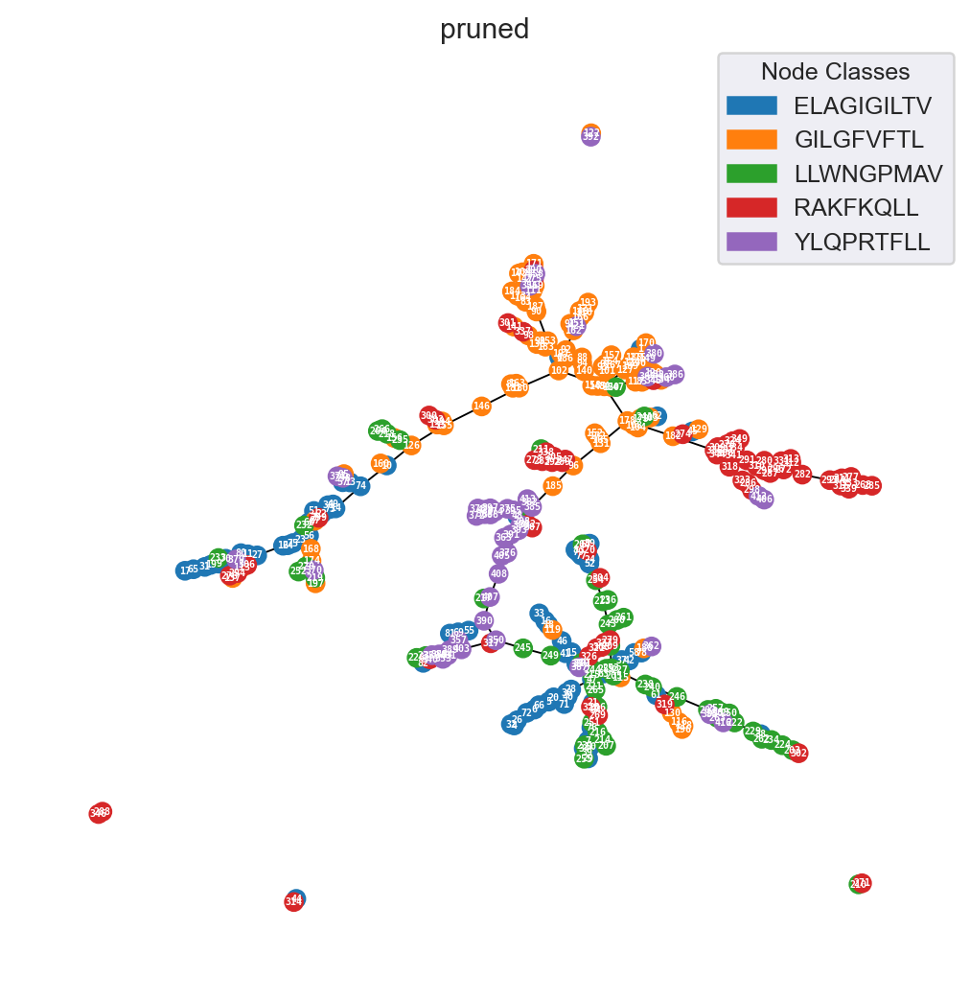

In [34]:
sns.set_style('darkgrid')
# Visualize the graph and the minimum spanning tree
f,a = plt.subplots(1,1, figsize=(7,7))
pos = nx.spring_layout(tree_pruned, iterations=300, threshold=1e-5, seed=1, scale=0.9,  k=0.05, dim=2)
node_colors = [color_map[tree_pruned.nodes[node]['peptide']] for node in tree_pruned.nodes()]
nx.draw_networkx_nodes(tree_pruned, pos, node_color=node_colors, node_size=52.5, ax=a) # nx.draw_networkx_edges(G, pos, edge_color="grey")
nx.draw_networkx_labels(tree_pruned, pos, font_size=4, font_color='w', font_weight='semibold', font_family="monospace")
# nx.draw_networkx_edge_labels(
#     G, pos, edge_labels={(u, v): round(d["weight"],3) for u, v, d in tree.edges(data=True)}
# )
nx.draw_networkx_edges(tree_pruned, pos, edge_color="k", width=0.75)
# Create a legend
legend_labels = {k: color_map[k] for k in sorted(color_map.keys())}  # Sorted keys for consistent order
patches = [Patch(color=color, label=f'{label}') for label, color in legend_labels.items()]
plt.legend(handles=patches, title='Node Classes', loc='best', borderaxespad=0.)
# Find bottleneck score ; with centrality AND connectivity
a.set_title('pruned')
plt.axis("off")
plt.show()

In [145]:
list(tree_pruned.neighbors(182))

[178, 336, 274]

In [35]:
tree_pruned.get_edge_data(182, 274)

{'weight': 0.1107602499999999}

In [36]:
tree_pruned.nodes(data=True)[274]

{'peptide': 'RAKFKQLL'}

In [37]:
tree_pruned.nodes()

NodeView((0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 108, 109, 110, 111, 113, 115, 116, 117, 118, 119, 120, 121, 122, 124, 126, 127, 129, 130, 131, 132, 133, 134, 135, 136, 137, 140, 141, 143, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 160, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 193, 194, 196, 197, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 224, 226, 227, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 243, 244, 245, 246, 247, 249

In [38]:
tree_pruned.get_edge_data(182, 336)

{'weight': 0.0833748333333334}

In [39]:
tree.get_edge_data(282,90)

In [41]:
tbcr_test.iloc[[90,153,282, 187]][[90,153,282, 187]+['peptide']]

,90,153,282,187,peptide
204,0.175198,0.111022,0.127209,0.194819,GILGFVFTL
225,0.173516,0.088448,0.133791,0.189114,GILGFVFTL
55,0.165549,0.170877,0.150695,0.211899,RAKFKQLL
154,0.170663,0.119691,0.170517,0.181886,GILGFVFTL


# 5 peps clustering plot retpur curves

In [25]:
dm_tcrdist = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0)

In [35]:
dm_tcrdist = dm_tcrdist.query('raw_index in @tbcr_test.raw_index.unique()')
dm_tcrdist = dm_tcrdist[[str(x) for x in dm_tcrdist.index]+list(dm_tcrdist.columns[-5:])]

In [48]:
tbcr_da = tbcr_test.iloc[:, :len(tbcr_test)].values
tbcr_labels = tbcr_test['peptide'].values
tbcr_enc = LabelEncoder()
tbcr_encoded_labels = tbcr_enc.fit_transform(tbcr_labels)

vae_da = dm_test.iloc[:, :len(dm_test)].values
vae_labels = dm_test['peptide'].values
vae_enc = LabelEncoder()
vae_encoded_labels = vae_enc.fit_transform(vae_labels)

In [36]:
tcrdist_da = dm_tcrdist.iloc[:, :len(dm_tcrdist)].values
tcrdist_labels = dm_tcrdist['peptide'].values
tcrdist_enc = LabelEncoder()
tcrdist_encoded_labels = tcrdist_enc.fit_transform(tcrdist_labels)
tcrdist_cluster = cluster_all_thresholds(tcrdist_da, torch.rand([len(tcrdist_da), 1]), tcrdist_labels, tcrdist_encoded_labels, tcrdist_enc, n_jobs=8)


HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:06<00:00, 73.32it/s]


In [37]:
tbcr_cluster = cluster_all_thresholds(tbcr_da, torch.rand([len(tbcr_da), 1]), tbcr_labels, tbcr_encoded_labels, tbcr_enc, n_jobs=8)
vae_cluster = cluster_all_thresholds(vae_da, torch.rand([len(vae_da), 1]), vae_labels, vae_encoded_labels, vae_enc, n_jobs=8)

HERE


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:03<00:00, 132.30it/s]


HERE


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 122.45it/s]


In [49]:

# Here, do a run ith only the best
def plot_pipeline(results, b, plot_title='None', fig_fn=None, filter=None, palette=None, more=False,
                  add_cluster_size=False):
    runs = pd.concat([b, results])
    # plotting options
    if filter is None:
        filter = ['TBCRalign', 'KernelSim', 'tcrdist3'] + list(results.input_type.unique())

    if palette is None:
        palette = 'gnuplot2'
    if more:
        palette = get_palette(palette, n_colors=len(filter) - 3)
    else:
        palette = sns.color_palette(palette, n_colors=len(filter) - 3)

    sns.set_palette(palette)
    f, a = plt.subplots(1, 1, figsize=(9, 9))
    a.set_xlim([0, 1])
    a.set_ylim([0, 1])
    a.set_xlabel('Retention', fontweight='semibold', fontsize=14)
    a.set_ylabel('Avg Purity', fontweight='semibold', fontsize=14)
    # Setting major ticks
    major_ticks = np.arange(0, 1.1, 0.1)
    a.set_xticks(major_ticks)
    a.set_yticks(major_ticks)
    # Setting minor ticks
    minor_ticks = np.arange(0, 1.1, 0.05)
    a.set_xticks(minor_ticks, minor=True)
    a.set_yticks(minor_ticks, minor=True)
    plt.grid(which='both', linestyle='--', linewidth=0.5)
    print(runs.duplicated().any())
    if add_cluster_size:
        ax2 = a.twinx()  # instantiate a second axes that shares the same x-axis
        ax2.set_yscale('log', base=2)

    for i, input_type in enumerate(filter):
        query = runs.query('input_type==@input_type')
        retentions = query['retention'].values[1:-1]
        purities = query['mean_purity'].values[1:-1]
        print(input_type, '\t', round(get_retpur_auc(retentions, purities), 4))
        ls = '-' if i % 2 == 0 else '--'
        if add_cluster_size:
            cluster_sizes = query['mean_cluster_size'].values[1:-1]
        # Plotting baselines with fixed styles colors etc
        if input_type == "TBCRalign":
            a.plot(retentions, purities, label='TBCRalign', ls=':', c='k', lw=1.)
            if add_cluster_size:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='x', lw=0.5, s=8, c='k')
        elif input_type == "KernelSim":
            a.plot(retentions, purities, label='KernelSim', ls=':', c='m', lw=1.)
            if add_cluster_size:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='v', lw=0.1, s=8, c='m')
        elif input_type == "tcrdist3":
            a.plot(retentions, purities, label='tcrdist3', ls=':', c='y', lw=1.)
            if add_cluster_size:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='*', lw=0.1, s=8, c='y')
        # Plotting the actual things
        else:
            a.plot(retentions, purities, label=input_type.lstrip('_').replace('_', ' ').replace('checkpoint best', ''),
                   ls=ls, lw=1.)
            if add_cluster_size:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='+', lw=1.15, s=12)

    a.axhline(0.6, label='60% purity cut-off', ls=':', lw=.75, c='m')
    a.axhline(0.7, label='70% purity cut-off', ls=':', lw=.75, c='c')
    a.axhline(0.8, label='80% purity cut-off', ls=':', lw=.75, c='y')

    a.legend(title='distance matrix', title_fontproperties={'size': 14, 'weight': 'semibold'},
             prop={'weight': 'semibold', 'size': 12})

    f.suptitle(f'{plot_title}', fontweight='semibold', fontsize=15)
    f.tight_layout()
    if fig_fn is not None:
        f.savefig(f'../output/240411_ClusteringTests/{fig_fn}.png', dpi=200)
    return runs



In [50]:
def plot_pipeline_here(runs, title=None, fn=None, palette='gnuplot2', add_clustersize=False):
    # plotting options
    sns.set_palette(palette, n_colors=len(runs.input_type.unique()))
    f, a = plt.subplots(1, 1, figsize=(9, 9))
    a.set_xlim([0, 1])
    a.set_ylim([0, 1])
    a.set_xlabel('Retention', fontweight='semibold', fontsize=14)
    a.set_ylabel('Avg Purity', fontweight='semibold', fontsize=14)
    # Setting major ticks
    major_ticks = np.arange(0, 1.1, 0.1)
    a.set_xticks(major_ticks)
    a.set_yticks(major_ticks)
    # Setting minor ticks
    minor_ticks = np.arange(0, 1.1, 0.05)
    a.set_xticks(minor_ticks, minor=True)
    a.set_yticks(minor_ticks, minor=True)
    plt.grid(which='both', linestyle='--', linewidth=0.5)
    if add_cluster_size:
        ax2 = a.twinx()  # instantiate a second axes that shares the same x-axis
        ax2.set_yscale('log', base=2)
        
    for input_type in runs.input_type.unique():
        query = runs.query('input_type==@input_type')
        retentions = query['retention'][1:-1].values
        purities = query['mean_purity'][1:-1].values
        if add_clustersize:
            cluster_sizes = query['mean_cluster_size'].values[1:-1]
            
        if input_type == "TBCRalign":
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls=':', c='g', lw=1)
            ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='x', lw=0.5, s=8, c='k')

        elif input_type == "tcrdist3":
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls=':', c='m', lw=1)
            ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='x', lw=0.5, s=8, c='k')

        else:
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls='--', lw=1.1)
            ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='x', lw=0.5, s=8, c='k')


    a.axhline(0.6, label='60% purity cut-off', ls=':', lw=.75, c='m')
    a.axhline(0.7, label='70% purity cut-off', ls=':', lw=.75, c='c')
    a.axhline(0.8, label='80% purity cut-off', ls=':', lw=.75, c='y')

    a.legend(title='distance matrix', title_fontproperties={'size': 14, 'weight': 'semibold'},
             prop={'weight': 'semibold', 'size': 12}, loc='lower left')
    f.suptitle(f'{title}', fontweight='semibold', fontsize=15)
    f.tight_layout()
    if fn is not None:
        f.savefig(f'{fn}.png', dpi=200)

(<Figure size 1620x1620 with 1 Axes>,
 <Axes: xlabel='Retention', ylabel='Mean Purity'>)

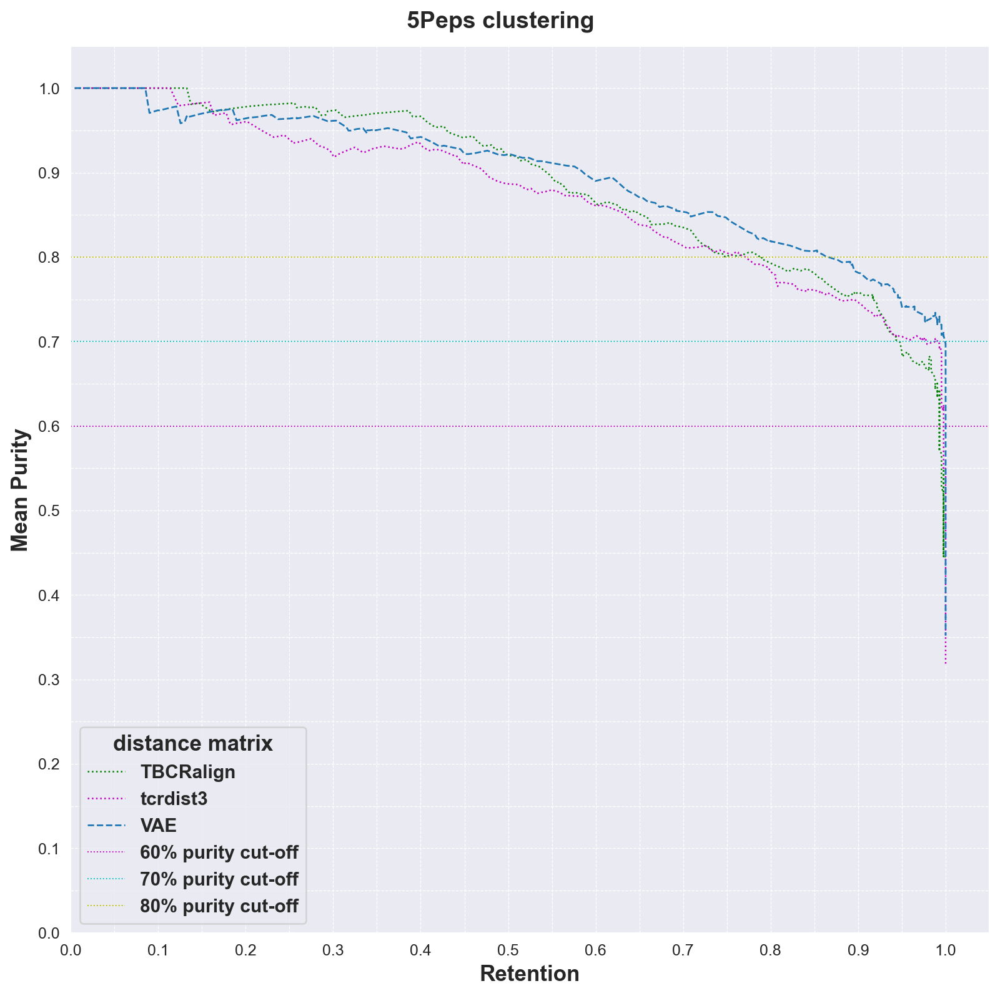

In [51]:
from src.cluster_utils import plot_retention_purities
plot_retention_purities(pd.concat([tbcr_cluster.assign(input_type='TBCRalign'), tcrdist_cluster.assign(input_type='tcrdist3'),
                             vae_cluster.assign(input_type='vae'.upper())]), title='5Peps clustering')

# Bottleneck problem

In [43]:
def prune_by_distance(tree, threshold, prune_node=True, labels=None, verbose=False):
    tree_pruned = tree.copy()
    removed_edges = []
    
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight>=threshold: #assuming weight is a distance and not a similarity
            if labels is not None:
                l1=labels[u]
                l2=labels[v]
                same_label = l1==l2 if labels is not None else np.nan
            removed_edges.append((u,v, round(weight,4), same_label))
            tree_pruned.remove_edge(u,v)
    if prune_node:
        nodes_to_remove = list(nx.isolates(tree_pruned))
        tree_pruned.remove_nodes_from(nodes_to_remove)    
    if verbose:
        print(f'***\nbefore pruning : {len(tree.edges())} edges, {len(tree.nodes())} nodes\n***')
        print(f'***\nafter pruning : {len(tree_pruned.edges())} edges, {len(tree_pruned.nodes())} nodes\n***')
        print(len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were actually same-class')
    return tree_pruned, removed_edges


def draw_mst_spring(tree, color_map, title=None, iterations=300, threshold=1e-5, scale=0.9, k=0.05, dim=2, seed=13):
    sns.set_style('darkgrid')
    # Visualize the graph and the minimum spanning tree
    f,a = plt.subplots(1,1, figsize=(8,8))
    pos = nx.spring_layout(tree, iterations=iterations, threshold=threshold, seed=seed, scale=scale,  k=k, dim=dim)
    node_colors = [color_map[tree.nodes[node]['peptide']] for node in tree.nodes()]
    nx.draw_networkx_nodes(tree, pos, node_color=node_colors, node_size=52.5, ax=a) # nx.draw_networkx_edges(G, pos, edge_color="grey")
    nx.draw_networkx_labels(tree, pos, font_size=4, font_color='w', font_weight='semibold', font_family="monospace")
    nx.draw_networkx_edges(tree, pos, edge_color="k", width=0.75)
    # Create a legend
    legend_labels = {k: color_map[k] for k in sorted(color_map.keys())}  # Sorted keys for consistent order
    patches = [Patch(color=color, label=f'{label}') for label, color in legend_labels.items()]
    plt.legend(handles=patches, title='Node Classes', loc='best', borderaxespad=0.)
    # Find bottleneck score ; with centrality AND connectivity
    if title is not None:
        a.set_title(title)
    plt.axis("off")
    plt.show()

In [48]:
dm_test.columns[-6:]

Index([321, 298, 'binder', 'partition', 'raw_index', 'peptide'], dtype='object')

In [49]:
vals = dm_test[dm_test.index].values
labels = dm_test['peptide'].values
raw_index = dm_test['raw_index'].values
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)
print('Values stats')
print(vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)) 
print('\n')
# Using distances
G = nx.Graph(vals)
for i, node in enumerate(G.nodes()):
    G.nodes[node]['peptide'] = labels[i]
    # Used to recover the datapoints from the distance matrix
    G.nodes[node]['raw_index'] = raw_index[i]

# First find a threshold to do the initial pruning by distance
res = []
tree = nx.minimum_spanning_tree(G)
for t in np.linspace(0.140, 0.155, 100):
    tree_pruned, removed_edges = prune_by_distance(tree, t, prune_node=True, labels = labels, verbose=False)
    z = np.mean([int(x[-1]) for x in removed_edges])
    # print(f'Threshold:\t{t:.5f}\terror:\t{z:.2%}\tN={len(removed_edges)}')
    res.append({'threshold':t, 'error':z, 'n_removed':len(removed_edges)})
    # print(f'Removed edges: \n', removed_edges, '\n\n')
    # print(f'Remaining edges: \n', tree_pruned.edges(), '\n\n')
errors = pd.DataFrame(res).drop_duplicates(subset=['error','n_removed']).sort_values('error')
display(errors.head())
color_map = {k:v for k,v in zip(sorted(np.unique(labels)), sns.color_palette('tab10', len(np.unique(labels))))}

Values stats
0.019308388 0.40348476 0.04150142 0.24371497 0.2476097




,threshold,error,n_removed
72,0.150909,0.364865,74
67,0.150152,0.367089,79
85,0.152879,0.367647,68
76,0.151515,0.369863,73
82,0.152424,0.371429,70


***
before pruning : 421 edges, 422 nodes
***
***
after pruning : 347 edges, 356 nodes
***
74 removed edges 
36.49% of the removed edges were actually same-class


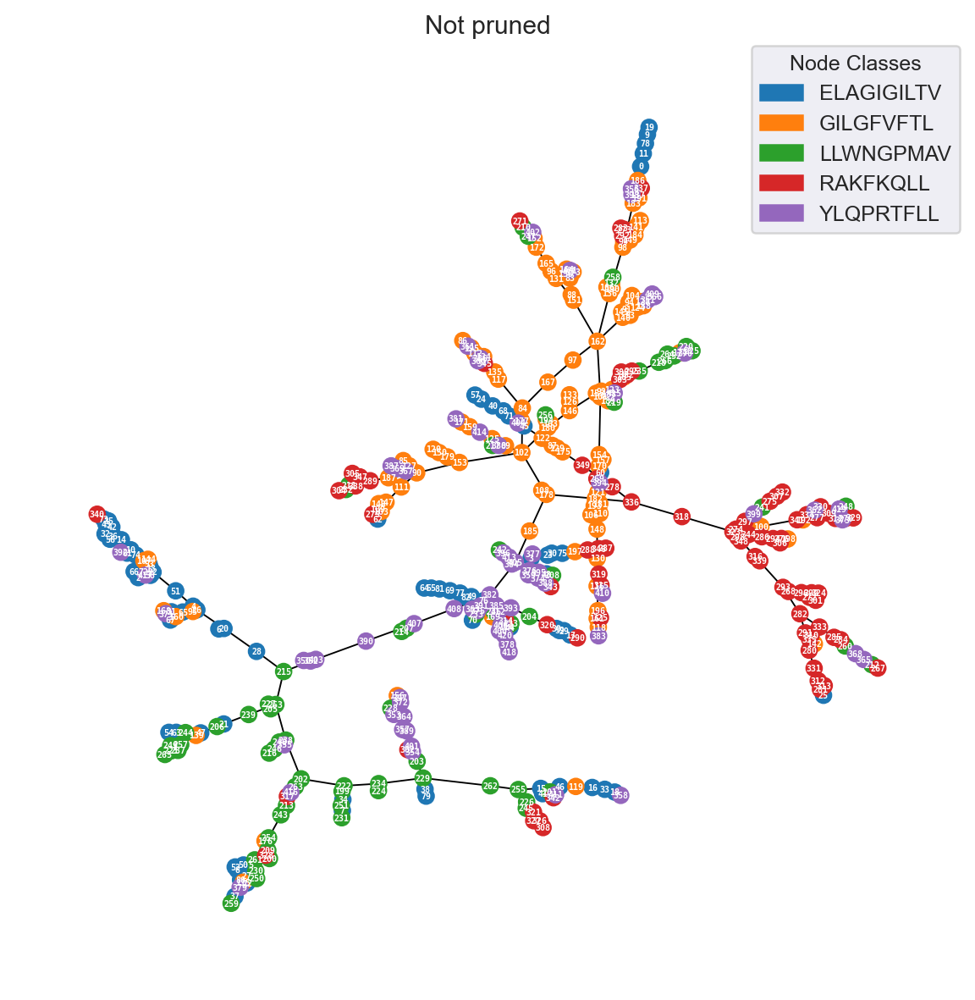

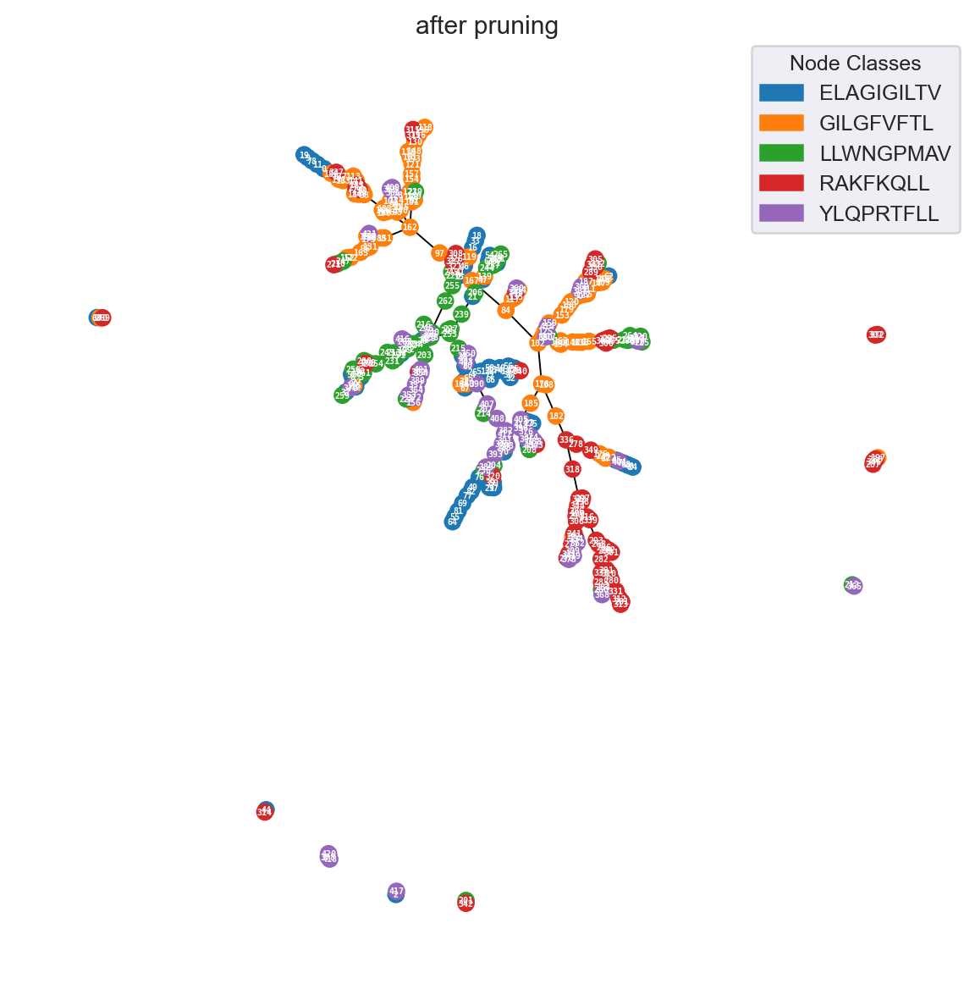

In [51]:
# Do a pruning and check the plot
t = 0.150783
tree_pruned, removed_edges = prune_by_distance(tree, t, prune_node=True, labels = labels, verbose=True)
draw_mst_spring(tree, color_map, title='Not pruned', iterations=400, threshold=1e-4, scale=0.9, k=0.05, seed=1)
draw_mst_spring(tree_pruned, color_map, title='after pruning', iterations=400, threshold=1e-4, scale=.9, k=0.05, seed=1)

In [52]:
tree_pruned.nodes(data=True)[0]

{'peptide': 'ELAGIGILTV', 'raw_index': '10x'}

In [53]:
len(list(nx.connected_components(tree_pruned))), [len(x) for x in nx.connected_components(tree_pruned)]

(9, [336, 2, 2, 3, 4, 2, 2, 2, 3])

In [54]:
components = list(nx.connected_components(tree_pruned))
len(components)>1

True

In [55]:
from pprint import pprint

nodes_bc = sorted(nx.betweenness_centrality(tree_pruned).items(), key=lambda item: item[1], reverse=True)
edges_bc = sorted(nx.edge_betweenness_centrality(tree_pruned).items(), key=lambda item: item[1], reverse=True)

print('Top15 node centrality\n')
pprint(nodes_bc[:15])

print('Top15 edge centrality\n')
pprint(edges_bc[:15])

Top15 node centrality

[(178, 0.5542929895758733),
 (102, 0.4845866157396355),
 (382, 0.47900055701440275),
 (405, 0.47074082915572524),
 (185, 0.44360627039070577),
 (215, 0.42409485159544835),
 (407, 0.406238561311371),
 (408, 0.404296968250179),
 (403, 0.3991883504416328),
 (390, 0.3974854778387841),
 (253, 0.34444179199490726),
 (84, 0.3189146176493992),
 (162, 0.31590673987427387),
 (167, 0.2952176334845229),
 (97, 0.2920983528288374)]
Top15 edge centrality

[((178, 185), 0.4439784776072163),
 ((185, 405), 0.4435511948093052),
 ((382, 405), 0.43511631587276467),
 ((102, 178), 0.4173919924038613),
 ((382, 408), 0.4054913752175977),
 ((407, 408), 0.403861370470011),
 ((390, 407), 0.3987814527615129),
 ((390, 403), 0.39702484570343405),
 ((215, 403), 0.39156512106345936),
 ((215, 253), 0.3296091153663554),
 ((84, 102), 0.3156037347681595),
 ((84, 167), 0.29775280898876405),
 ((97, 167), 0.29466687767051747),
 ((97, 162), 0.2915492957746479),
 ((238, 253), 0.27876246241493907)]


In [56]:
def get_cluster_stats_from_graph(graph, nodes_list):
    cluster = [graph.nodes(data=True)[x] for x in nodes_list]
    labels = [x['peptide'] for x in cluster]
    counts = {k:labels.count(k) for k in np.unique(labels)}
    majority_label = sorted(counts.items(), key=lambda item: item[1], reverse=True)[0][0]
    purity = counts[majority_label] / sum(counts.values())
    return {'cluster_size': len(nodes_list),
            'majority_label': majority_label,
            'purity': purity,
            'counts': counts,
            'members': nodes_list}


# This should be done iteratively on each of the subgraphs created if they are above a certain size ??
def betweenness_cut(tree, cut_threshold, which='node', verbose=False):
    tree_cut = tree.copy()
    # For now, compute both betweenness centrality and see how slow it is.
    edge_betweenness = nx.edge_betweenness_centrality(tree_cut)
    node_betweenness = nx.betweenness_centrality(tree_cut)
    # Sort it just for the printing // return ; These are list of tuples [(edge or node, centrality)]
    sorted_edges = sorted(edge_betweenness.items(), key=lambda item: item[1], reverse=True)
    sorted_nodes = sorted(node_betweenness.items(), key=lambda item: item[1], reverse=True)
    
    if which=='edge':
        # remove edges that exceed the centrality threshold
        edges_to_remove = [x for x in sorted_edges if x[1]>cut_threshold]
        # Take first element (edge) to cut
        tree_cut.remove_edges_from([x[0] for x in edges_to_remove])
        # identify and remove nodes that now have no edges (became singletons)
        nodes_to_remove = [x for x in sorted_nodes if x[0] in list(nx.isolates(tree_cut))]
        tree_cut.remove_nodes_from([x[0] for x in nodes_to_remove])
            
    elif which=='node':
        # remove nodes that exceed the centrality threshold
        nodes_to_remove = [x for x in sorted_nodes if x[1]>cut_threshold]
        # TODO: OLD definition to remove
        # edges_to_remove = [x for x in tree_cut.edges() if any([x[0] in nodes_to_remove or x[1] in nodes_to_remove])
        tree_cut.remove_nodes_from([x[0] for x in nodes_to_remove])
        # Further identify nodes that have become singletons and must be removed
        isolated_nodes = list(nx.isolates(tree_cut))
        tree_cut.remove_nodes_from(isolated_nodes)
        nodes_to_remove.extend([x for x in sorted_nodes if x[0] in isolated_nodes])
        
        # Identify the edges that have been cut and their centrality
        list_nodes = [x[0] for x in nodes_to_remove]
        edges_to_remove = [x for x in sorted_edges if any([x[0][0] in list_nodes or x[0][1] in list_nodes])]

        
    else:
        raise ValueError(f'`which` must be either "node" or "edge". Got {which} instead')
        
    if verbose:
        print(f'N edges, M nodes')
        print(f'\tbefore cutting:\t{len(list(tree.edges()))},\t{len(list(tree.nodes()))}')
        print(f'\tafter cutting:\t{len(list(tree_cut.edges()))},\t{len(list(tree_cut.nodes()))}')
        print('N components before cutting:\t', len(list(nx.connected_components(tree))))
        print('N components after cutting:\t', len(list(nx.connected_components(tree_cut))))
        print('\nEdges removed:')
        pprint(edges_to_remove)
        print('\nNodes removed:')
        pprint(nodes_to_remove)   

    clusters = sorted([get_cluster_stats_from_graph(tree_cut, x) for x in nx.connected_components(tree_cut)],
                      key= lambda x: x['cluster_size'], reverse=True)
    
    return tree_cut, clusters, edges_to_remove, nodes_to_remove


In [57]:
# By node cutting at 0.35, we remove the node 178. This isolates node 108
# both are closely related in distance and have the same label (GIL)
print(tree_pruned.get_edge_data(178, 108))
print(tree_pruned.nodes(data=True)[178])
print(tree_pruned.nodes(data=True)[108])

{'weight': 0.05783438682556152}
{'peptide': 'GILGFVFTL', 'raw_index': 'VDJdb'}
{'peptide': 'GILGFVFTL', 'raw_index': 'VDJdb'}


In [58]:
ncut_tree, ncut_clusters, ncut_edges, ncut_nodes = betweenness_cut(tree_pruned, 0.3, which='node', verbose=True)

N edges, M nodes
	before cutting:	347,	356
	after cutting:	310,	337
N components before cutting:	 9
N components after cutting:	 27

Edges removed:
[((178, 185), 0.4439784776072163),
 ((185, 405), 0.4435511948093052),
 ((382, 405), 0.43511631587276467),
 ((102, 178), 0.4173919924038613),
 ((382, 408), 0.4054913752175977),
 ((407, 408), 0.403861370470011),
 ((390, 407), 0.3987814527615129),
 ((390, 403), 0.39702484570343405),
 ((215, 403), 0.39156512106345936),
 ((215, 253), 0.3296091153663554),
 ((84, 102), 0.3156037347681595),
 ((84, 167), 0.29775280898876405),
 ((97, 162), 0.2915492957746479),
 ((238, 253), 0.27876246241493907),
 ((178, 182), 0.2409874980218389),
 ((28, 215), 0.12755182782085772),
 ((136, 162), 0.1139262541541383),
 ((102, 153), 0.10468428548821015),
 ((102, 180), 0.10001582528881152),
 ((101, 162), 0.09531571451178983),
 ((382, 393), 0.08582054122487735),
 ((151, 162), 0.0761987656274727),
 ((239, 253), 0.0713404019623358),
 ((140, 162), 0.05657540750118689),
 ((376

In [59]:
ecut_tree, ecut_clusters, ecut_edges, ecut_nodes = betweenness_cut(tree_pruned, 0.2, which='edge', verbose=True)

N edges, M nodes
	before cutting:	347,	356
	after cutting:	329,	350
N components before cutting:	 9
N components after cutting:	 21

Edges removed:
[((178, 185), 0.4439784776072163),
 ((185, 405), 0.4435511948093052),
 ((382, 405), 0.43511631587276467),
 ((102, 178), 0.4173919924038613),
 ((382, 408), 0.4054913752175977),
 ((407, 408), 0.403861370470011),
 ((390, 407), 0.3987814527615129),
 ((390, 403), 0.39702484570343405),
 ((215, 403), 0.39156512106345936),
 ((215, 253), 0.3296091153663554),
 ((84, 102), 0.3156037347681595),
 ((84, 167), 0.29775280898876405),
 ((97, 167), 0.29466687767051747),
 ((97, 162), 0.2915492957746479),
 ((238, 253), 0.27876246241493907),
 ((202, 238), 0.2620667827187846),
 ((178, 182), 0.2409874980218389),
 ((182, 336), 0.23736350688400062)]

Nodes removed:
[(185, 0.44360627039070577),
 (408, 0.404296968250179),
 (390, 0.3974854778387841),
 (167, 0.2952176334845229),
 (97, 0.2920983528288374),
 (182, 0.2378610646932442)]


In [61]:
print('\nnode cut results\n')
print('Cluster size ; Majority Label ; Purity')
pprint([(x['cluster_size'], x['majority_label'], round(x['purity'],4)) for x in ncut_clusters])
print('*'*460)
print('\nedge cut results\n')
print('(Cluster size ; Majority Label ; Purity)')
pprint([(x['cluster_size'], x['majority_label'], round(x['purity'],4)) for x in ecut_clusters])


node cut results

Cluster size ; Majority Label ; Purity
[(65, 'LLWNGPMAV', 0.4308),
 (54, 'RAKFKQLL', 0.6667),
 (26, 'ELAGIGILTV', 0.8846),
 (23, 'GILGFVFTL', 0.6087),
 (21, 'GILGFVFTL', 0.619),
 (20, 'GILGFVFTL', 0.4),
 (19, 'GILGFVFTL', 0.8421),
 (17, 'ELAGIGILTV', 0.7059),
 (15, 'GILGFVFTL', 0.7333),
 (14, 'LLWNGPMAV', 0.5714),
 (11, 'GILGFVFTL', 0.7273),
 (7, 'YLQPRTFLL', 0.5714),
 (6, 'GILGFVFTL', 0.5),
 (5, 'YLQPRTFLL', 0.6),
 (5, 'GILGFVFTL', 0.6),
 (4, 'RAKFKQLL', 0.75),
 (3, 'ELAGIGILTV', 1.0),
 (3, 'ELAGIGILTV', 0.3333),
 (3, 'YLQPRTFLL', 1.0),
 (2, 'ELAGIGILTV', 0.5),
 (2, 'ELAGIGILTV', 0.5),
 (2, 'GILGFVFTL', 1.0),
 (2, 'LLWNGPMAV', 0.5),
 (2, 'LLWNGPMAV', 1.0),
 (2, 'LLWNGPMAV', 0.5),
 (2, 'RAKFKQLL', 1.0),
 (2, 'YLQPRTFLL', 1.0)]
****************************************************************************************************************************************************************************************************************************************************

In [66]:
from src.networkx_utils import plot_mst_spring

	Edge	Centrality
[((222, 234), 0.5079096045197741),
 ((229, 234), 0.5079096045197741),
 ((202, 222), 0.48079096045197744),
 ((202, 213), 0.4519774011299435),
 ((213, 254), 0.42711864406779665),
 ((262, 229), 0.38135593220338987),
 ((261, 254), 0.3638418079096045),
 ((262, 255), 0.3638418079096045),
 ((203, 229), 0.3045197740112994),
 ((401, 203), 0.2824858757062147)]
	Node	Centrality
[(229, 0.6341320864991232),
 (222, 0.5768556399766218),
 (234, 0.5254237288135593),
 (202, 0.49912331969608414),
 (213, 0.4547048509643483),
 (254, 0.4418468731735827),
 (261, 0.38047925189947396),
 (255, 0.37405026300409117),
 (262, 0.3682057276446522),
 (203, 0.2863822326125073)]


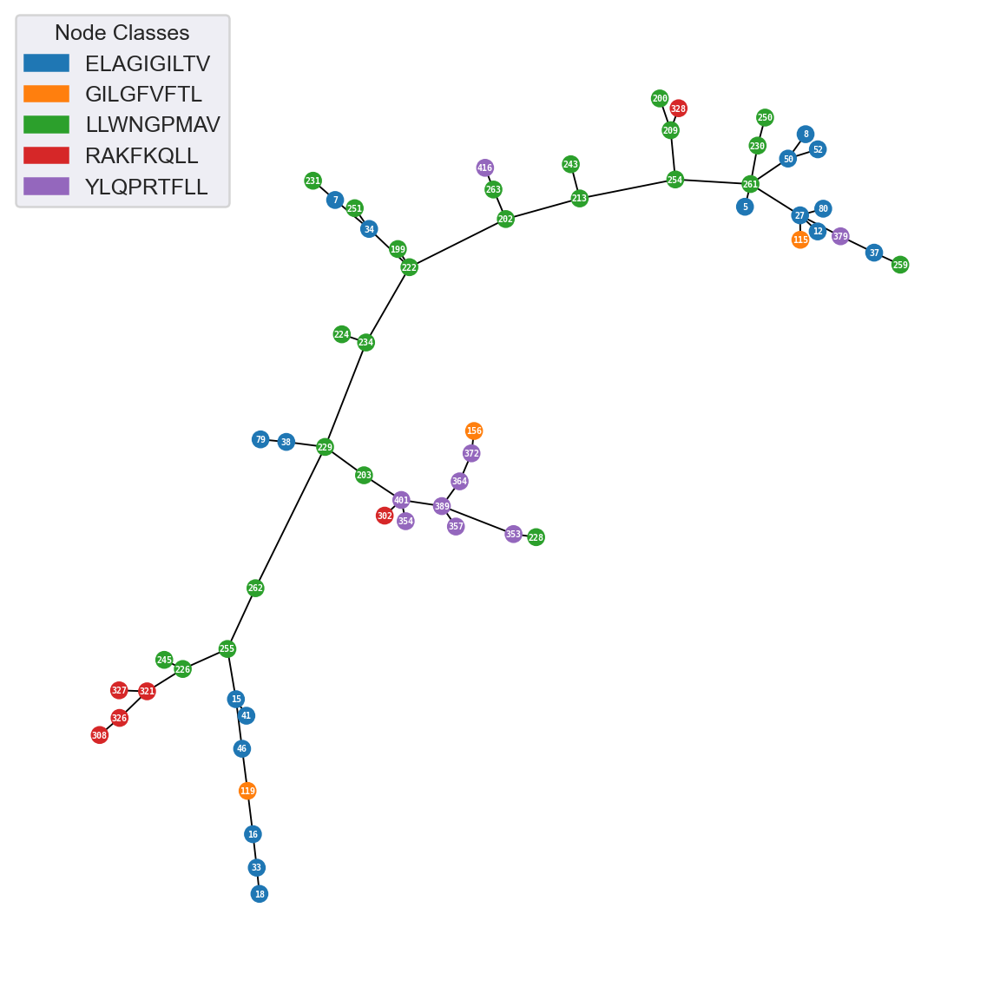

In [68]:
subgraph1=tree_pruned.subgraph(ecut_clusters[1]['members'])

edge_betweenness = nx.edge_betweenness_centrality(subgraph1)
node_betweenness = nx.betweenness_centrality(subgraph1)
# Sort it just for the printing // return ; These are list of tuples [(edge or node, centrality)]
sorted_edges = sorted(edge_betweenness.items(), key=lambda item: item[1], reverse=True)
sorted_nodes = sorted(node_betweenness.items(), key=lambda item: item[1], reverse=True)
print('\tEdge\tCentrality')
pprint(sorted_edges[:10])
print('\tNode\tCentrality')
pprint(sorted_nodes[:10])
# pprint(sorted_nodes[:7])
plot_mst_spring(subgraph1, color_map, scale=0.5)

Edge, centrality
[((416, 263), 0.6666666666666666), ((202, 263), 0.6666666666666666)]
Node, centrality
[(263, 1.0), (416, 0.0), (202, 0.0)]


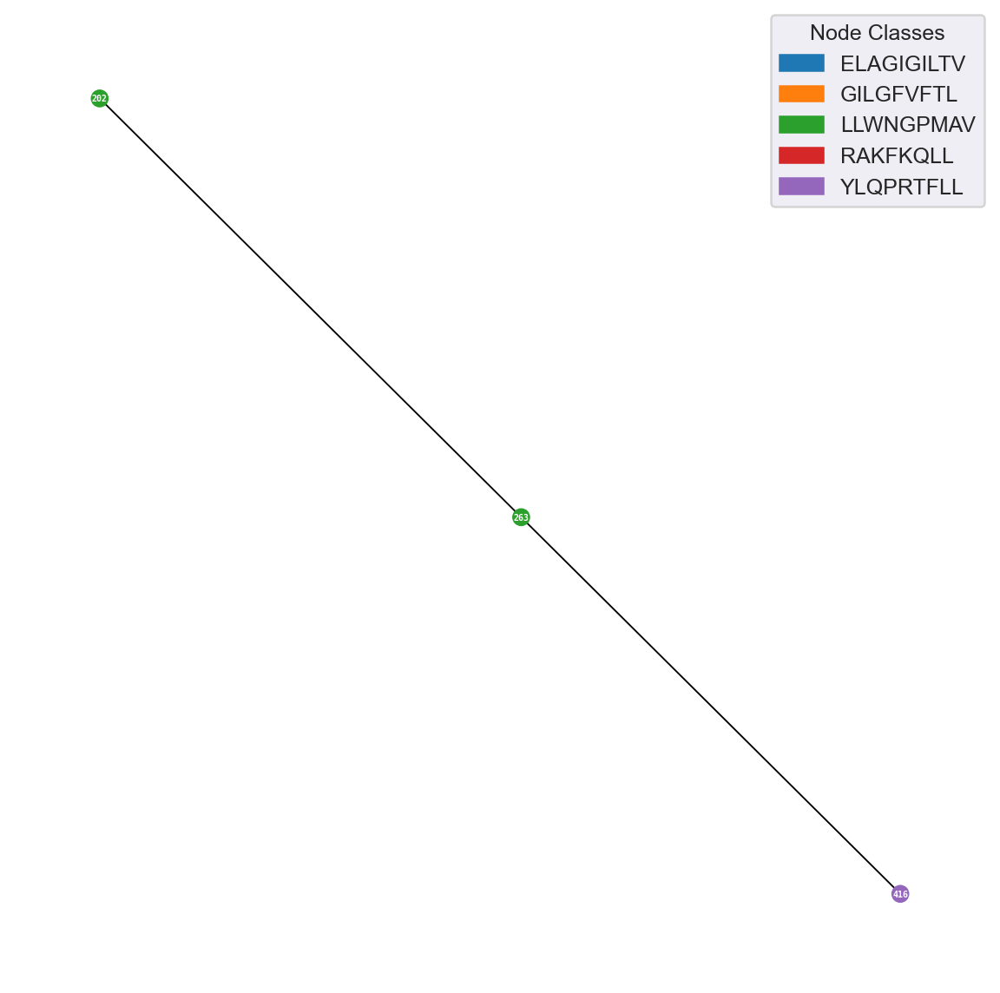

In [69]:
subgraph2 = tree_pruned.subgraph([202, 263, 416])

edge_betweenness2 = nx.edge_betweenness_centrality(subgraph2)
node_betweenness2 = nx.betweenness_centrality(subgraph2)
# Sort it just for the printing // return ; These are list of tuples [(edge or node, centrality)]
sorted_edges2 = sorted(edge_betweenness2.items(), key=lambda item: item[1], reverse=True)
sorted_nodes2 = sorted(node_betweenness2.items(), key=lambda item: item[1], reverse=True)
print('Edge, centrality')
pprint(sorted_edges2[:10])
print('Node, centrality')
pprint(sorted_nodes2[:10])
plot_mst_spring(subgraph2, color_map, scale=0.5)

In [70]:
[x for x in subgraph2.edges(data=True)]

[(416, 263, {'weight': 0.1453271508216858}),
 (202, 263, {'weight': 0.10888653993606567})]

In [71]:
weights= np.array([x[2]['weight'] for x in subgraph1.edges(data=True)])

In [72]:
np.where(weights>0.125)

(array([ 2,  7, 16, 17, 19, 20, 22, 25, 27, 28, 29, 30, 36, 38, 39, 44, 53]),)

# Recheck test set comparisons between train-valid-test for CNNVAE (128, 256, twostage128)

- Comparison : Use the validation set to select the "best" epoch based on some pur-ret AUC threshold
- Take that best epoch and use it on the test set ; Also take the "best" test set epoch to see if they match
- check with train set how that compares

In [54]:
from src.cluster_utils import *
from src.networkx_utils import *
def plot_pipeline_here(runs, title=None, fn=None, palette='tab10', add_clustersize=False, 
                       figsize=(9,9), legend=True, outdir = None):
    # plotting options
    sns.set_palette(palette, n_colors=len(runs.input_type.unique()))
    f, a = plt.subplots(1, 1, figsize=figsize)
    a.set_xlim([0, 1])
    a.set_ylim([0, 1])
    a.set_xlabel('Retention', fontweight='semibold', fontsize=14)
    a.set_ylabel('Mean Purity', fontweight='semibold', fontsize=14)
    # Setting major ticks
    major_ticks = np.arange(0, 1.1, 0.1)
    a.set_xticks(major_ticks)
    a.set_yticks(major_ticks)
    # Setting minor ticks
    minor_ticks = np.arange(0, 1.1, 0.05)
    a.set_xticks(minor_ticks, minor=True)
    a.set_yticks(minor_ticks, minor=True)
    plt.grid(which='both', linestyle='--', linewidth=0.5)
    if add_clustersize:
        ax2 = a.twinx()  # instantiate a second axes that shares the same x-axis
        ax2.set_yscale('log', base=2)
        ax2.set_ylabel('Mean Cluster Size (Log2)', fontweight='semibold', fontsize=14)
    for input_type in runs.input_type.unique():
        query = runs.query('input_type==@input_type')
        retentions = query['retention'][1:-1].values
        purities = query['mean_purity'][1:-1].values
        if add_clustersize:
            cluster_sizes = query['mean_cluster_size'].values[1:-1]
            
        if input_type == "TBCRalign":
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls=':', c='g', lw=1)
            if add_clustersize:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='x', lw=0.25, s=6, c='g')

        elif input_type == "tcrdist3":
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls=':', c='m', lw=1)
            if add_clustersize:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='.', lw=0.25, s=6, c='m')

        else:
            a.plot(retentions, purities, label=input_type.lstrip('_'), ls='--', lw=1.1)
            if add_clustersize:
                ax2.scatter(retentions, cluster_sizes, label=input_type.lstrip('_'), marker='*', lw=0.25, s=6)


    a.axhline(0.6, label='60% purity cut-off', ls=':', lw=.75, c='m')
    a.axhline(0.7, label='70% purity cut-off', ls=':', lw=.75, c='c')
    a.axhline(0.8, label='80% purity cut-off', ls=':', lw=.75, c='y')
    if legend:
        a.legend(title='distance matrix', title_fontproperties={'size': 14, 'weight': 'semibold'},
             prop={'weight': 'semibold', 'size': 12}, loc='lower left')
    f.suptitle(f'{title}', fontweight='semibold', fontsize=15)
    f.tight_layout()
    if fn is not None:
        if outdir is not None:
            mkdirs(outdir)
            fn = f'{outdir}{fn}'
        f.savefig(f'{fn}.png', dpi=200)

(<Figure size 1620x1620 with 2 Axes>,
 <Axes: xlabel='Retention', ylabel='Mean Purity'>)

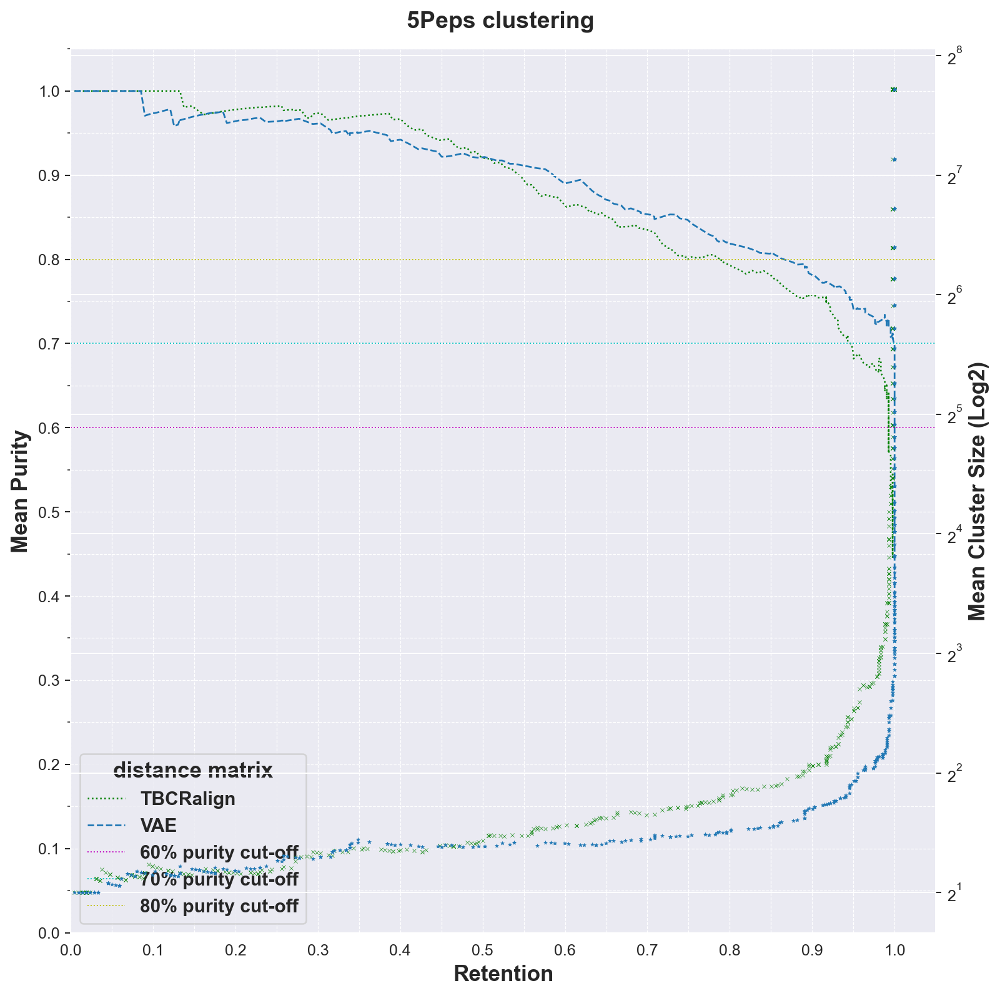

In [55]:
plot_retention_purities(pd.concat([tbcr_cluster.assign(input_type='TBCRalign'), 
                             vae_cluster.assign(input_type='vae'.upper())]), title='5Peps clustering', add_clustersize=True)

In [56]:
exp17 = pd.read_csv('../data/filtered/240418_nettcr_expanded_20binders_17pep_POSONLY.csv')
exp78 = pd.read_csv('../data/filtered/240507_nettcr_exp_pruned_noswap_78peps.csv')
train17=exp17.query('partition!=0 and partition!=1')
valid17=exp17.query('partition==0')
test17 =exp17.query('partition==1')
train78=exp78.query('partition!=0 and partition!=1')
valid78=exp78.query('partition==0')
test78=exp78.query('partition==1')

## weird curves check

In [596]:
%ls ../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/


Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_test_results.csv
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_train_results.csv
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_valid_results.csv
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJtest_pur_ret_curve.png
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJtrain_pur_ret_curve.png
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJvalid_pur_ret_curve.png
args_Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ.txt


python(97562) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [594]:
%ls ../output/240618_NestedKCV_CNNVAE/

Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/
Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/
clustering/


python(95684) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [595]:
%ls ../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/


Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/
Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpDataTop78_KFold_v0_t1_240620_1415_ER8wJ/
Nested_CNNVAE_latent_256_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_vnN02/
Nested_CNNVAE_latent_256_kld_1e-2_ExpData_ExpDataTop78_KFold_v0_t1_240620_1414_vnN02/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240619_0550_pDQhj/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_pDQhj/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_ExpDataTop78_KFold_v0_t1_240619_0551_pDQhj/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_ExpDataTop78_KFold_v0_t1_240620_1412_pDQhj/


python(95686) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


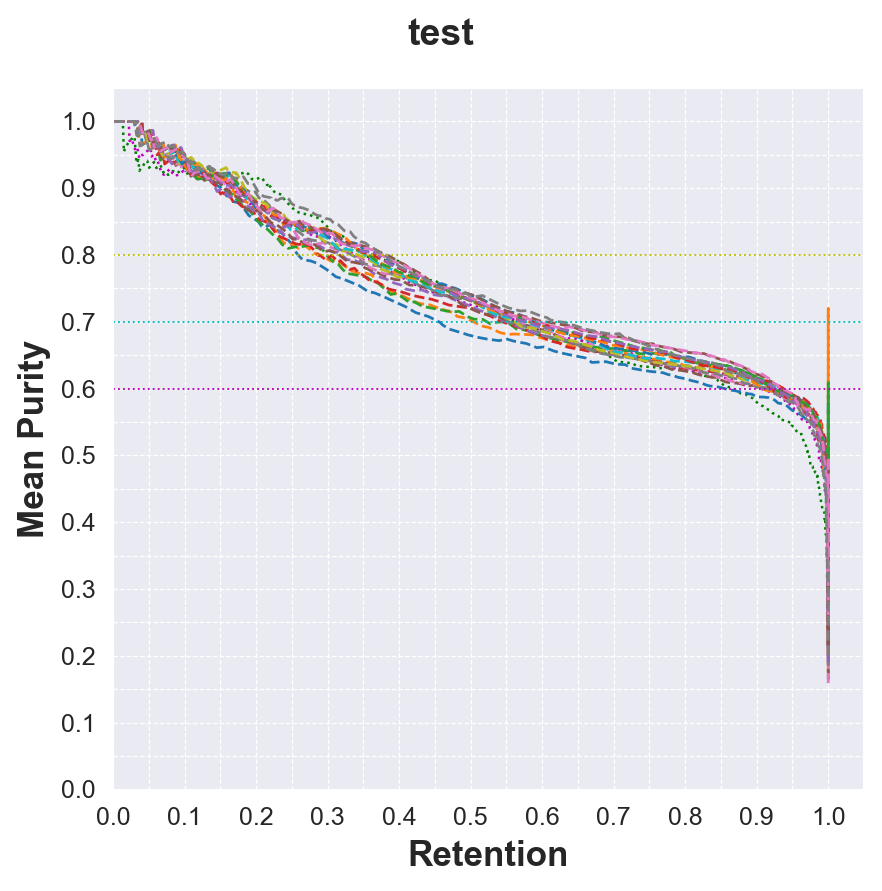

In [57]:
test=pd.read_csv('../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_test_results.csv')
valid=pd.read_csv('../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_valid_results.csv')
train=pd.read_csv('../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ_train_results.csv')
plot_pipeline_here(test, title='test',figsize=(5,5), legend=False)

In [58]:
from src.conv_models import CNNVAE, TwoStageCNNVAECLF
from src.torch_utils import load_model_full
model, js = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/epoch_12000_interval_checkpoint__fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/checkpoint_best_fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ_JSON_kwargs.json',
                        map_location='cpu', return_json=True)
latent_df = get_latent_df(model, test17)
dm, da, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 12000
total: 0.09249192321257954
reconstruction: 0.07286190794384766
kld: 0.0030538868492688605
triplet: 0.016576130514938815
seq_accuracy: 0.9930979609489441
pos_accuracy: 0.9981057643890381


In [59]:
threshold=0.409
cc = AgglomerativeClustering(n_clusters=None, metric='precomputed', distance_threshold=threshold, linkage='complete')
cc.fit(da)
output = get_all_metrics(threshold, feats, cc, da, labels, enc_labels, lab_enc)
output

{'threshold': 0.409,
 'n_cluster': 4,
 'n_singletons': 0,
 'n_cluster_over_70p': 2,
 'mean_purity': 0.577442080184029,
 'min_purity': 0.14705882352941177,
 'max_purity': 1.0,
 'mean_coherence': 0.22381741,
 'min_coherence': 0.19069052,
 'max_coherence': 0.24496898,
 'mean_cluster_size': 367.5,
 'min_cluster_size': 2,
 'max_cluster_size': 1432,
 'silhouette': 0.04745779,
 'ch_index': 4.807413954442128,
 'db_index': 2.72134144285727,
 'ARI': 0.0021257641286831766}

In [114]:
%ls ../output/240618_NestedKCV_CNNVAE/

Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/
Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02/
Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/
clustering/


In [60]:
def read_results(main_folder):
    train = pd.read_csv(glob.glob(f'{main_folder}*train*.csv')[0])
    valid = pd.read_csv(glob.glob(f'{main_folder}*valid*.csv')[0])
    test = pd.read_csv(glob.glob(f'{main_folder}*test*.csv')[0])
    return train, valid, test
    
def results_pipeline(main_folder, title=None, fn=None, palette='tab10', add_clustersize=False, figsize=(9, 9), legend=True, outdir=None):
    """
    Takes the train,test,valid curves ; Gets the best in terms of valid RP p70_r35_AUC (top 3)
    And plot those curves for all 3 plots and compare
    """
    train, valid, test = read_results(main_folder)
    top3_valid = get_all_inputs_rpauc(valid.query('not input_type.str.contains("agg") and not input_type.str.contains("TBCR")')).head(3)
    rankings = {k:f' (Top {i+1})' for i, k in enumerate(top3_valid.index)}
    train_plot = train.query('input_type in @top3_valid.index or input_type in ["TBCRalign", "tcrdist3"]')
    train_plot['name'] = train_plot['input_type'].map(rankings).replace(np.nan, '')
    train_plot['input_type'] = train_plot.apply(lambda x: x['input_type'] + x['name'], axis=1)
    valid_plot = valid.query('input_type in @top3_valid.index or input_type in ["TBCRalign", "tcrdist3"]')
    valid_plot['name'] = valid_plot['input_type'].map(rankings).replace(np.nan, '')
    valid_plot['input_type'] = valid_plot.apply(lambda x: x['input_type'] + x['name'], axis=1)
    test_plot = test.query('input_type in @top3_valid.index or input_type in ["TBCRalign", "tcrdist3"]')
    test_plot['name'] = test_plot['input_type'].map(rankings).replace(np.nan, '')
    test_plot['input_type'] = test_plot.apply(lambda x: x['input_type'] + x['name'], axis=1)
    plot_pipeline_here(train_plot.query('not (retention>0.98 and mean_purity>0.3)'),
                       f'{title}\nTrain set ; Selected best validation epochs', f'{fn}_top3ValEpochs_train_plot', palette, add_clustersize, figsize, legend, outdir)
    
    plot_pipeline_here(valid_plot.query('not (retention>0.98 and mean_purity>0.3)'),
                       f'{title}\nValid set ; Selected best validation epochs', f'{fn}_top3ValEpochs_valid_plot', palette, add_clustersize, figsize, legend, outdir)
    
    plot_pipeline_here(test_plot.query('not (retention>0.98 and mean_purity>0.3)'),
                       f'{title}\ntest set ; Selected best validation epochs', f'{fn}_top3ValEpochs_test_plot', palette, add_clustersize, figsize, legend, outdir)
    
    return train_plot, valid_plot, test_plot

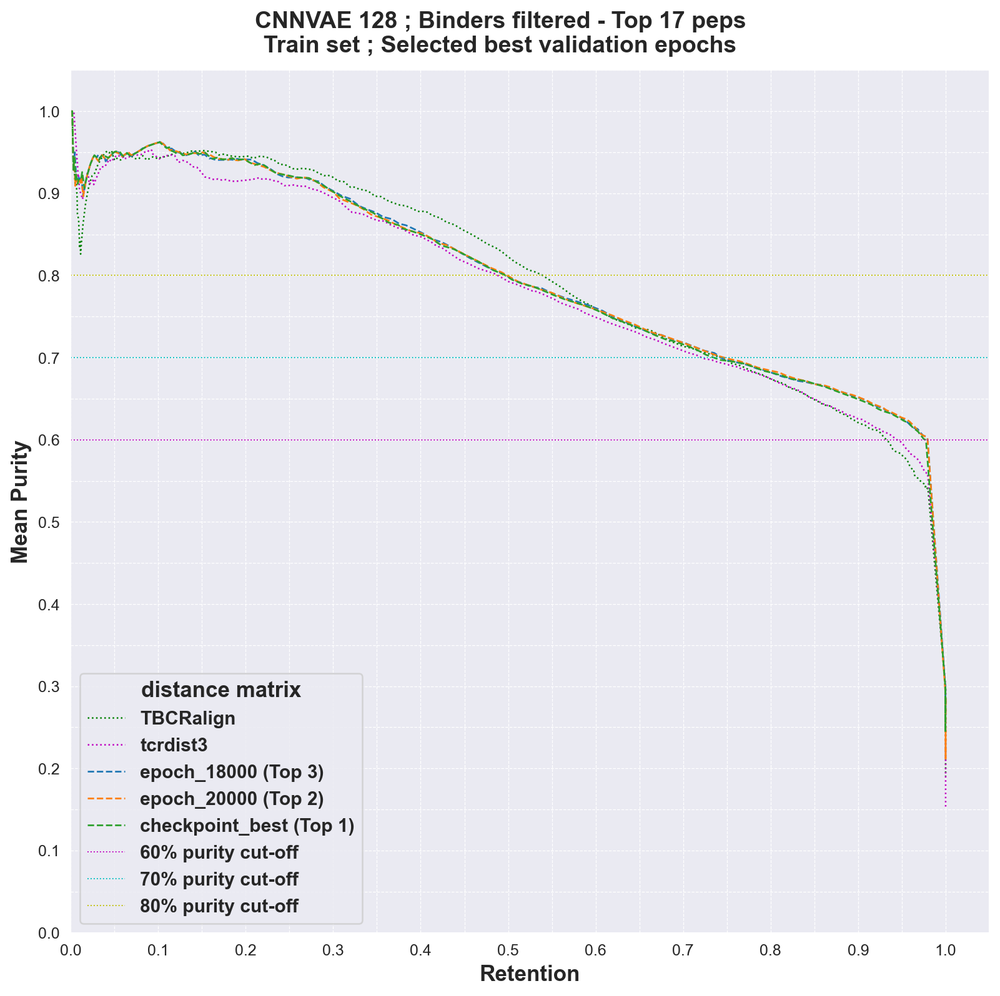

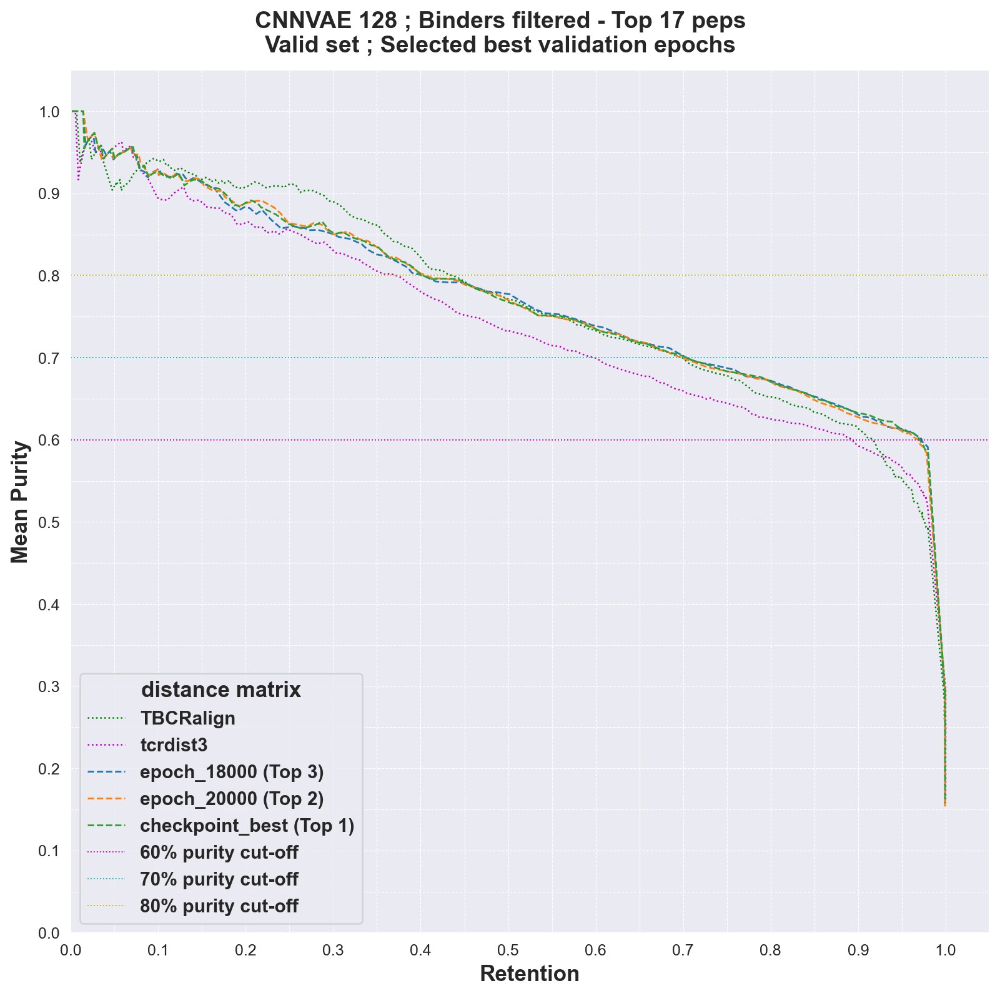

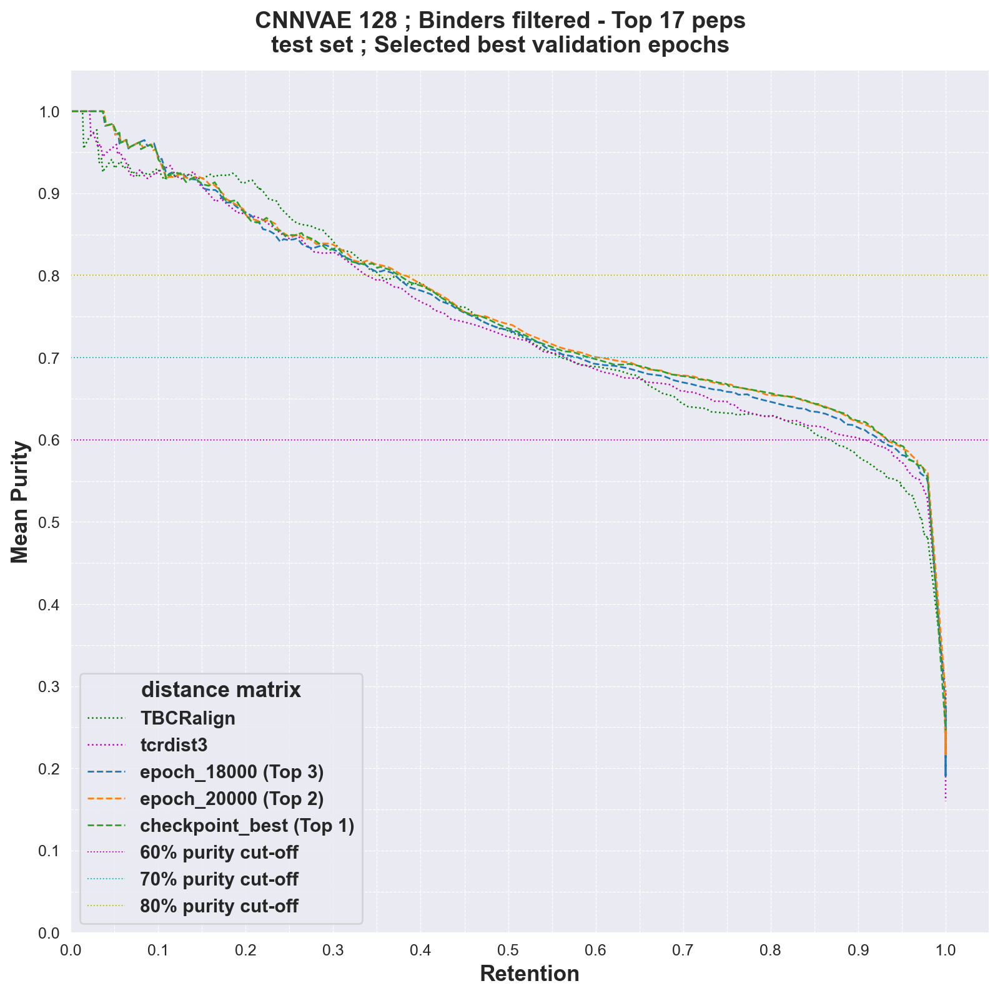

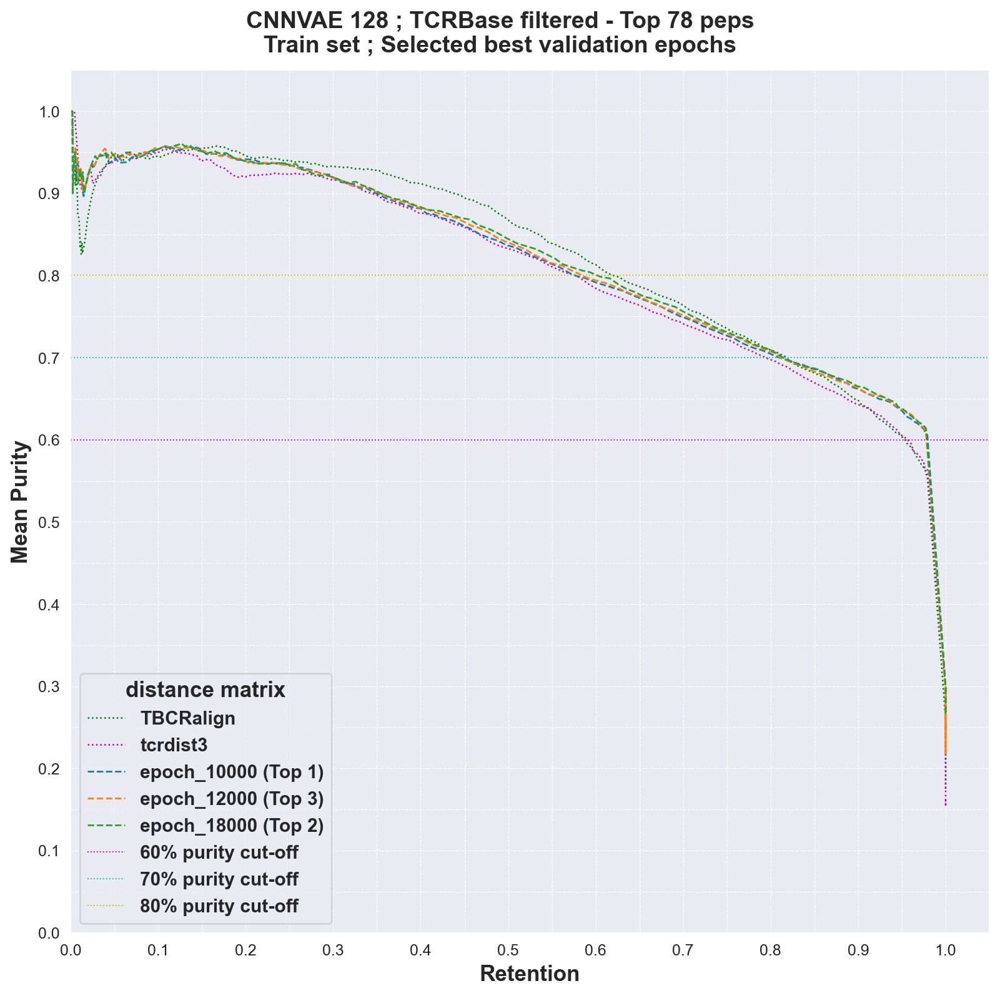

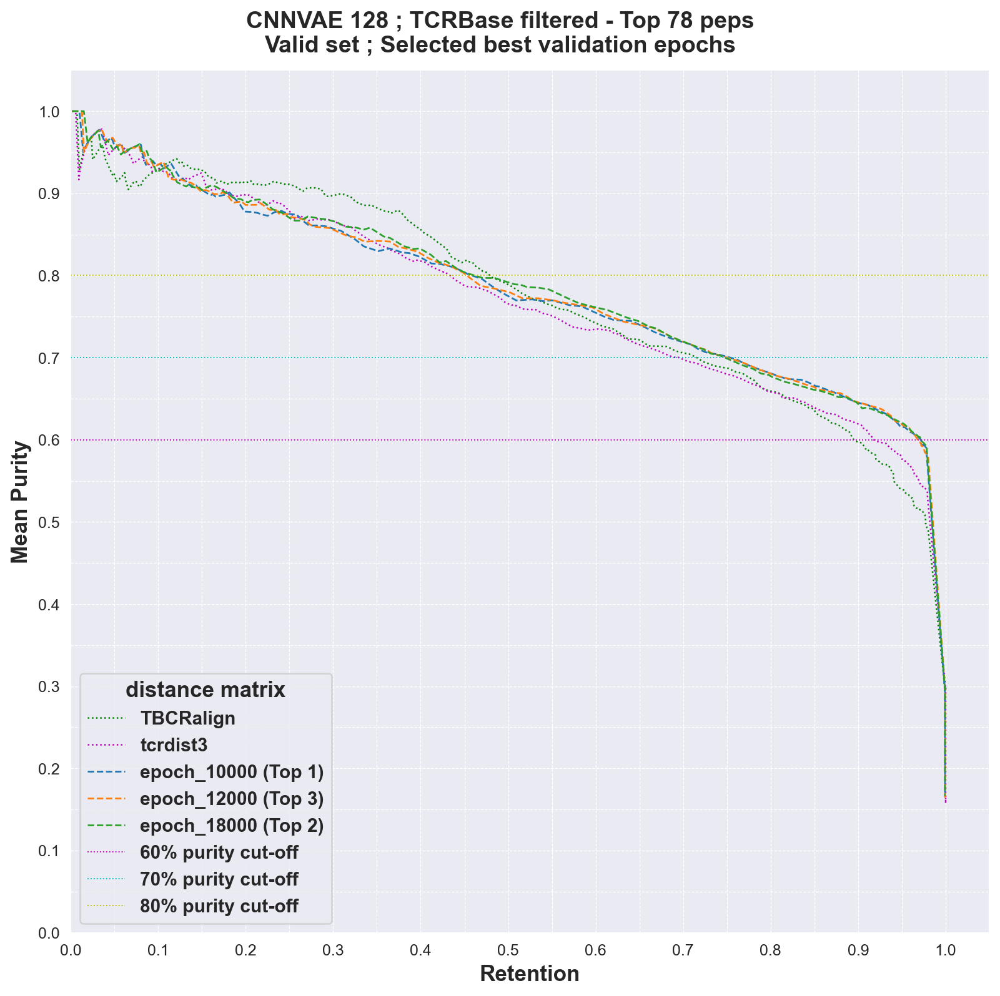

...

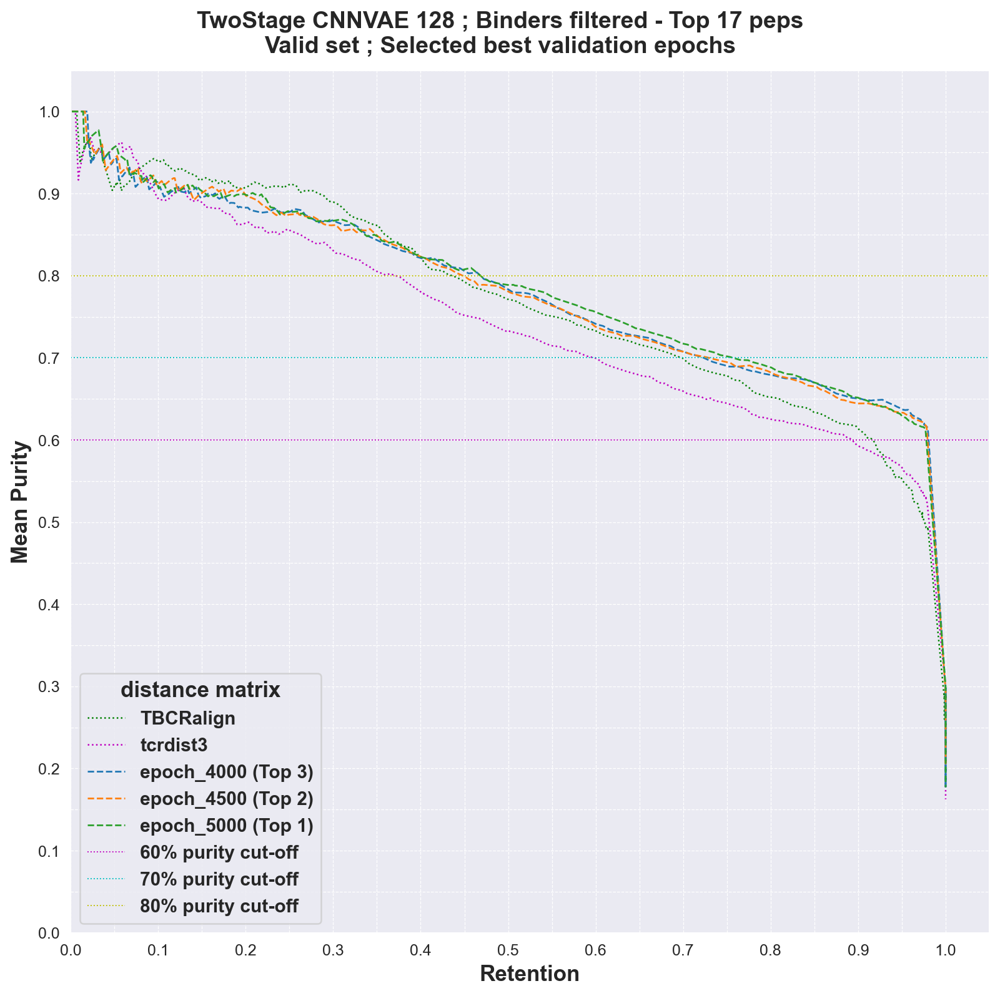

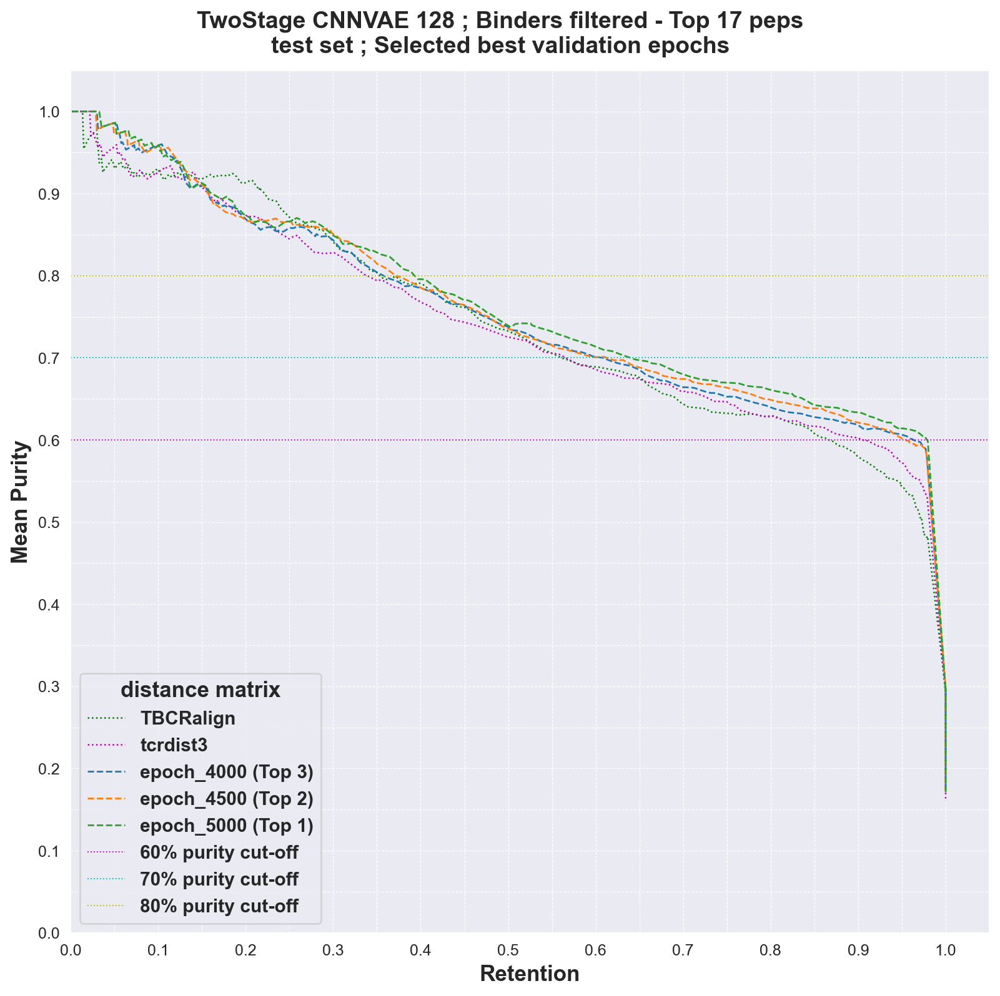

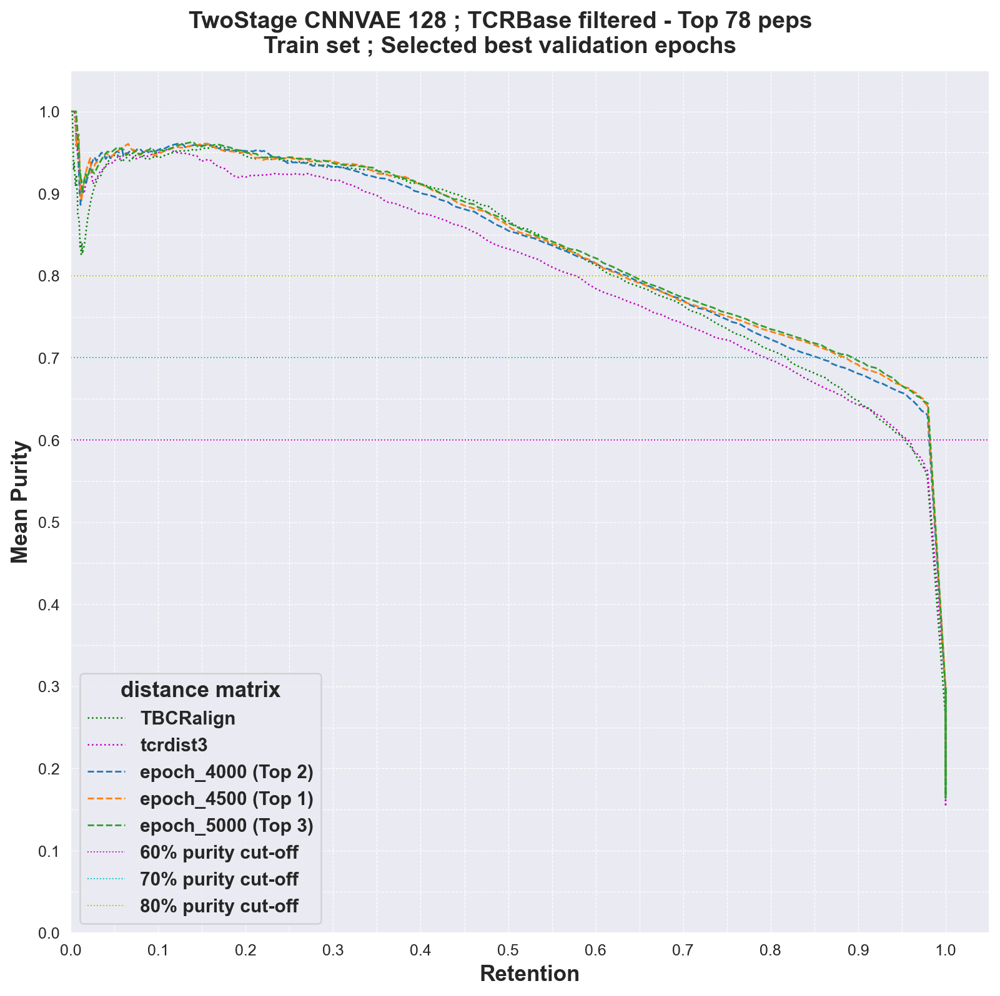

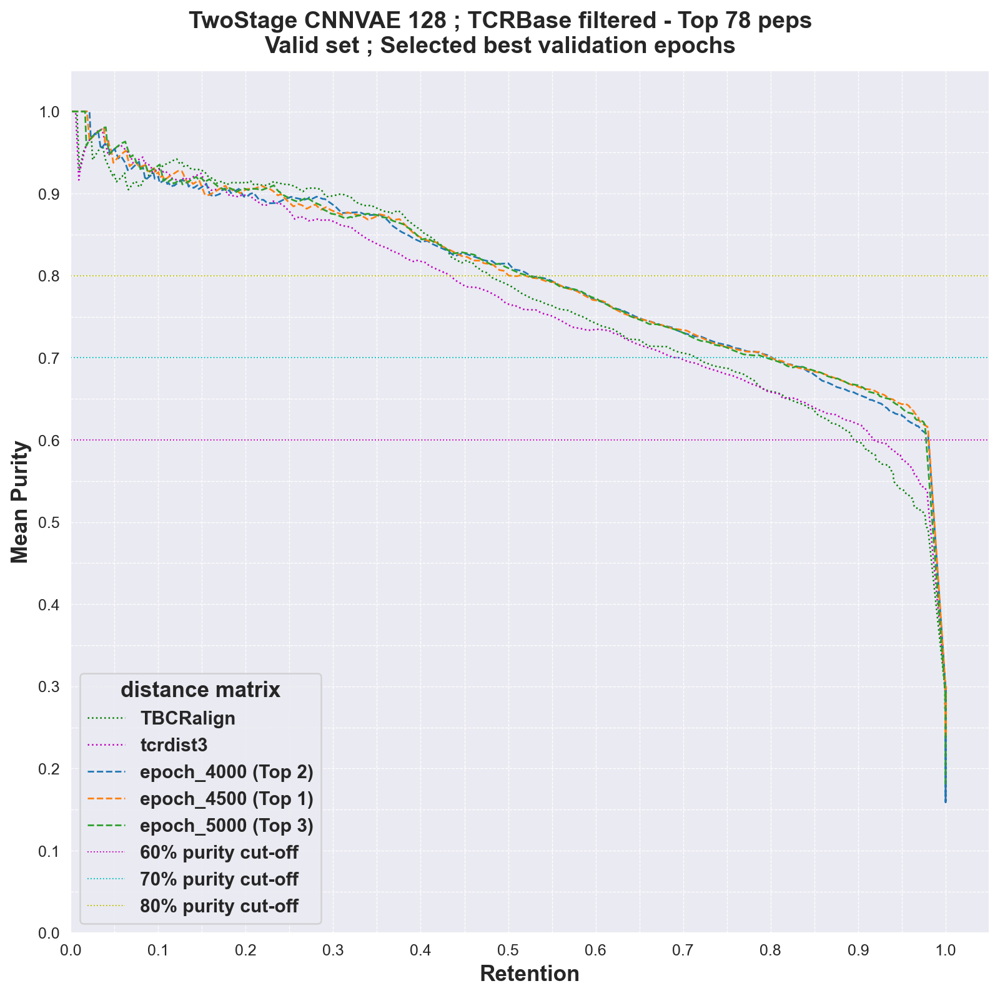

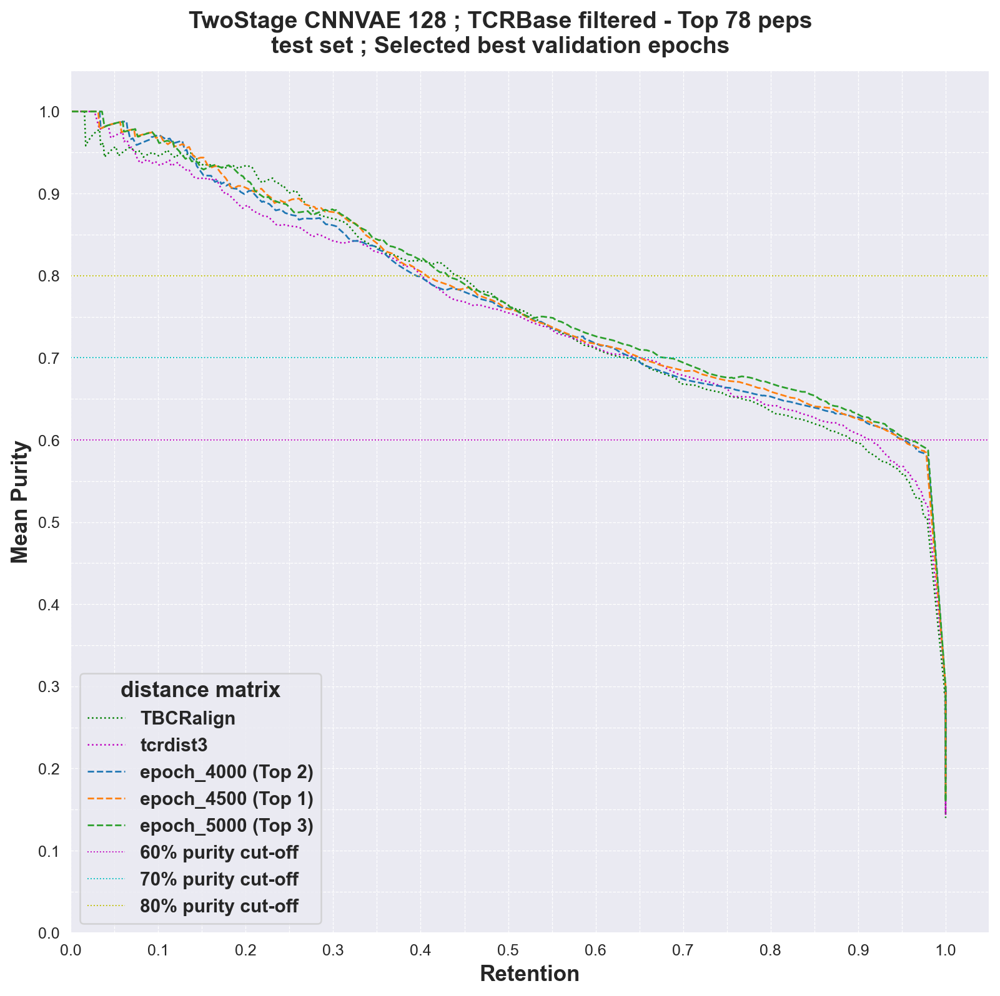

In [61]:
names = ['CNNVAE 128 ; Binders filtered - Top 17 peps',
         'CNNVAE 128 ; TCRBase filtered - Top 78 peps',
         'CNNVAE 256 ; Binders filtered - Top 17 peps',
         'CNNVAE 256 ; TCRBase filtered - Top 78 peps',
         'TwoStage CNNVAE 128 ; Binders filtered - Top 17 peps',
         'TwoStage CNNVAE 128 ; TCRBase filtered - Top 78 peps']
filenames = ['CNNVAE_128_Top17peps', 
             'CNNVAE_128_Top78peps', 
             'CNNVAE_256_Top17peps', 
             'CNNVAE_256_Top78peps', 
             'TwoStage_128_Top17peps', 
             'TwoStage_128_Top78peps']
files = sorted(glob.glob('../output/240618_NestedKCV_CNNVAE/clustering/*/'))

for name, filename, main_folder in zip(names, filenames, files):
    results_pipeline(main_folder, title=name, fn=filename, outdir='../output/240618_NestedKCV_CNNVAE/figs/')

In [215]:
train

,Unnamed: 0,threshold,n_cluster,n_singletons,n_cluster_over_70p,mean_purity,min_purity,max_purity,mean_coherence,min_coherence,...,mean_cluster_size,min_cluster_size,max_cluster_size,silhouette,ch_index,db_index,ARI,retention,input_type,name
0,0,0.00327,0,4398,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,TBCRalign,
1,1,0.00395,1,4396,1,1.000000,1.000000,1.000000,0.003275,0.003275,...,2.0,2.0,2.0,0.000000,10.416877,1.711376,0.000002,0.000455,TBCRalign,
2,2,0.00462,1,4396,1,1.000000,1.000000,1.000000,0.003275,0.003275,...,2.0,2.0,2.0,0.000000,10.416877,1.711376,0.000002,0.000455,TBCRalign,
3,3,0.00530,1,4396,1,1.000000,1.000000,1.000000,0.003275,0.003275,...,2.0,2.0,2.0,0.000000,10.416877,1.711376,0.000002,0.000455,TBCRalign,
4,4,0.00597,4,4390,4,1.000000,1.000000,1.000000,0.004887,0.003275,...,2.0,2.0,2.0,0.000000,2.170823,10.222813,0.000009,0.001819,TBCRalign,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9495,495,0.55444,2,0,0,0.329540,0.159081,0.500000,0.272787,0.242587,...,2199.0,4.0,4394.0,0.358866,4.430602,1.810715,-0.000016,1.000000,checkpoint_best,(Top 1)
9496,496,0.55556,2,0,0,0.329540,0.159081,0.500000,0.272787,0.242587,...,2199.0,4.0,4394.0,0.358866,4.430602,1.810715,-0.000016,1.000000,checkpoint_best,(Top 1)
9497,497,0.55668,2,0,0,0.329540,0.159081,0.500000,0.272787,0.242587,...,2199.0,4.0,4394.0,0.358866,4.430602,1.810715,-0.000016,1.000000,checkpoint_best,(Top 1)
9498,498,0.55779,2,0,0,0.329540,0.159081,0.500000,0.272787,0.242587,...,2199.0,4.0,4394.0,0.358866,4.430602,1.810715,-0.000016,1.000000,checkpoint_best,(Top 1)


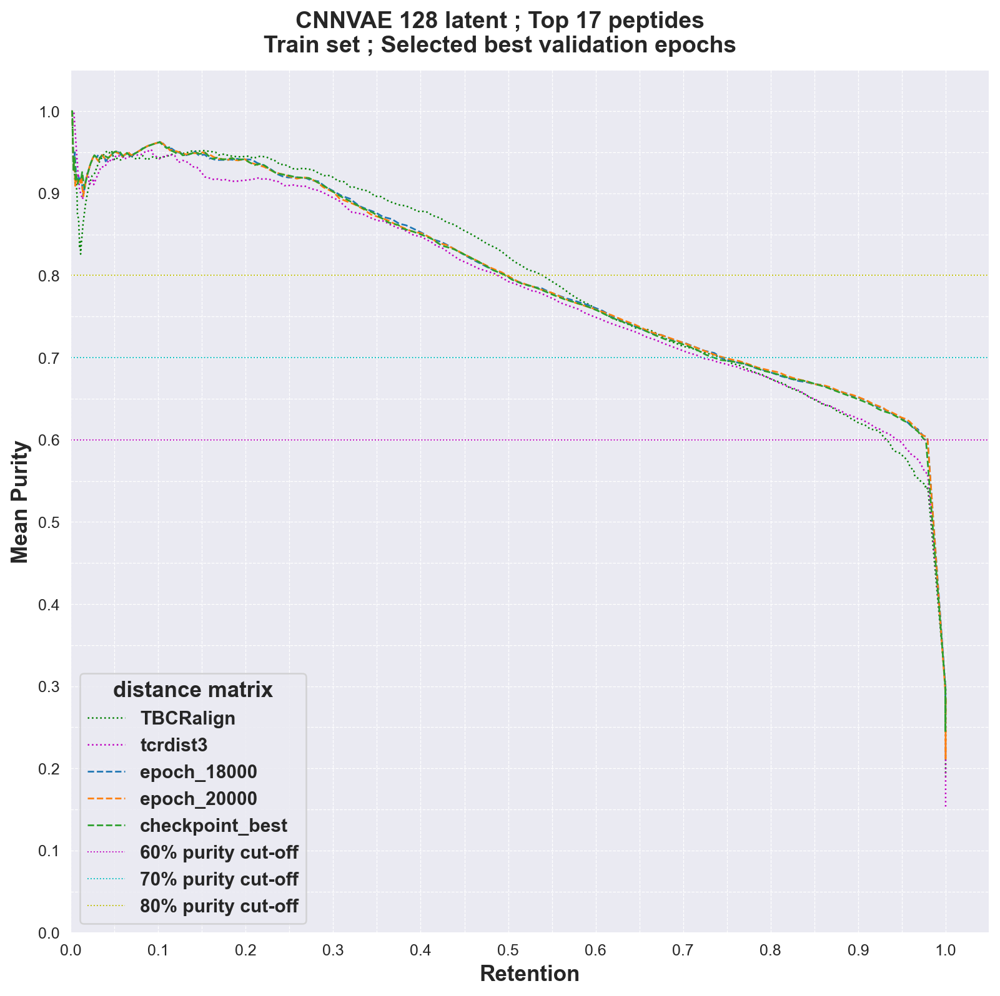

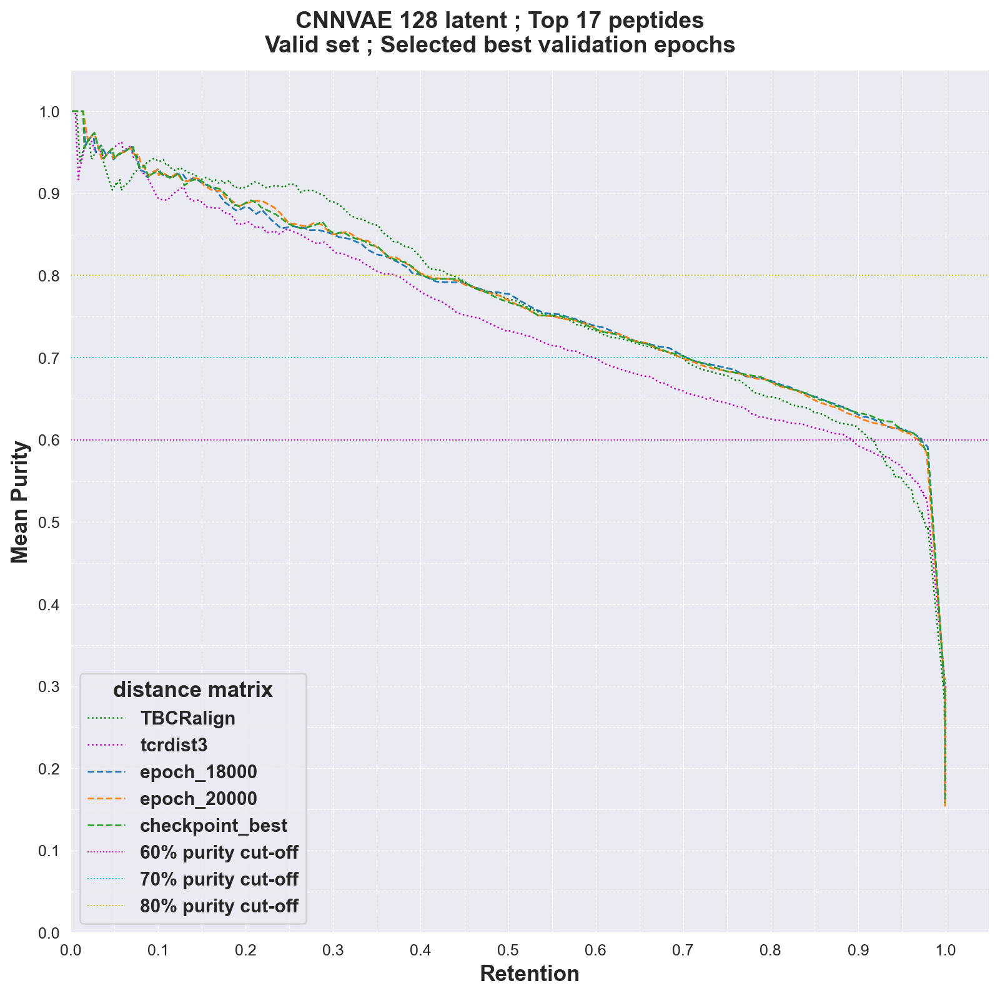

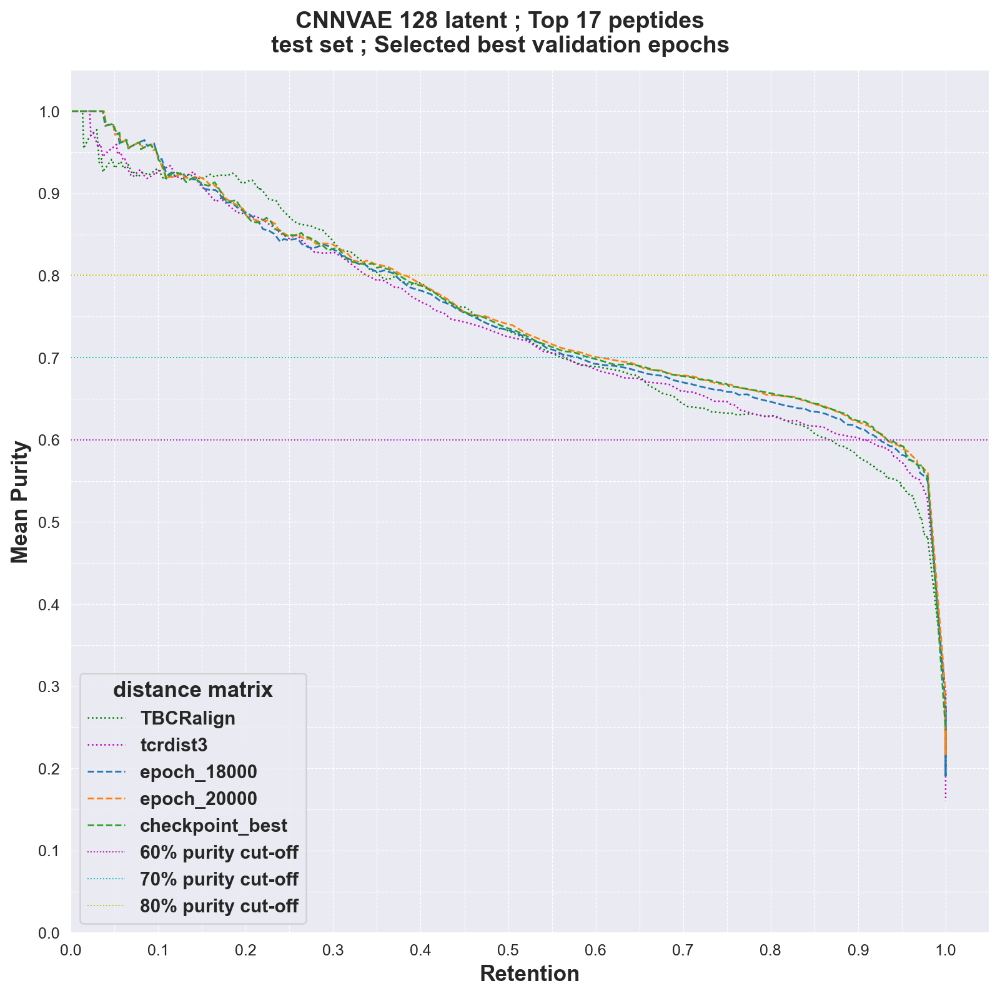

In [201]:
train,valid,test = results_pipeline('../output/240618_NestedKCV_CNNVAE/clustering/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_ExpData17peps_KFold_v0_t1_240620_1257_ER8wJ/',
                                    title = 'CNNVAE 128 latent ; Top 17 peptides')

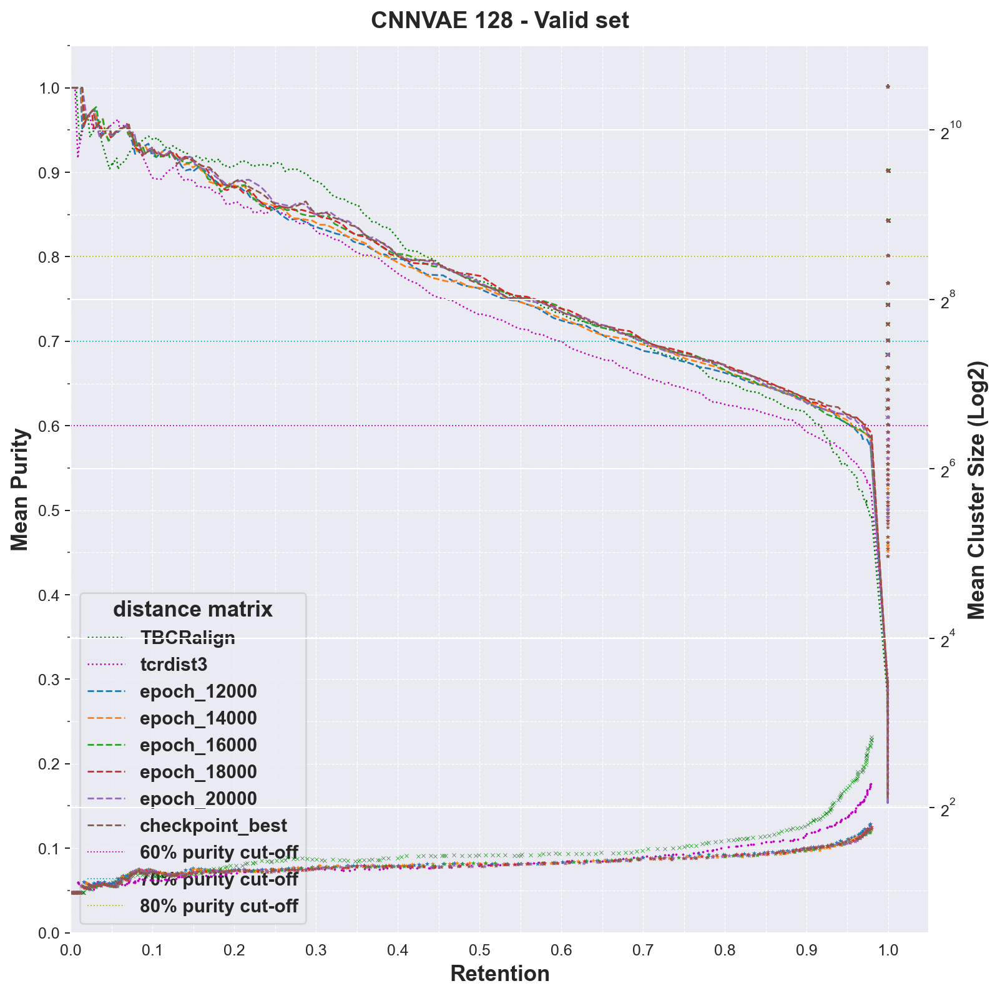

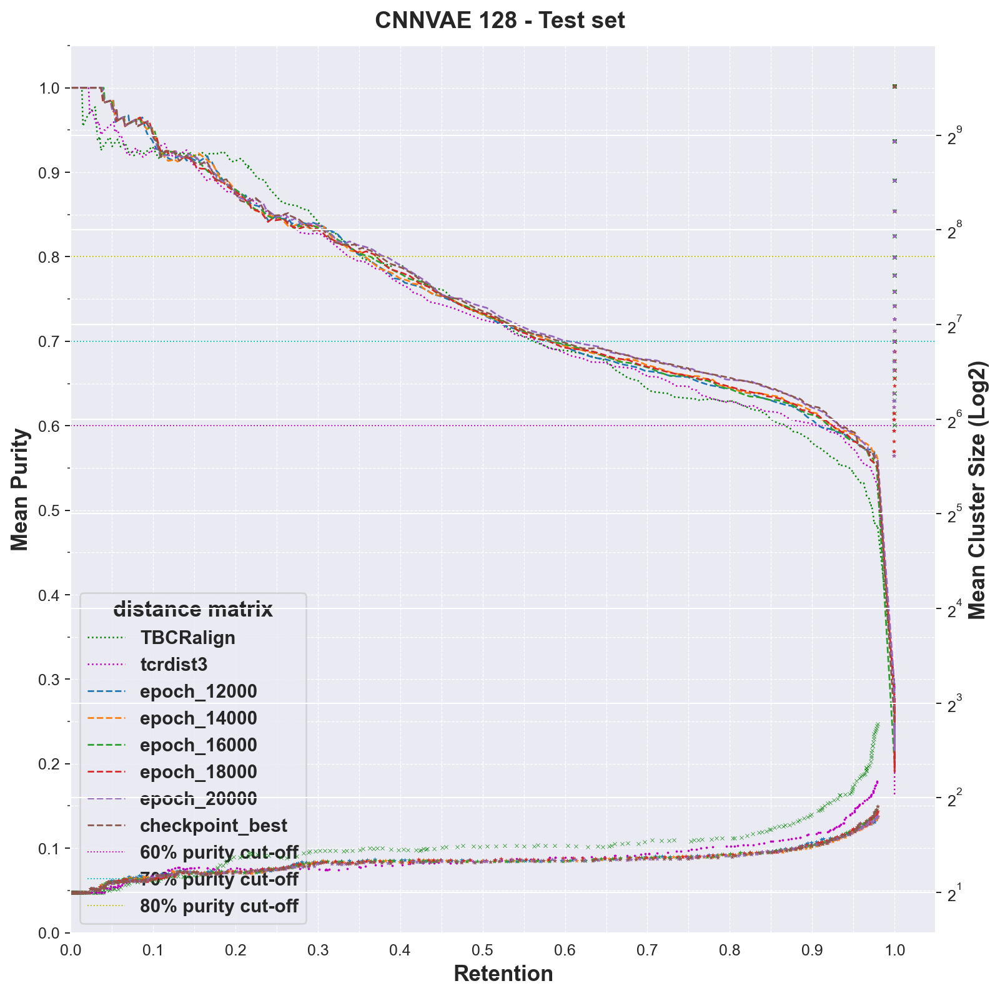

In [176]:
plot_pipeline_here(valid.query('input_type in @valid_rpauc.head(6).index or input_type in ["TBCRalign", "tcrdist3"]').query('not (retention>0.98 and mean_purity>0.3)'),
                   title = 'CNNVAE 128 - Valid set', add_clustersize=True)
plot_pipeline_here(test.query('input_type in @valid_rpauc.head(6).index or input_type in ["TBCRalign", "tcrdist3"]').query('not (retention>0.98 and mean_purity>0.3)'),
                   title = 'CNNVAE 128 - Test set', add_clustersize=True)

# Refine pruning algorithm ; Use TwoStage CNNVAE 128 

## quick matrices checks

In [230]:
index_top5peps = tbcr_test.raw_index.values
top5peps = pd.read_csv('../data/filtered/240326_nettcr_paired_NOswaps.csv').query('raw_index in @index_top5peps').sort_values('peptide')

In [231]:
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_4500_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df = get_latent_df(model, top5peps)
dm_ts128, da_ts128, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 4500
total: 0.2232360578177835
reconstruction: 0.06748699668131114
kld: 0.0
triplet: 0.0
BCE: 0.15574906095925906
seq_accuracy: 0.9947810173034668
pos_accuracy: 0.9975979924201965
auc: 0.73572
auc_01: 0.63023
auc_01_real: 0.29744
precision: 0.44012
recall: 0.43294
accuracy: 0.81313
AP: 0.46103


In [232]:
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/checkpoint_best_fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ/checkpoint_best_fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1607_ER8wJ_JSON_kwargs.json',
                        map_location='cpu')
latent_df = get_latent_df(model, top5peps)
dm_ld128, da_ld128, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
Best epoch: 19934
total: 0.07886607476881971
reconstruction: 0.05939108139774983
kld: 0.003005831211369365
triplet: 0.01646916461991662
seq_accuracy: 0.9946388602256775
pos_accuracy: 0.9974550008773804


In [233]:
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02/epoch_3500_interval_checkpoint__fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02/checkpoint_best_fold00_kcv_240618_nettcr_exp_nested_posonly_train_p0234_f00_Nested_CNNVAE_latent_256_kld_1e-2_ExpData_KFold_0_240618_1607_vnN02_JSON_kwargs.json',
                        map_location='cpu')
latent_df = get_latent_df(model, top5peps)
dm_ld256, da_ld256, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 256 9 4 2 1 0 SELU()
Reloading best model:
epoch: 3500
total: 17.972305712196547
reconstruction: 17.953580151158654
kld: 0.002701948564865307
triplet: 0.016024154117487633
seq_accuracy: 0.49495241045951843
pos_accuracy: 0.9996891617774963


In [236]:
print(da_ld128[da_ld128!=0].min(), da_ld128.max(), np.median(da_ld128), da_ld128.mean(), da_ld128.std())
print(da_ld256[da_ld256!=0].min(), da_ld256.max(), np.median(da_ld256), da_ld256.mean(), da_ld256.std())
print(da_ts128[da_ts128!=0].min(), da_ts128.max(), np.median(da_ts128), da_ts128.mean(), da_ts128.std())

0.01782453 0.37300664 0.24371898 0.23931956 0.038446426
0.022235036 0.35006607 0.2407245 0.23581505 0.035749674
0.08901167 1.3716043 0.98699164 0.96484166 0.15035719


Results for CNNVAE:	Intra-class: 0.6583, Inter-class: 0.7352, Ratio: 0.8954
Results for TBCRalign:	Intra-class: 0.6832, Inter-class: 0.7416, Ratio: 0.9213
Results for aggregate1:	Intra-class: 0.8729, Inter-class: 0.9271, Ratio: 0.9415
Results for aggregate2:	Intra-class: 0.7338, Inter-class: 0.8042, Ratio: 0.9124
Results for CNN128:	Intra-class: 0.6822, Inter-class: 0.7615, Ratio: 0.8958
Results for CNN256:	Intra-class: 0.7014, Inter-class: 0.7977, Ratio: 0.8792
Results for TwoStage128:	Intra-class: 0.6852, Inter-class: 0.7824, Ratio: 0.8758


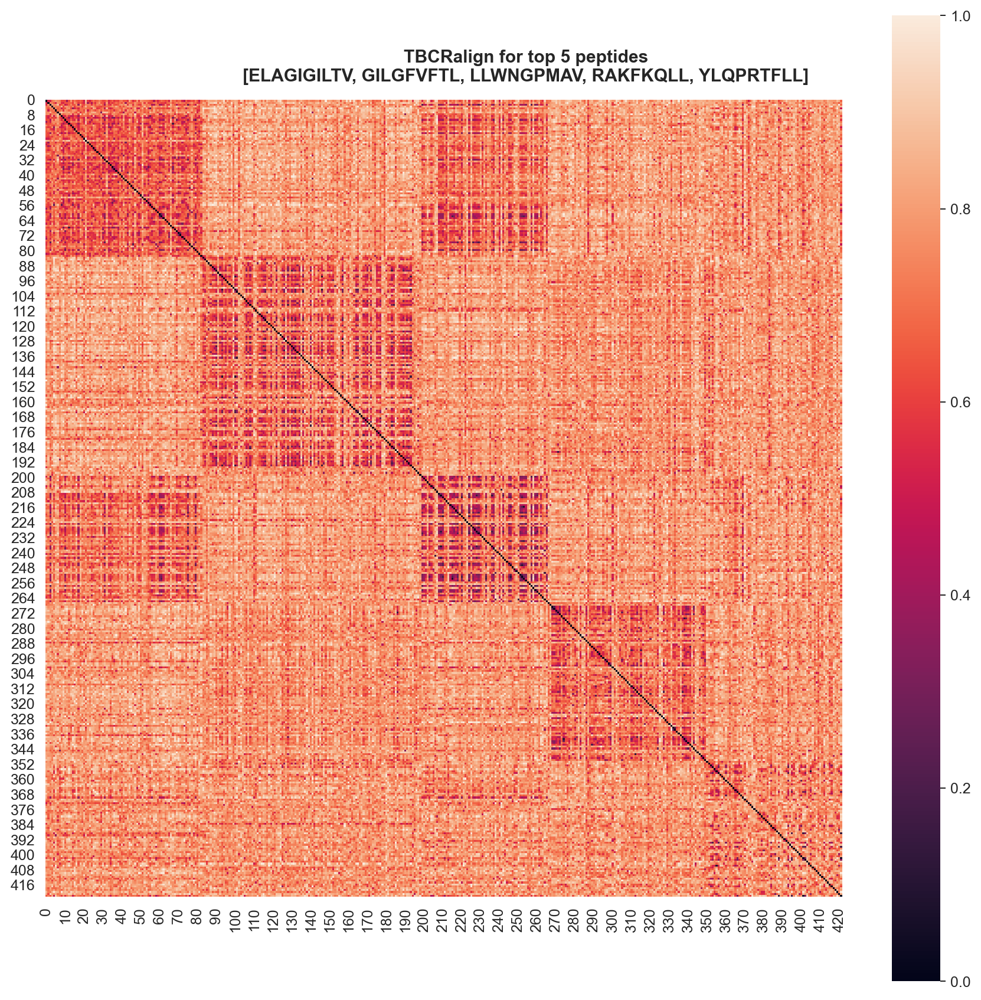

In [237]:
import numpy as np

# Evaluate dist matrix
def evaluate_distance_matrix(distance_matrix, labels):
    unique_classes = np.unique(labels)
    intra_class_distances = []
    inter_class_distances = []

    # Compute intra-class distances
    for class_label in unique_classes:
        intra_indices = np.where(labels == class_label)[0]
        intra_class_distances.append(distance_matrix[np.ix_(intra_indices, intra_indices)].mean())

    # Compute inter-class distances
    for i, class1 in enumerate(unique_classes):
        for j, class2 in enumerate(unique_classes):
            if class1 != class2:
                indices1 = np.where(labels == class1)[0]
                indices2 = np.where(labels == class2)[0]
                inter_class_distances.append(distance_matrix[np.ix_(indices1, indices2)].mean())

    mean_intra = np.mean(intra_class_distances)
    mean_inter = np.mean(inter_class_distances)
    ratio = mean_intra / mean_inter

    return mean_intra, mean_inter, ratio

# Assuming distance_matrix1, distance_matrix2, distance_matrix3, and labels are defined
results1 = evaluate_distance_matrix(mms.fit_transform(da_test), encoded_labels)
results2 = evaluate_distance_matrix(mms.fit_transform(da_tbcr), encoded_labels)
results3 = evaluate_distance_matrix(da_agg1, encoded_labels)
results4 = evaluate_distance_matrix(mms.fit_transform(da_agg2), encoded_labels)
results5 = evaluate_distance_matrix(mms.fit_transform(da_ld128), encoded_labels)
results6 = evaluate_distance_matrix(mms.fit_transform(da_ld256), encoded_labels)
results7 = evaluate_distance_matrix(mms.fit_transform(da_ts128), encoded_labels)

print("Results for CNNVAE:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results1))
print("Results for TBCRalign:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results2))
print("Results for aggregate1:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results3))
print("Results for aggregate2:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results4))
print("Results for CNN128:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results5))
print("Results for CNN256:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results6))
print("Results for TwoStage128:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results7))
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap( mms.fit_transform(da_ts128), square=True, ax = a)
f.suptitle('TBCRalign for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]',fontweight='semibold',  y=0.9)
f.tight_layout()

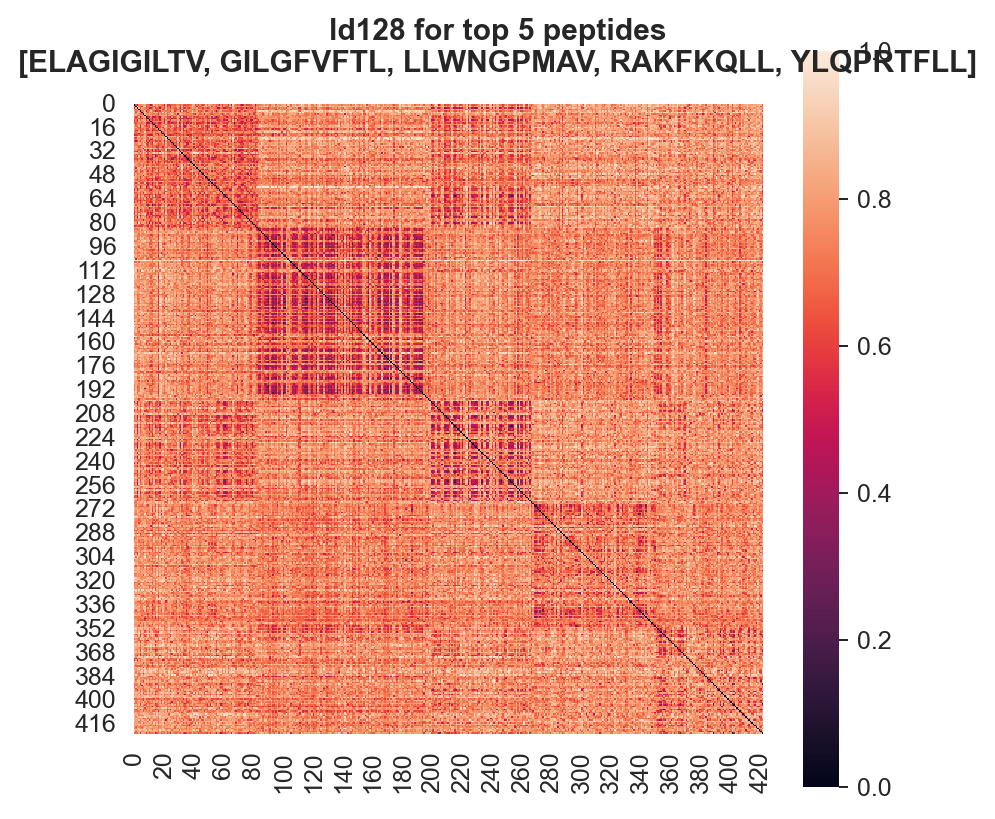

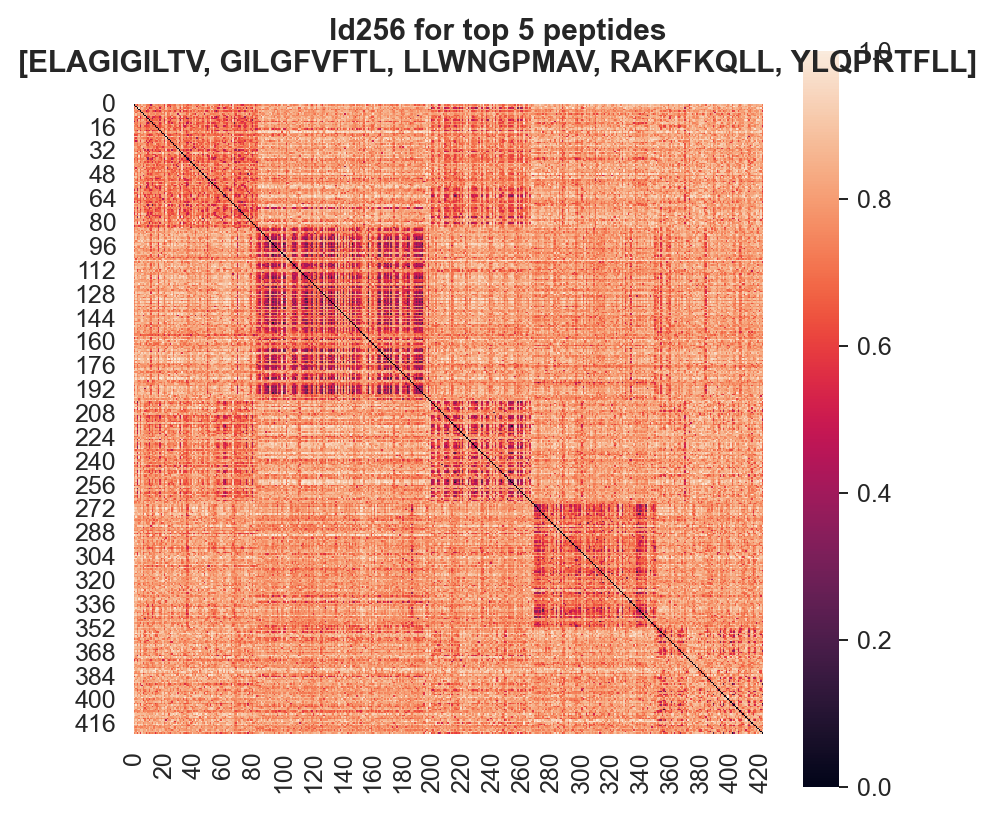

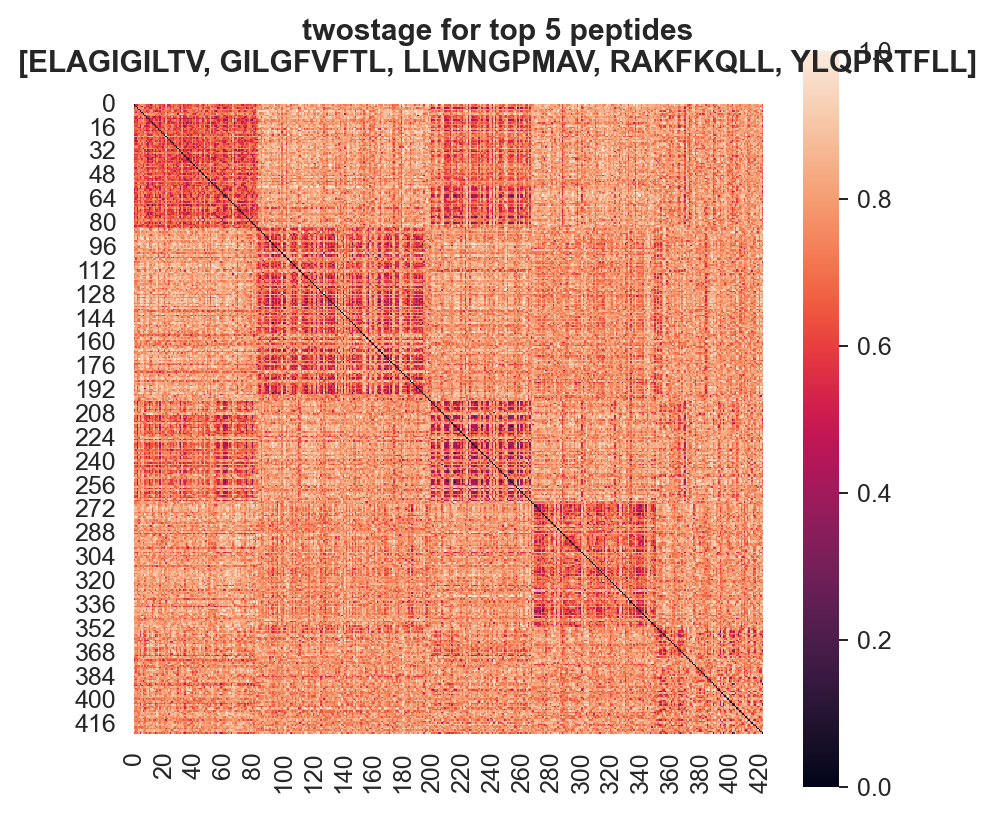

In [240]:
for title, matrix in zip(['ld128', 'ld256', 'twostage'],[da_ld128, da_ld256, da_ts128]):
    f,a = plt.subplots(1,1,figsize=(5,5))
    sns.heatmap(mms.fit_transform(matrix), square=True, ax = a)
    f.suptitle(f'{title} for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]',fontweight='semibold',  y=0.9)
    f.tight_layout()

## running graph etc

In [289]:
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_4500_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df = get_latent_df(model, top5peps)
dm_ts128, da_ts128, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 4500
total: 0.2232360578177835
reconstruction: 0.06748699668131114
kld: 0.0
triplet: 0.0
BCE: 0.15574906095925906
seq_accuracy: 0.9947810173034668
pos_accuracy: 0.9975979924201965
auc: 0.73572
auc_01: 0.63023
auc_01_real: 0.29744
precision: 0.44012
recall: 0.43294
accuracy: 0.81313
AP: 0.46103


In [290]:
resdf = []
label_key='peptide'
for threshold in np.linspace(.6,.7,50):
    G = nx.Graph(da_ts128)
    for i, node in enumerate(G.nodes()):
            G.nodes[node]['peptide'] = labels[i]
            
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()

    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            if label_key is not None:
                label1=tree_pruned.nodes[u]['peptide']
                label2=tree_pruned.nodes[v]['peptide']
            else:
                label1=dm_ts128.iloc[u]['peptide']
                label2=dm_ts128.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    
    nodes_to_remove=list(nx.isolates(tree_pruned))
    tree_pruned.remove_nodes_from(nodes_to_remove)
    resdf.append({'threshold':threshold, 'edges_removed':len(removed_edges),
                  'nodes_removed':len(nodes_to_remove), 
                  'err':np.array([x[3] for x in removed_edges]).mean()})
    # print('threshold= ',threshold, '\n',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were actually same-class')
resdf=pd.DataFrame(resdf).sort_values('err')
resdf.head(15)

,threshold,edges_removed,nodes_removed,err
49,0.700000,3,3,0.000000
48,0.697959,4,4,0.000000
47,0.695918,5,5,0.200000
45,0.691837,8,8,0.250000
33,0.667347,16,15,0.250000
41,0.683673,11,10,0.272727
40,0.681633,11,10,0.272727
39,0.679592,11,10,0.272727
34,0.669388,14,13,0.285714
35,0.671429,14,13,0.285714


In [296]:
# Now using a cleaner code version for this: 
from src.networkx_utils import create_mst_from_distance_matrix, prune_by_distance, betweenness_cut, get_cluster_stats_from_graph, plot_mst_spring, get_color_map
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
tree_pruned, removed_edges, removed_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)

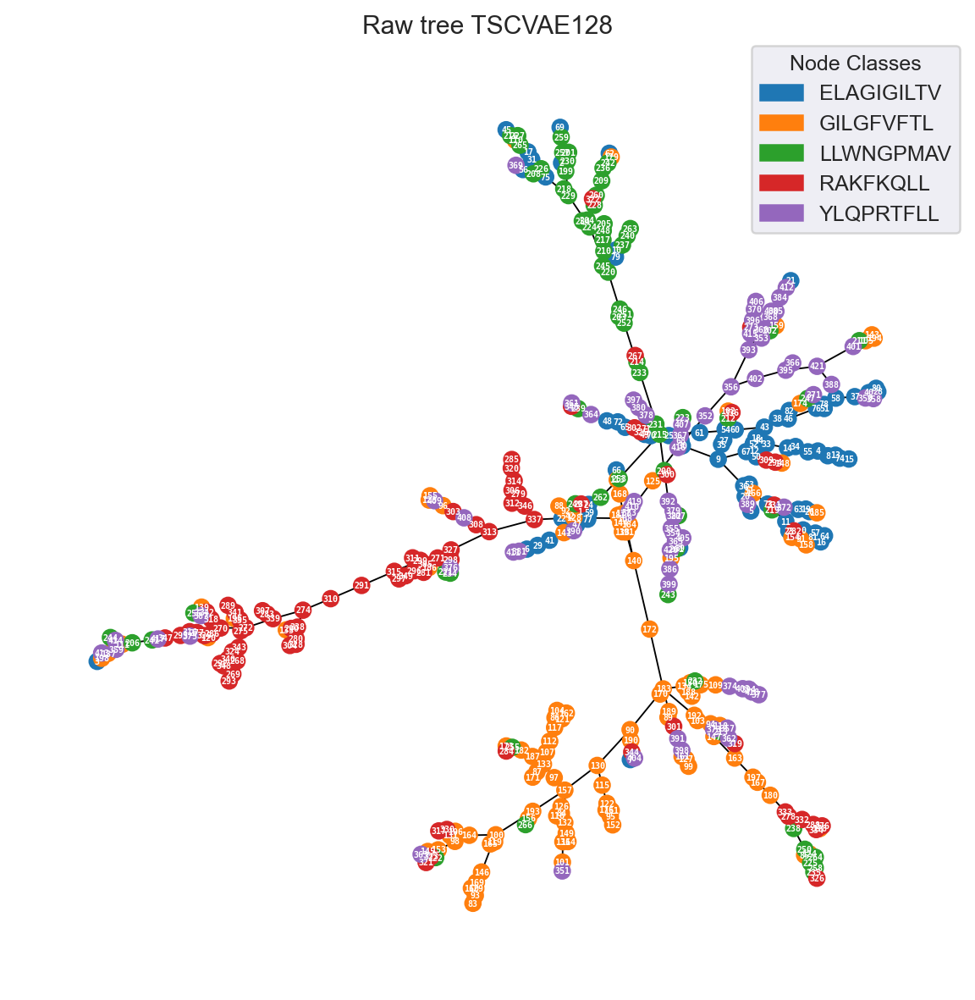

In [310]:
color_map = get_color_map(dist_matrix, 'peptide', 'tab10')
plot_mst_spring(tree, color_map, title='Raw tree TSCVAE128', threshold=1e-4, scale=.8, k=.045, seed=131)

In [365]:
sorted_edges = sorted(nx.edge_betweenness_centrality(tree_pruned).items(), key= lambda x: x[1], reverse=True)
print(sorted_edges[:10])
print('108', tree_pruned.nodes[108]) 
print('125', tree_pruned.nodes[125]) 
print('356', tree_pruned.nodes[356]) 
print('421', tree_pruned.nodes[421]) 
print('43', tree_pruned.nodes[43]) 
print('416', tree_pruned.nodes[416])

[((108, 125), 0.49631449631449637), ((125, 416), 0.49631449631449637), ((352, 416), 0.4961692547899445), ((352, 356), 0.4960724271069099), ((356, 402), 0.49123104295518094), ((395, 402), 0.49072269761924936), ((395, 421), 0.4896333861851104), ((388, 421), 0.4857844857844858), ((58, 388), 0.4850582781617265), ((58, 76), 0.479297031021169)]
108 {'peptide': 'GILGFVFTL', 'raw_index': 'VDJdb_24423'}
125 {'peptide': 'GILGFVFTL', 'raw_index': 'ITRAP_3605'}
356 {'peptide': 'YLQPRTFLL', 'raw_index': 'VDJdb_69365'}
421 {'peptide': 'YLQPRTFLL', 'raw_index': 'VDJdb_69361'}
43 {'peptide': 'ELAGIGILTV', 'raw_index': 'ITRAP_4044'}
416 {'peptide': 'YLQPRTFLL', 'raw_index': 'VDJdb_69752'}


### various checks 

In [381]:
tree_pruned.edges[(220, 79)]

{'weight': 0.30369943380355835}

In [398]:
sorted(nx.betweenness_centrality(tree_pruned, k = len(tree_pruned)).items(), key=lambda x: x[1], reverse=True)[:25]

[(108, 0.6197652496503071),
 (43, 0.5559934318555008),
 (356, 0.5292099981755154),
 (416, 0.5011372620568023),
 (421, 0.4998236331569665),
 (58, 0.49666119321291735),
 (125, 0.4963084595268503),
 (352, 0.49611384783798573),
 (395, 0.49259867420786957),
 (402, 0.4909444748525208),
 (388, 0.4853615520282187),
 (76, 0.482697804536885),
 (46, 0.47586206896551725),
 (183, 0.425603600316244),
 (140, 0.4168582375478927),
 (172, 0.3865353037766831),
 (215, 0.3548135984917594),
 (60, 0.33544973544973544),
 (61, 0.33264002919175334),
 (128, 0.3141640819801739),
 (337, 0.30907985160858725),
 (313, 0.2824302134646962),
 (33, 0.2769810861764885),
 (327, 0.26094994830627016),
 (90, 0.246718968558049)]

In [397]:
import math
sorted(nx.betweenness_centrality(tree_pruned, weight='weight').items(), key=lambda x: x[1], reverse=True)[:25]

[(108, 0.6197652496503071),
 (43, 0.5559934318555008),
 (356, 0.5292099981755154),
 (416, 0.5011372620568023),
 (421, 0.4998236331569665),
 (58, 0.49666119321291735),
 (125, 0.4963084595268503),
 (352, 0.49611384783798573),
 (395, 0.49259867420786957),
 (402, 0.4909444748525208),
 (388, 0.4853615520282187),
 (76, 0.482697804536885),
 (46, 0.47586206896551725),
 (183, 0.425603600316244),
 (140, 0.4168582375478927),
 (172, 0.3865353037766831),
 (215, 0.3548135984917594),
 (60, 0.33544973544973544),
 (61, 0.33264002919175334),
 (128, 0.3141640819801739),
 (337, 0.30907985160858725),
 (313, 0.2824302134646962),
 (33, 0.2769810861764885),
 (327, 0.26094994830627016),
 (90, 0.246718968558049)]

In [406]:
sorted(nx.edge_betweenness_centrality(tree_pruned, weight='weight').items(), key=lambda x: x[1], reverse=True)[:10]

[((108, 125), 41006.0),
 ((125, 416), 41006.0),
 ((352, 416), 40994.0),
 ((352, 356), 40986.0),
 ((356, 402), 40586.0),
 ((395, 402), 40544.0),
 ((395, 421), 40454.0),
 ((388, 421), 40136.0),
 ((58, 388), 40076.0),
 ((58, 76), 39600.0)]

In [403]:
tree_pruned.edges[(108,125)]

{'weight': 0.38782089948654175}

In [408]:
nx.edge_betweenness_centrality(tree_pruned)

{(0, 11): 0.024206920758644897,
 (0, 57): 0.009755389065733894,
 (0, 81): 0.009755389065733894,
 (1, 42): 0.009755389065733894,
 (1, 24): 0.014596773217462874,
 (2, 199): 0.0048897979932462695,
 (4, 55): 0.0048897979932462695,
 (5, 389): 0.0048897979932462695,
 (6, 29): 0.014596773217462874,
 (6, 381): 0.009755389065733894,
 (7, 344): 0.0048897979932462695,
 (8, 55): 0.01941395044843321,
 (8, 74): 0.009755389065733894,
 (8, 13): 0.0048897979932462695,
 (9, 67): 0.21483642173297346,
 (9, 36): 0.11498287360356327,
 (9, 35): 0.02897568414809794,
 (9, 30): 0.08431270500236018,
 (10, 79): 0.0048897979932462695,
 (11, 73): 0.05245639728398349,
 (11, 23): 0.009755389065733894,
 (11, 282): 0.014596773217462874,
 (12, 67): 0.0048897979932462695,
 (14, 55): 0.02897568414809794,
 (14, 33): 0.038440590164728096,
 (14, 34): 0.0048897979932462695,
 (15, 74): 0.0048897979932462695,
 (16, 81): 0.0048897979932462695,
 (17, 31): 0.0048897979932462695,
 (18, 52): 0.0048897979932462695,
 (19, 63): 0.00488

In [461]:
def get_nodes_stats(G, node):
    neighbours = list(nx.neighbors(G, node))
    edges = [tuple(sorted((node, target_node))) for target_node in nx.neighbors(tree_pruned, node)]
    edge_weights = {edge:G.edges[edge]['weight'] for edge in edges}
    centralities = nx.edge_betweenness_centrality(G) 
    filtered_centralities = {k:v for k,v in centralities.items() if k in edges}
    return {'n_neighbours': len(neighbours), 'neighbours':neighbours,
            'max_dist':max(edge_weights.values()), 'sum_dist':sum(edge_weights.values()), 'mean_dist':np.mean(list(edge_weights.values())), 
            'max_edge_centrality':max(filtered_centralities.values()), 
            'sum_edge_centrality':sum(filtered_centralities.values()), 
            'mean_edge_centrality':np.mean(list(filtered_centralities.values()))}

In [474]:
for f in sorted_nodes[:5]:
    print(f)
    print(get_nodes_stats(tree_pruned, f[0]))
    print('\n\n')

(215, 0.6288640595903165)
{'n_neighbours': 4, 'neighbours': [61, 200, 253, 233], 'max_dist': 0.3934003710746765, 'sum_dist': 0.9257580637931824, 'mean_dist': 0.2314395159482956, 'max_edge_centrality': 0.33204633204633205, 'sum_edge_centrality': 0.7110298834436766, 'mean_edge_centrality': 0.17775747086091914}



(43, 0.6127250155183116)
{'n_neighbours': 4, 'neighbours': [33, 38, 46, 60], 'max_dist': 0.4766712188720703, 'sum_dist': 1.85118168592453, 'mean_dist': 0.4627954214811325, 'max_edge_centrality': 0.4754723375413031, 'sum_edge_centrality': 1.1114123527916633, 'mean_edge_centrality': 0.2778530881979158}



(60, 0.5022346368715084)
{'n_neighbours': 2, 'neighbours': [43, 61], 'max_dist': 0.47619497776031494, 'sum_dist': 0.7965748310089111, 'mean_dist': 0.39828741550445557, 'max_edge_centrality': 0.33763813074157906, 'sum_edge_centrality': 0.6724924655959139, 'mean_edge_centrality': 0.33624623279795696}



(61, 0.5018001241464929)
{'n_neighbours': 2, 'neighbours': [60, 215], 'max_dist

In [482]:
cut_threshold=0.4
tree_cut = tree_pruned.copy()
edge_betweenness = nx.edge_betweenness_centrality(tree_cut)
node_betweenness = nx.betweenness_centrality(tree_cut)
weighted_edge_betweenness = {k:tree_cut.edges[k]['weight']*v for k,v in edge_betweenness.items() if v > cut_threshold}
weighted_node_betweenness = {k:get_nodes_stats(tree_cut, k)['mean_dist']*v for k,v in node_betweenness.items() if v > cut_threshold}
sorted_edges = sorted(edge_betweenness.items(), key=lambda item: item[1], reverse=True)
sorted_nodes = sorted(node_betweenness.items(), key=lambda item: item[1], reverse=True)

sorted_weighted_edges = sorted(weighted_edge_betweenness.items(), key=lambda item: item[1], reverse=True)
sorted_weighted_nodes = sorted(weighted_node_betweenness.items(), key=lambda item: item[1], reverse=True)

In [487]:
sorted_edges[:10]

[((108, 125), 0.49631449631449637),
 ((125, 416), 0.49631449631449637),
 ((352, 416), 0.4961692547899445),
 ((352, 356), 0.4960724271069099),
 ((356, 402), 0.49123104295518094),
 ((395, 402), 0.49072269761924936),
 ((395, 421), 0.4896333861851104),
 ((388, 421), 0.4857844857844858),
 ((58, 388), 0.4850582781617265),
 ((58, 76), 0.479297031021169)]

In [488]:
sorted_weighted_edges[:10]

[((352, 356), 0.24200680980890607),
 ((125, 416), 0.24034731042472973),
 ((58, 388), 0.2239188632016735),
 ((43, 46), 0.221088531309595),
 ((352, 416), 0.2182368391951428),
 ((356, 402), 0.21206080625696144),
 ((58, 76), 0.20848963870425755),
 ((108, 125), 0.19248113438889788),
 ((108, 140), 0.1590184113051908),
 ((46, 76), 0.1483110218020624)]

In [490]:
sorted_nodes[:5]

[(108, 0.6197652496503071),
 (43, 0.5559934318555008),
 (356, 0.5292099981755154),
 (416, 0.5011372620568023),
 (421, 0.4998236331569665)]

In [489]:
sorted_weighted_nodes[:5]

[(43, 0.2573112146363078),
 (416, 0.24651607375612913),
 (58, 0.23509877374672014),
 (108, 0.23252254008347845),
 (352, 0.23011974277036987)]

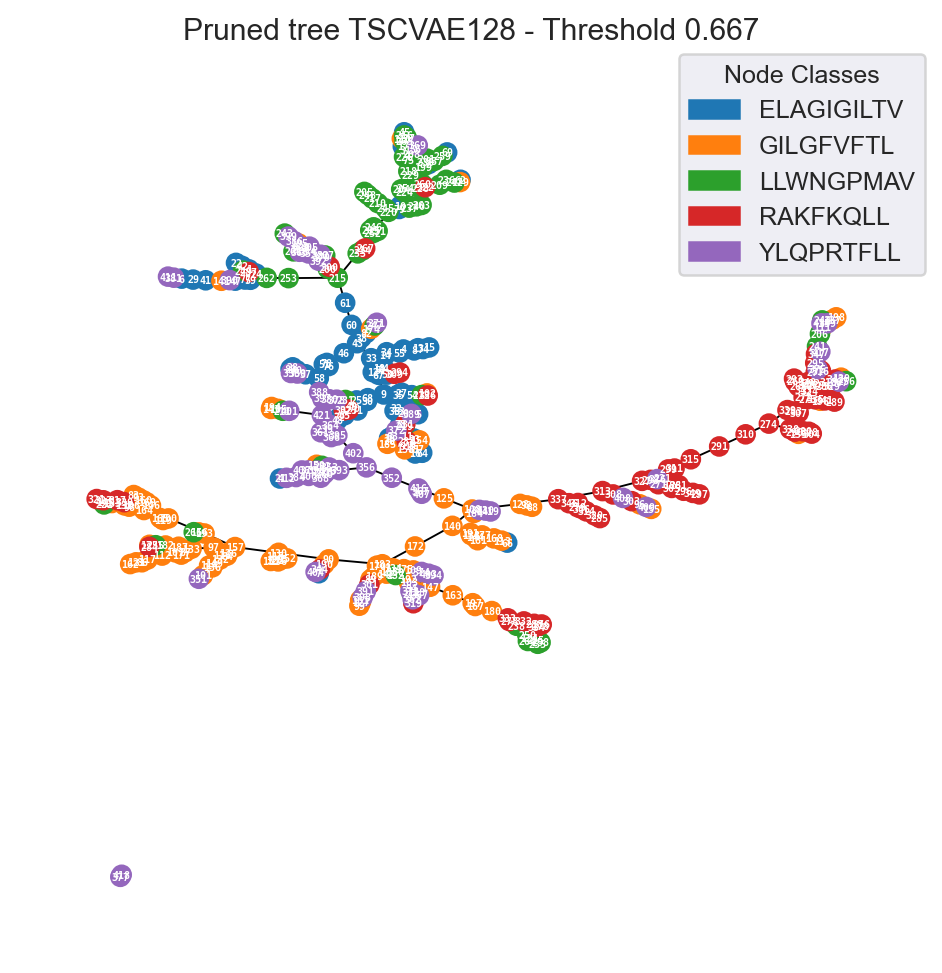

In [333]:
plot_mst_spring(tree_pruned, color_map, title='Pruned tree TSCVAE128 - Threshold 0.667',
                figsize=(6.5,6.5), iterations=500, threshold=1e-4, scale=2.5, k=0.08, seed=131)


### betweenness cuts debug and logs

In [579]:
from src.networkx_utils import betweenness_cut2

tree_cut_x, clusters_x, edges_cut_x, nodes_cut_x = betweenness_cut2(tree_pruned, 0.5, which='node', weighted=False, verbose=2)

		edges, nodes
before cutting:	405,	407
after cutting:	390,	400
N components before cutting:	 2
N components after cutting:	 10

Edges removed:
[((108, 125), 0.49631449631449637),
 ((125, 416), 0.49631449631449637),
 ((352, 416), 0.4961692547899445),
 ((352, 356), 0.4960724271069099),
 ((356, 402), 0.49123104295518094),
 ((43, 46), 0.4754723375413031),
 ((108, 140), 0.40783820094164924),
 ((43, 60), 0.33763813074157906),
 ((108, 128), 0.3146899698623837),
 ((33, 43), 0.2740949637501362),
 ((356, 393), 0.07080524321903632),
 ((38, 43), 0.024206920758644897),
 ((108, 383), 0.014596773217462874),
 ((367, 416), 0.009755389065733894),
 ((108, 184), 0.0048897979932462695)]

Nodes removed:
[(108, 0.6197652496503071),
 (43, 0.5559934318555008),
 (356, 0.5292099981755154),
 (416, 0.5011372620568023),
 (125, 0.4963084595268503),
 (352, 0.49611384783798573),
 (184, 0.0)]


In [580]:
tree_cut_y, clusters_y, edges_cut_y, nodes_cut_y = betweenness_cut(tree_pruned, 0.5, which='node', weighted=False, verbose=True)

		edges, nodes
before cutting:	405,	407
after cutting:	390,	400
N components before cutting:	 2
N components after cutting:	 10

Edges removed:
[((108, 125), 0.49631449631449637),
 ((125, 416), 0.49631449631449637),
 ((352, 416), 0.4961692547899445),
 ((352, 356), 0.4960724271069099),
 ((356, 402), 0.49123104295518094),
 ((43, 46), 0.4754723375413031),
 ((108, 140), 0.40783820094164924),
 ((43, 60), 0.33763813074157906),
 ((108, 128), 0.3146899698623837),
 ((33, 43), 0.2740949637501362),
 ((356, 393), 0.07080524321903632),
 ((38, 43), 0.024206920758644897),
 ((108, 383), 0.014596773217462874),
 ((367, 416), 0.009755389065733894),
 ((108, 184), 0.0048897979932462695)]

Nodes removed:
[(108, 0.6197652496503071),
 (43, 0.5559934318555008),
 (356, 0.5292099981755154),
 (416, 0.5011372620568023),
 (125, 0.4963084595268503),
 (352, 0.49611384783798573),
 (184, 0.0)]


In [555]:
from src.networkx_utils import betweenness_cut2

tree_cut_x, clusters_x, edges_cut_x, nodes_cut_x = betweenness_cut2(tree_pruned, 0.21, which='edge', weighted=True, verbose=1)


		edges, nodes
before cutting:	405,	407
after cutting:	399,	406
N components before cutting:	 2
N components after cutting:	 7

Edges removed:
[((352, 356), 0.24200680980890607),
 ((125, 416), 0.24034731042472973),
 ((58, 388), 0.2239188632016735),
 ((43, 46), 0.221088531309595),
 ((352, 416), 0.2182368391951428),
 ((356, 402), 0.21206080625696144)]

Nodes removed:
[352]


In [513]:
tree_cut, clusters, edges_cut, nodes_cut = betweenness_cut(tree_pruned, 0.21, which='edge', weighted=True, verbose=True)
print('Stats\n')
print([(x['cluster_size'], x['purity'], x['majority_label']) for x in clusters])

		edges, nodes
before cutting:	405,	407
after cutting:	399,	406
N components before cutting:	 2
N components after cutting:	 7

Edges removed:
[((352, 356), 0.24200680980890607),
 ((125, 416), 0.24034731042472973),
 ((58, 388), 0.2239188632016735),
 ((43, 46), 0.221088531309595),
 ((352, 416), 0.2182368391951428),
 ((356, 402), 0.21206080625696144)]

Nodes removed:
[(352, 0.49611384783798573)]
Stats

[(203, 0.46798029556650245, 'GILGFVFTL'), (161, 0.43478260869565216, 'ELAGIGILTV'), (16, 0.75, 'YLQPRTFLL'), (11, 0.8181818181818182, 'ELAGIGILTV'), (10, 0.6, 'YLQPRTFLL'), (3, 1.0, 'YLQPRTFLL'), (2, 1.0, 'YLQPRTFLL')]


In [551]:
tree_cut, clusters, edges_cut, nodes_cut = betweenness_cut(tree_pruned, 0.48, which='edge', weighted=False, verbose=True)
print('Stats\n')
print([(x['cluster_size'], x['purity'], x['majority_label']) for x in clusters])

		edges, nodes
before cutting:	405,	407
after cutting:	396,	403
N components before cutting:	 2
N components after cutting:	 7

Edges removed:
[((108, 125), 0.49631449631449637),
 ((125, 416), 0.49631449631449637),
 ((352, 416), 0.4961692547899445),
 ((352, 356), 0.4960724271069099),
 ((356, 402), 0.49123104295518094),
 ((395, 402), 0.49072269761924936),
 ((395, 421), 0.4896333861851104),
 ((388, 421), 0.4857844857844858),
 ((58, 388), 0.4850582781617265)]

Nodes removed:
[(125, 0.4963084595268503),
 (352, 0.49611384783798573),
 (402, 0.4909444748525208),
 (388, 0.4853615520282187)]
Stats

[(202, 0.46534653465346537, 'GILGFVFTL'), (172, 0.45930232558139533, 'ELAGIGILTV'), (16, 0.75, 'YLQPRTFLL'), (6, 0.5, 'GILGFVFTL'), (3, 1.0, 'YLQPRTFLL'), (2, 1.0, 'YLQPRTFLL'), (2, 1.0, 'YLQPRTFLL')]


In [538]:
tree_cut_0, clusters_0, edges_cut_0, nodes_cut_0 = betweenness_cut(tree_pruned.subgraph(clusters[0]['members']), 0.21/2, which='edge', weighted=True, verbose=True)
tree_cut_1, clusters_1, edges_cut_1, nodes_cut_1 = betweenness_cut(tree_pruned.subgraph(clusters[1]['members']), 0.21/2, which='edge', weighted=True, verbose=True)

		edges, nodes
before cutting:	202,	203
after cutting:	189,	202
N components before cutting:	 1
N components after cutting:	 13

Edges removed:
[((128, 337), 0.19959635216044502),
 ((108, 140), 0.19134909352668758),
 ((299, 315), 0.16469470455036833),
 ((274, 310), 0.13965411734617042),
 ((299, 327), 0.13756859372873012),
 ((108, 128), 0.13279666169436394),
 ((272, 339), 0.1229886280375737),
 ((313, 337), 0.11985882797375172),
 ((172, 183), 0.11915463824007724),
 ((313, 327), 0.11584105083711356),
 ((130, 157), 0.11262610914160298),
 ((274, 339), 0.11032088064643888),
 ((291, 310), 0.11030635606752445)]

Nodes removed:
[(310, 0.3534801241318162)]
		edges, nodes
before cutting:	160,	161
after cutting:	152,	159
N components before cutting:	 1
N components after cutting:	 7

Edges removed:
[((43, 60), 0.2375059423239335),
 ((33, 43), 0.2330803832652406),
 ((33, 67), 0.21940117242358487),
 ((60, 61), 0.1601401781998806),
 ((9, 67), 0.156899254468287),
 ((61, 215), 0.1251038372146417),
 ((2

In [546]:
list_nodes = [0, 11, 124, 13,25]

[x for x in tree_pruned.edges() if any([x[0] in list_nodes or x[1] in list_nodes])]

[(0, 11),
 (0, 57),
 (0, 81),
 (8, 13),
 (11, 73),
 (11, 23),
 (11, 282),
 (25, 231),
 (25, 30),
 (124, 250)]

# Iterative cuts

In [289]:
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_4500_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df = get_latent_df(model, top5peps)
dm_ts128, da_ts128, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 4500
total: 0.2232360578177835
reconstruction: 0.06748699668131114
kld: 0.0
triplet: 0.0
BCE: 0.15574906095925906
seq_accuracy: 0.9947810173034668
pos_accuracy: 0.9975979924201965
auc: 0.73572
auc_01: 0.63023
auc_01_real: 0.29744
precision: 0.44012
recall: 0.43294
accuracy: 0.81313
AP: 0.46103


## Iterative test

In [811]:
# Now using a cleaner code version for this: 
from src.networkx_utils import create_mst_from_distance_matrix, prune_by_distance, betweenness_cut, get_cluster_stats_from_graph, plot_mst_spring, get_color_map
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
tree_pruned, removed_edges, removed_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)

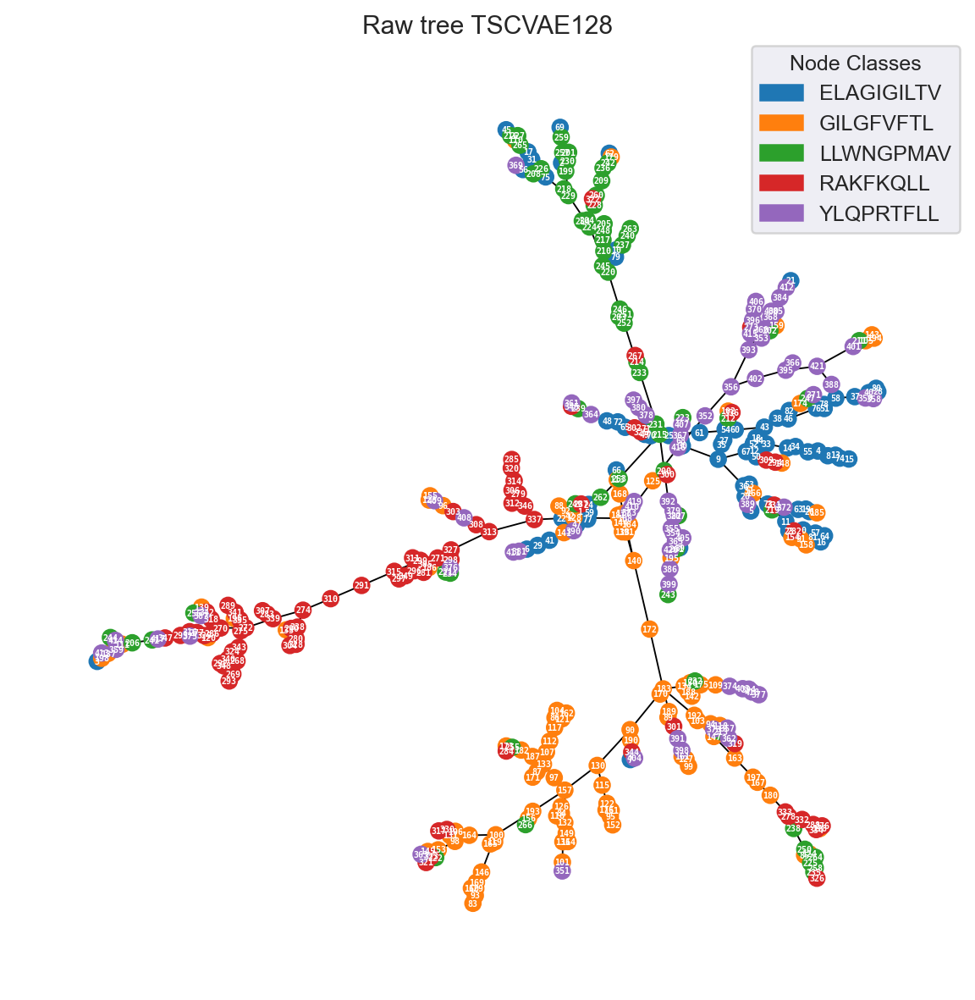

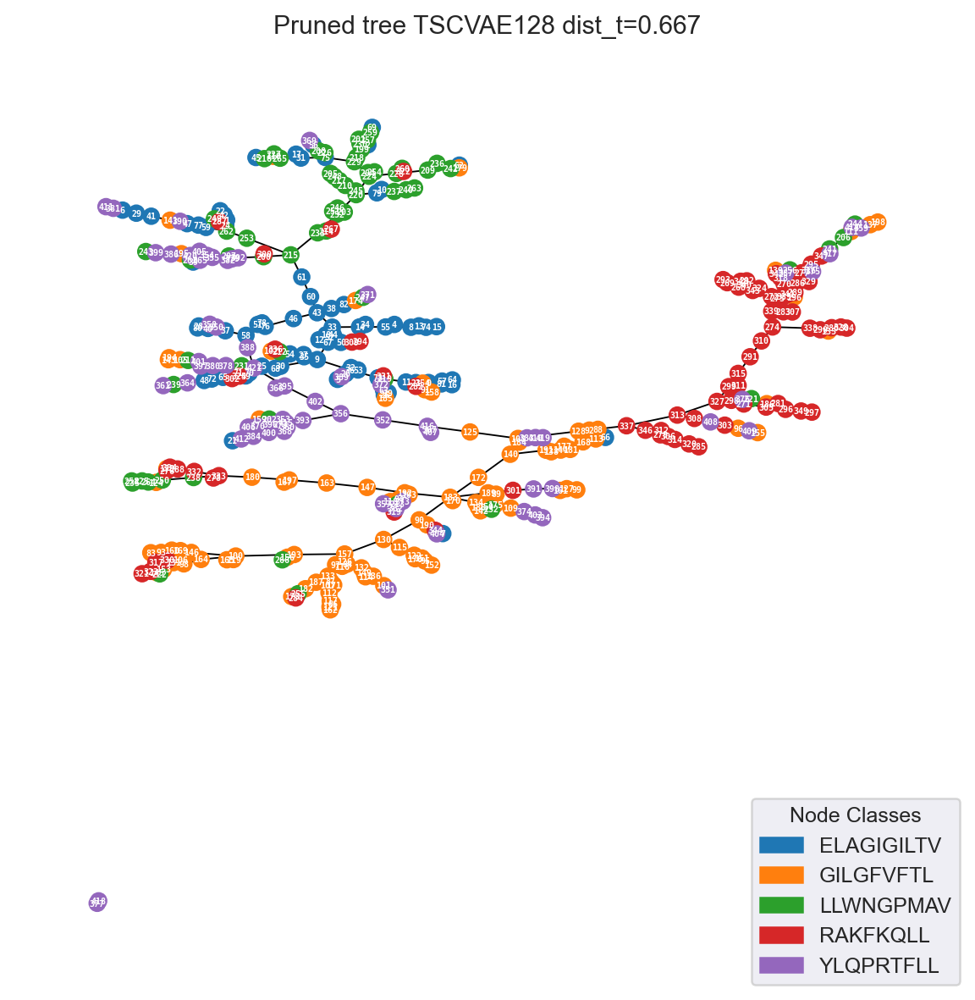

In [585]:
color_map = get_color_map(dist_matrix, 'peptide', 'tab10')
plot_mst_spring(tree, color_map, title='Raw tree TSCVAE128', threshold=1e-4, scale=.8, k=.045, seed=131)
plot_mst_spring(tree_pruned, color_map, title='Pruned tree TSCVAE128 dist_t=0.667', threshold=1e-4, scale=.8, k=.045, seed=131)

In [812]:
tree_cut, clusters, edges_cut, nodes_cut = betweenness_cut(tree_pruned, 0.21, which='edge', weighted=True, verbose=2)
print('Stats\n')
print([(x['cluster_size'], x['purity'], x['majority_label']) for x in clusters])

		edges, nodes
before cutting:	405,	407
after cutting:	399,	406
N components before cutting:	 2
N components after cutting:	 7

Edges removed:
[((352, 356), 0.24200680980890607),
 ((125, 416), 0.24034731042472973),
 ((58, 388), 0.2239188632016735),
 ((43, 46), 0.221088531309595),
 ((352, 416), 0.2182368391951428),
 ((356, 402), 0.21206080625696144)]

Nodes removed:
[(352, 0.49611384783798573)]
Stats

[(203, 0.46798029556650245, 'GILGFVFTL'), (161, 0.43478260869565216, 'ELAGIGILTV'), (16, 0.75, 'YLQPRTFLL'), (11, 0.8181818181818182, 'ELAGIGILTV'), (10, 0.6, 'YLQPRTFLL'), (3, 1.0, 'YLQPRTFLL'), (2, 1.0, 'YLQPRTFLL')]


In [816]:
sorted(nx.edge_betweenness_centrality(tree_cut).items(), key=lambda x: x[1], reverse=True)[:10]

[((172, 183), 0.12494070425104907),
 ((140, 172), 0.12479474548440066),
 ((108, 140), 0.12238642583470169),
 ((108, 128), 0.1196861886517059),
 ((128, 337), 0.11800766283524904),
 ((313, 337), 0.11246122970260901),
 ((313, 327), 0.10633096150337529),
 ((90, 183), 0.10333880678708264),
 ((90, 130), 0.09786535303776683),
 ((299, 327), 0.09428936325488049)]

In [813]:
tree_cut_0, clusters_0, edges_cut_0, nodes_cut_0 = betweenness_cut(tree_pruned.subgraph(clusters[0]['members']), 0.21/2, which='edge', weighted=True, verbose=2)
tree_cut_1, clusters_1, edges_cut_1, nodes_cut_1 = betweenness_cut(tree_pruned.subgraph(clusters[1]['members']), 0.21/2, which='edge', weighted=True, verbose=2)

		edges, nodes
before cutting:	202,	203
after cutting:	189,	202
N components before cutting:	 1
N components after cutting:	 13

Edges removed:
[((128, 337), 0.19959635216044502),
 ((108, 140), 0.19134909352668758),
 ((299, 315), 0.16469470455036833),
 ((274, 310), 0.13965411734617042),
 ((299, 327), 0.13756859372873012),
 ((108, 128), 0.13279666169436394),
 ((272, 339), 0.1229886280375737),
 ((313, 337), 0.11985882797375172),
 ((172, 183), 0.11915463824007724),
 ((313, 327), 0.11584105083711356),
 ((130, 157), 0.11262610914160298),
 ((274, 339), 0.11032088064643888),
 ((291, 310), 0.11030635606752445)]

Nodes removed:
[(310, 0.3534801241318162)]
		edges, nodes
before cutting:	160,	161
after cutting:	152,	159
N components before cutting:	 1
N components after cutting:	 7

Edges removed:
[((43, 60), 0.2375059423239335),
 ((33, 43), 0.2330803832652406),
 ((33, 67), 0.21940117242358487),
 ((60, 61), 0.1601401781998806),
 ((9, 67), 0.156899254468287),
 ((61, 215), 0.1251038372146417),
 ((2

[((180, 333), 0.18207852261214608),
 ((147, 192), 0.17477785547574362),
 ((163, 197), 0.17101859369520414),
 ((180, 197), 0.15133341490212135),
 ((183, 192), 0.1500365779898261),
 ((147, 163), 0.14916424428002312),
 ((134, 183), 0.11613222502045713),
 ((333, 238), 0.10127458515140297),
 ((192, 94), 0.09765916924692145),
 ((391, 301), 0.09627699178490935)]


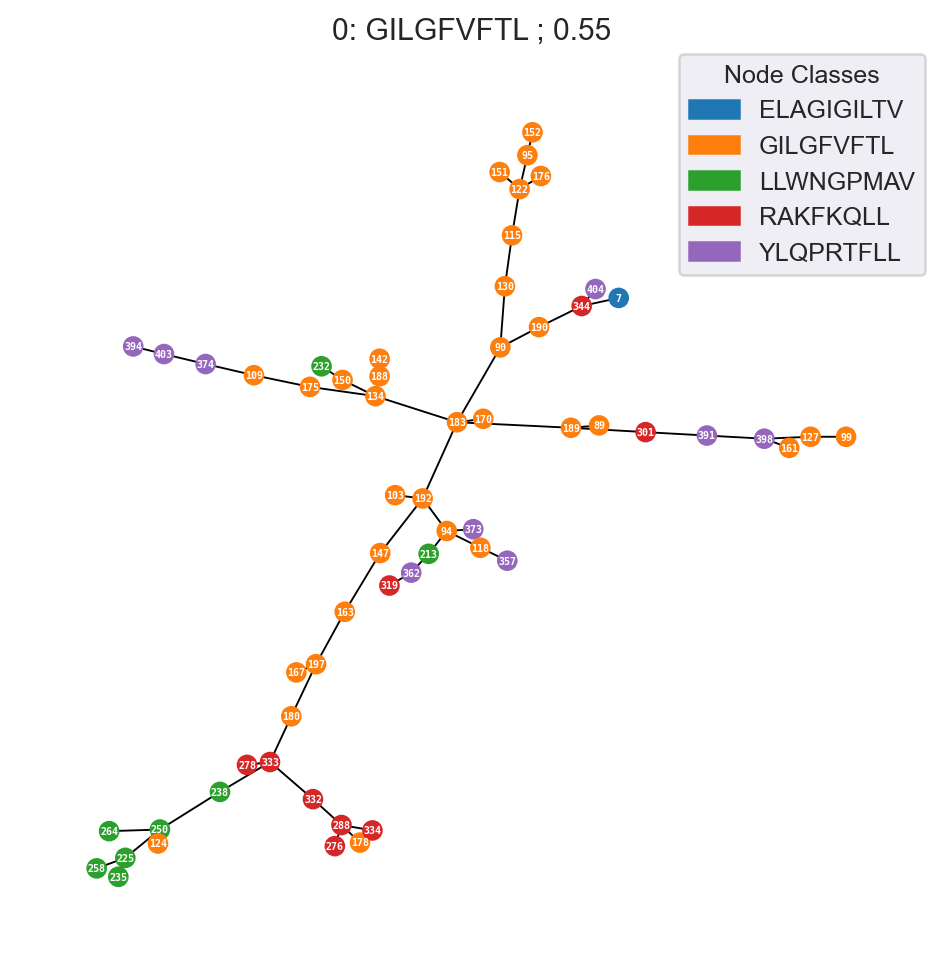

[((157, 97), 0.21392358220582977),
 ((133, 97), 0.187835395060459),
 ((164, 98), 0.13340079133759816),
 ((157, 193), 0.1308304143106353),
 ((164, 100), 0.10760111460301967),
 ((107, 112), 0.09982154724445749),
 ((133, 187), 0.09367926709636508),
 ((193, 100), 0.08707123658482838),
 ((133, 107), 0.08648530495155751),
 ((182, 255), 0.07796787355477672)]


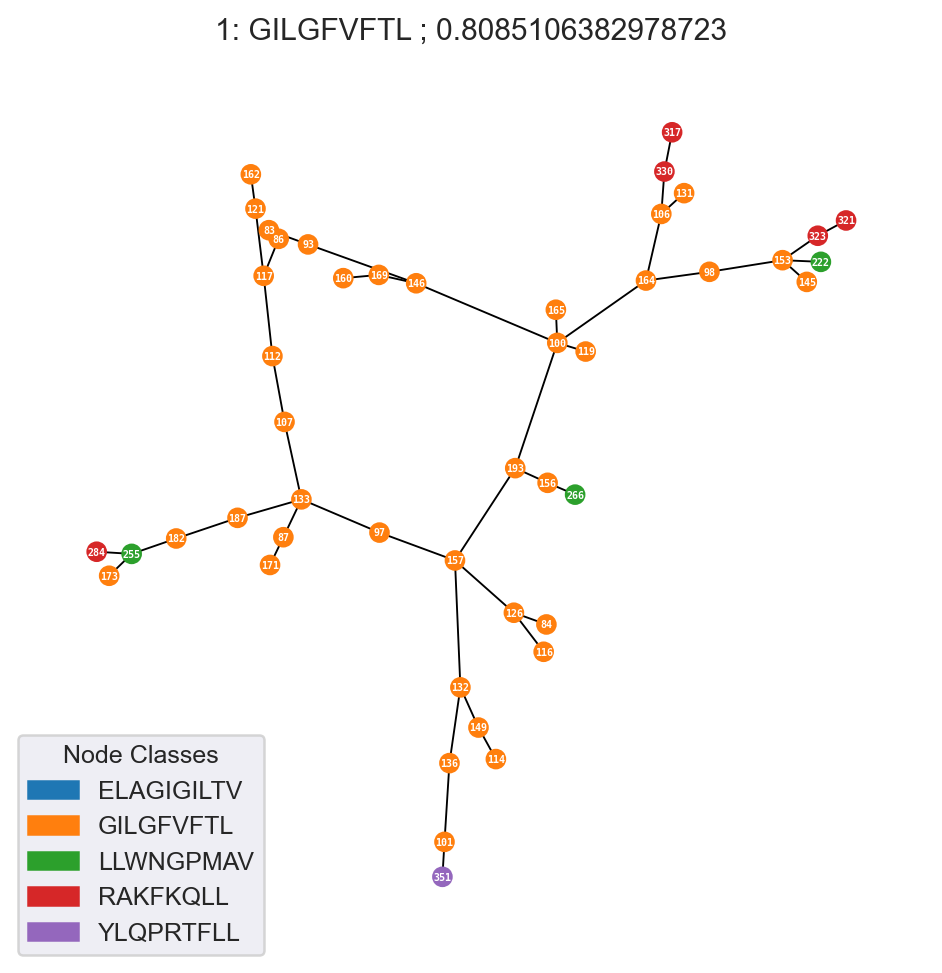

[((277, 295), 0.22160598446452429),
 ((270, 272), 0.22027088006337484),
 ((295, 347), 0.20840900663345577),
 ((347, 241), 0.1950620863172743),
 ((270, 277), 0.16993057197994654),
 ((206, 111), 0.16379007271357945),
 ((270, 318), 0.13538537517426505),
 ((272, 343), 0.12406999799940321),
 ((272, 335), 0.114075930156405),
 ((359, 111), 0.10269792761121477)]


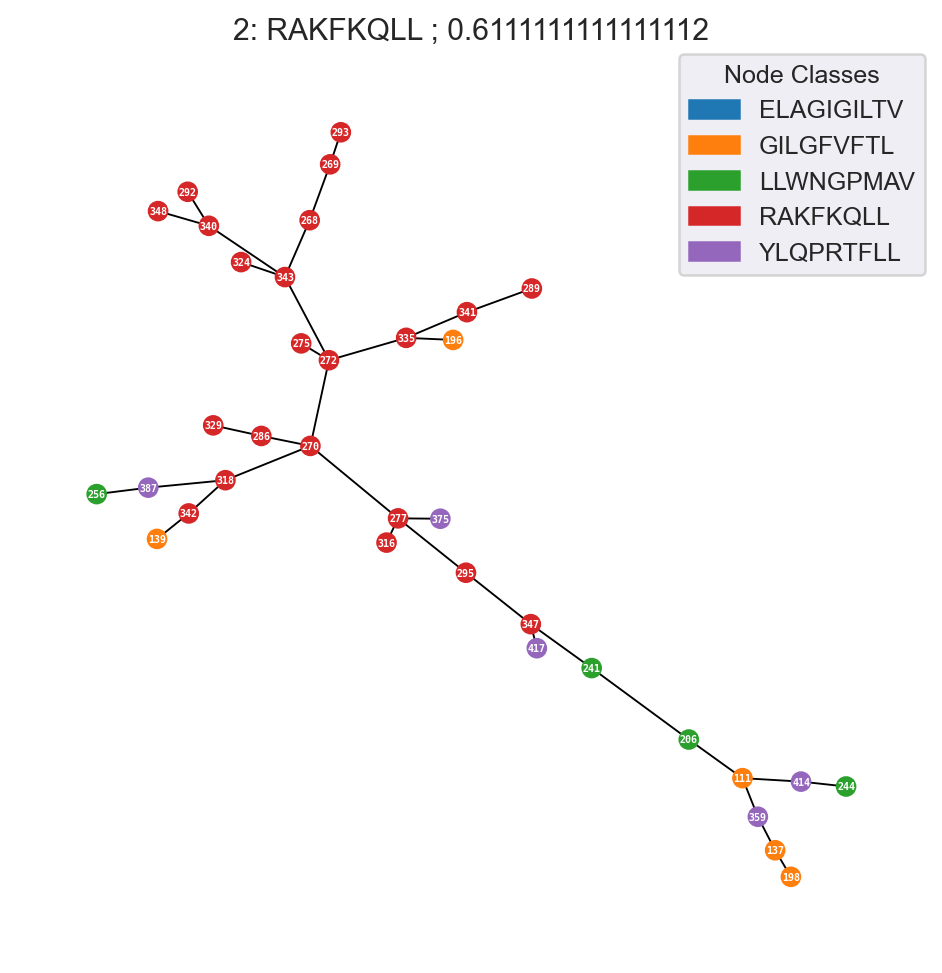

[((327, 271), 0.21393219340931283),
 ((298, 376), 0.19470820426940919),
 ((327, 298), 0.19434650594537908),
 ((271, 305), 0.1794449676166881),
 ((296, 305), 0.16666907397183503),
 ((296, 349), 0.1408584789796309),
 ((376, 221), 0.09984902902082964),
 ((297, 349), 0.09032547473907471),
 ((281, 186), 0.08529929681257768),
 ((271, 186), 0.06535281268033115)]


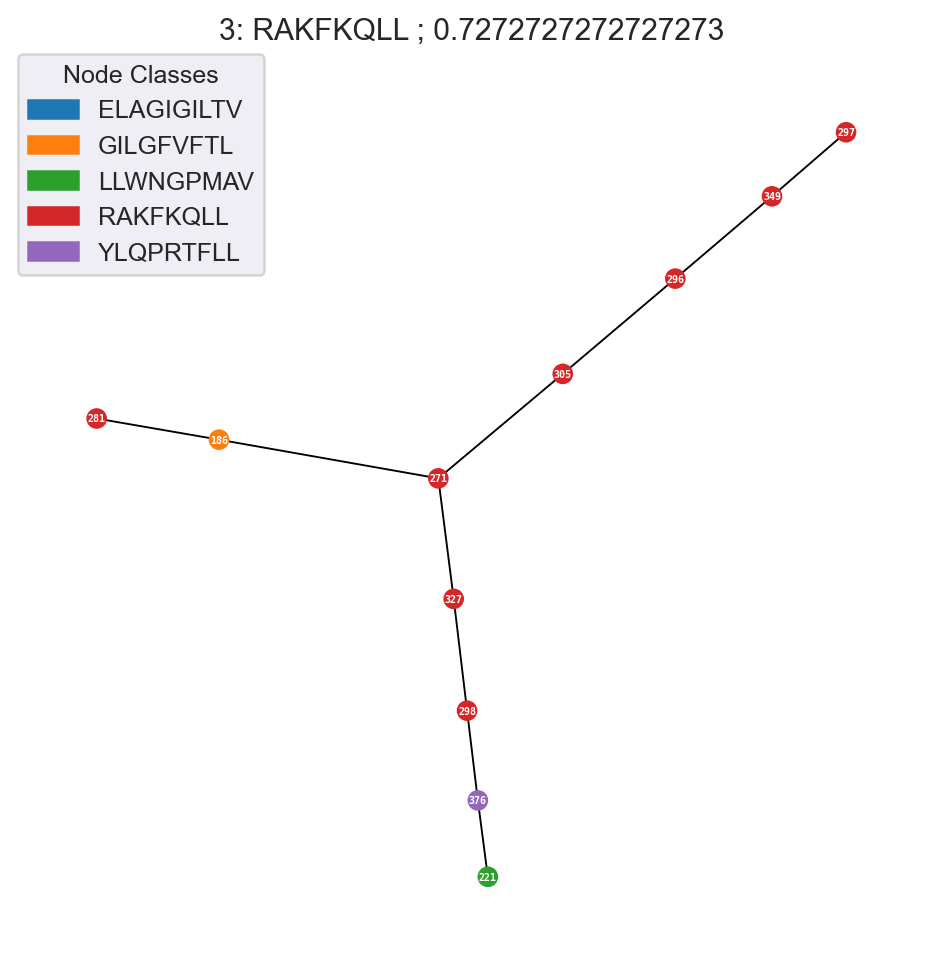

[((177, 191), 0.21754337946573893),
 ((168, 113), 0.16849619547526043),
 ((168, 177), 0.13993096748987835),
 ((138, 191), 0.12729132175445557),
 ((144, 191), 0.12453365325927734),
 ((144, 181), 0.10184988975524903),
 ((66, 113), 0.0999906063079834),
 ((140, 191), 0.06816088358561198),
 ((172, 140), 0.03597129583358765)]


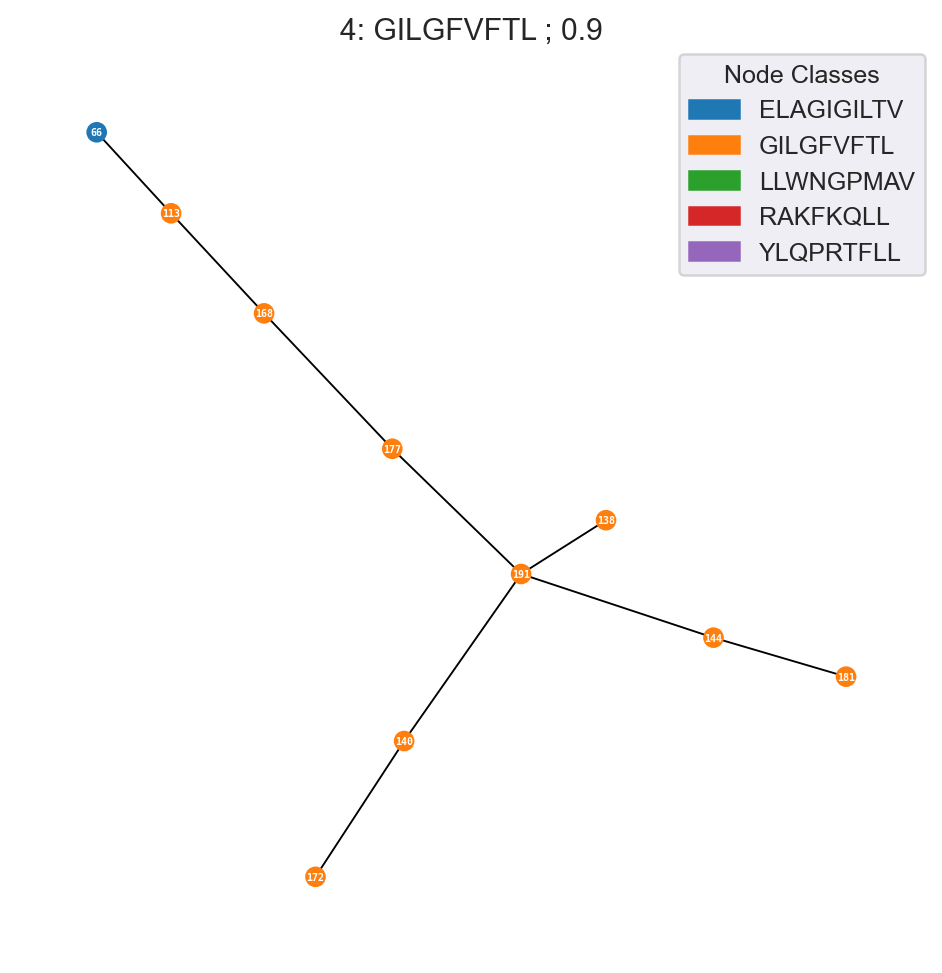

[((279, 346), 0.30418657830783297),
 ((314, 279), 0.221407094172069),
 ((306, 279), 0.14020708203315735),
 ((337, 346), 0.1314847767353058),
 ((320, 314), 0.1283180798803057),
 ((320, 285), 0.09810979664325714),
 ((312, 346), 0.035591140389442444)]


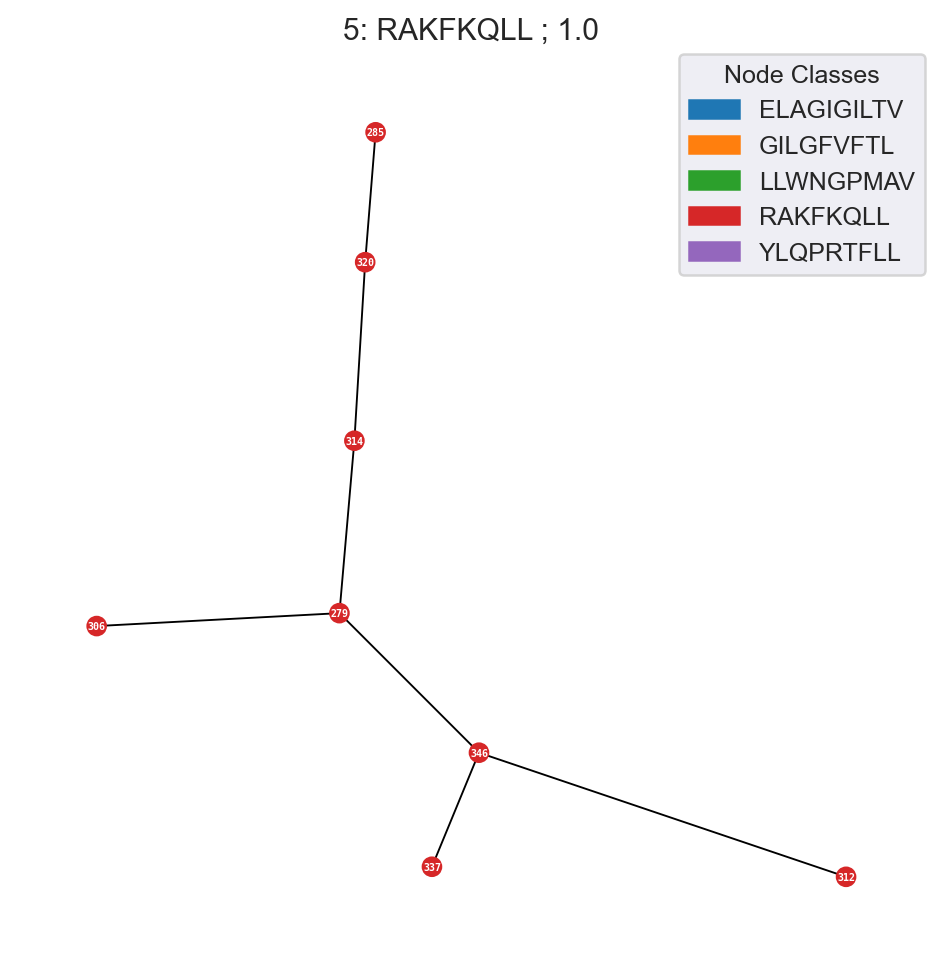

[((303, 408), 0.34936353138514925),
 ((96, 303), 0.3244843823569161),
 ((96, 409), 0.30064509028480163),
 ((308, 408), 0.27062066963740755),
 ((409, 155), 0.17817466599600654),
 ((308, 313), 0.16661688259669713)]


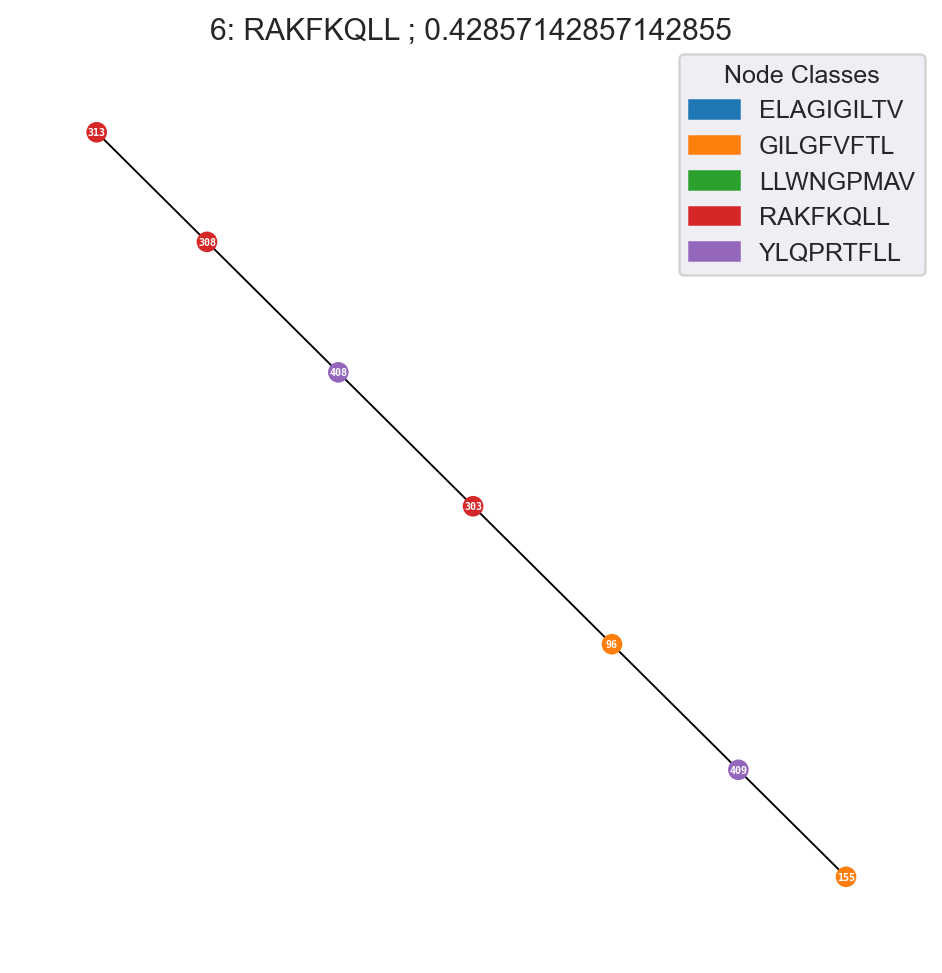

[((290, 338), 0.28396529810769217),
 ((338, 280), 0.18809311730521064),
 ((290, 135), 0.1835810627256121),
 ((328, 280), 0.16735976082938056),
 ((304, 280), 0.08244482108524867),
 ((274, 338), 0.04615926742553711)]


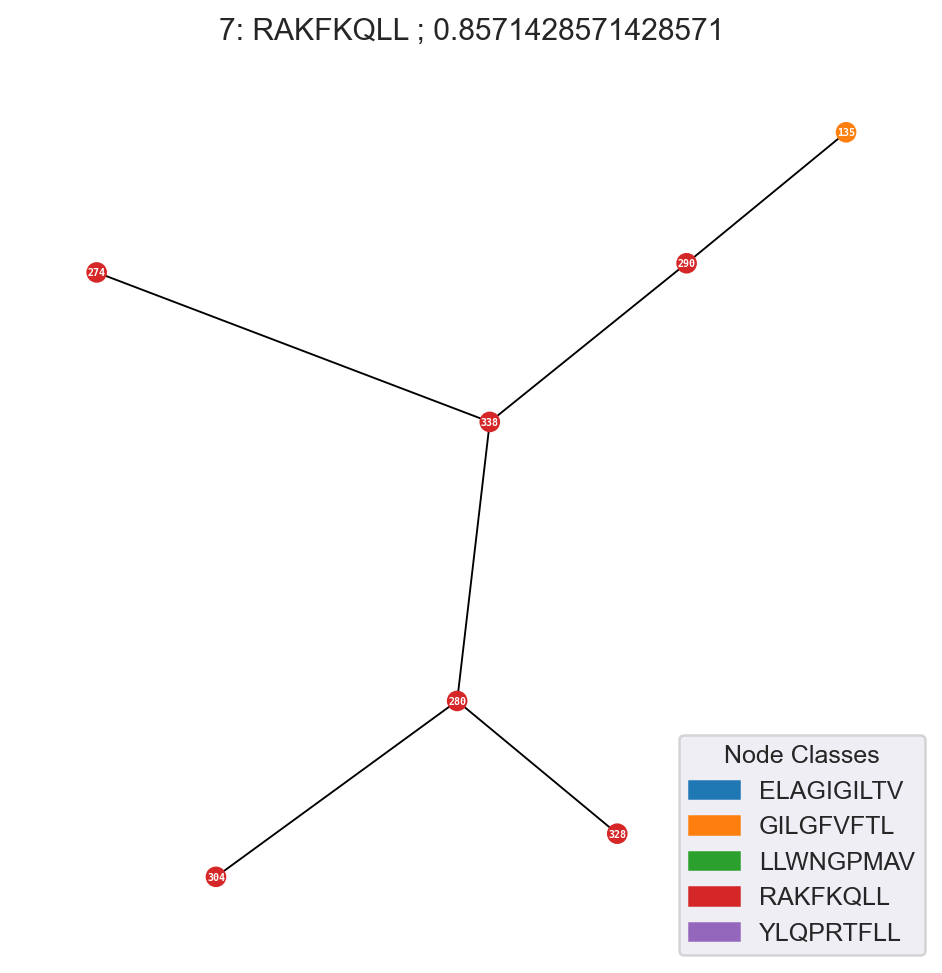

[((108, 383), 0.35284016132354734),
 ((410, 383), 0.3293134371439616),
 ((419, 410), 0.18323709567387897),
 ((108, 125), 0.12927363316218057),
 ((108, 184), 0.07779945929845174)]


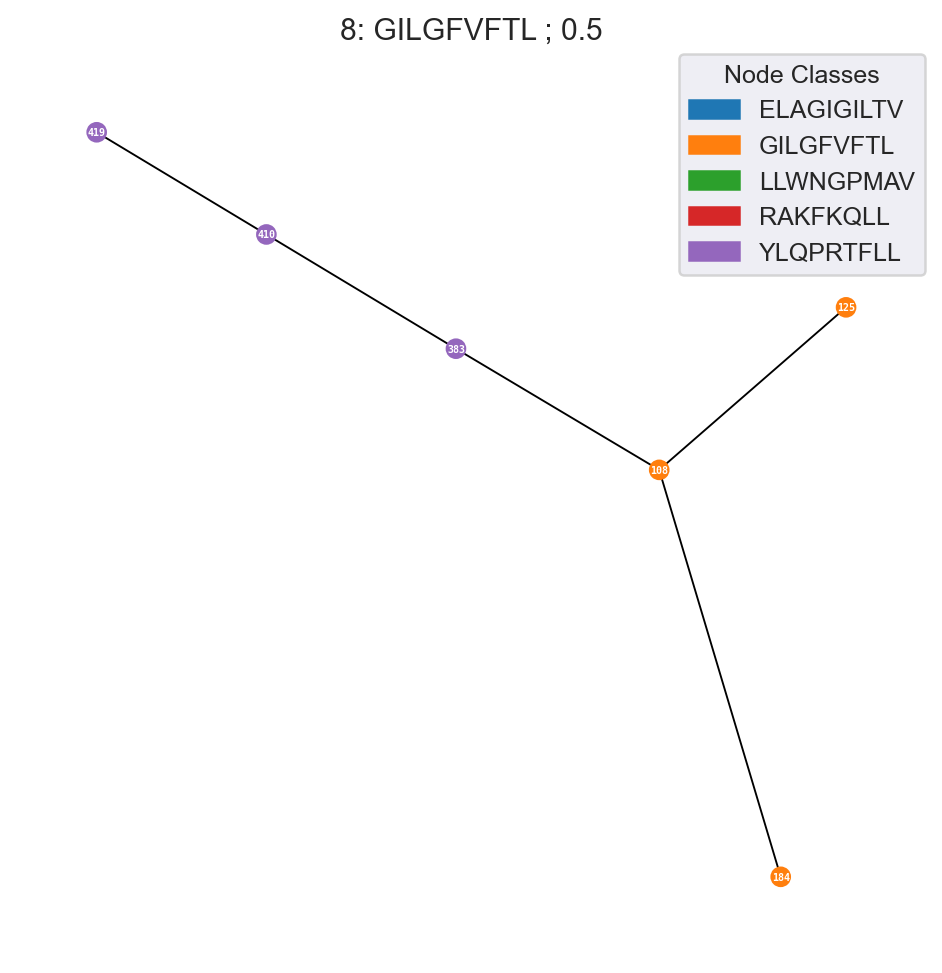

[((88, 92), 0.3105800151824951), ((92, 128), 0.3069805304209391)]


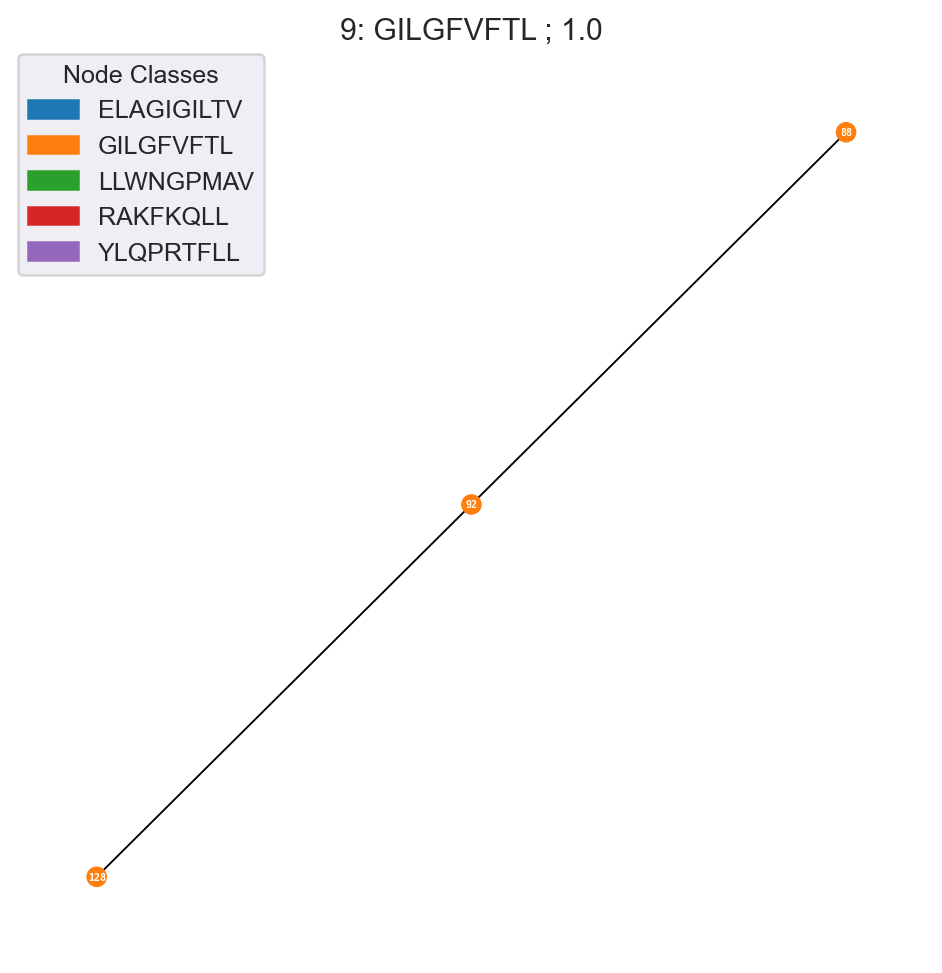

[((283, 307), 0.3934199015299479), ((283, 339), 0.31900060176849365)]


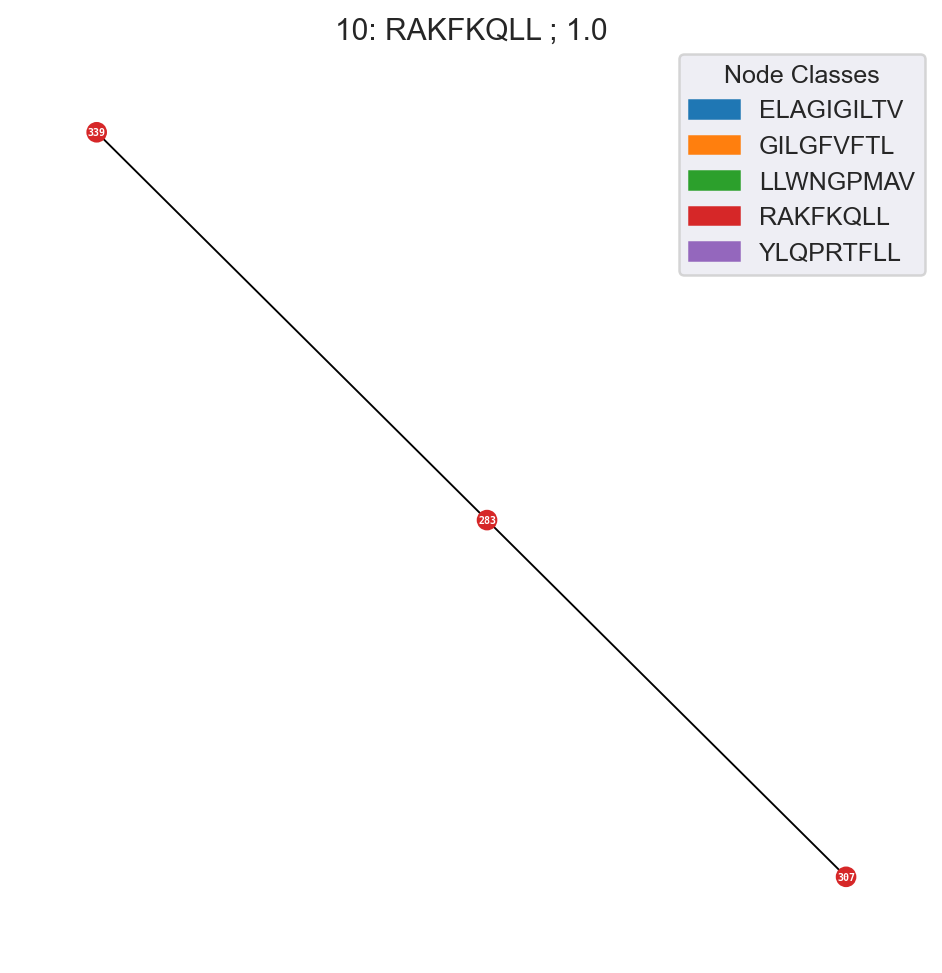

[((291, 315), 0.2762315273284912)]


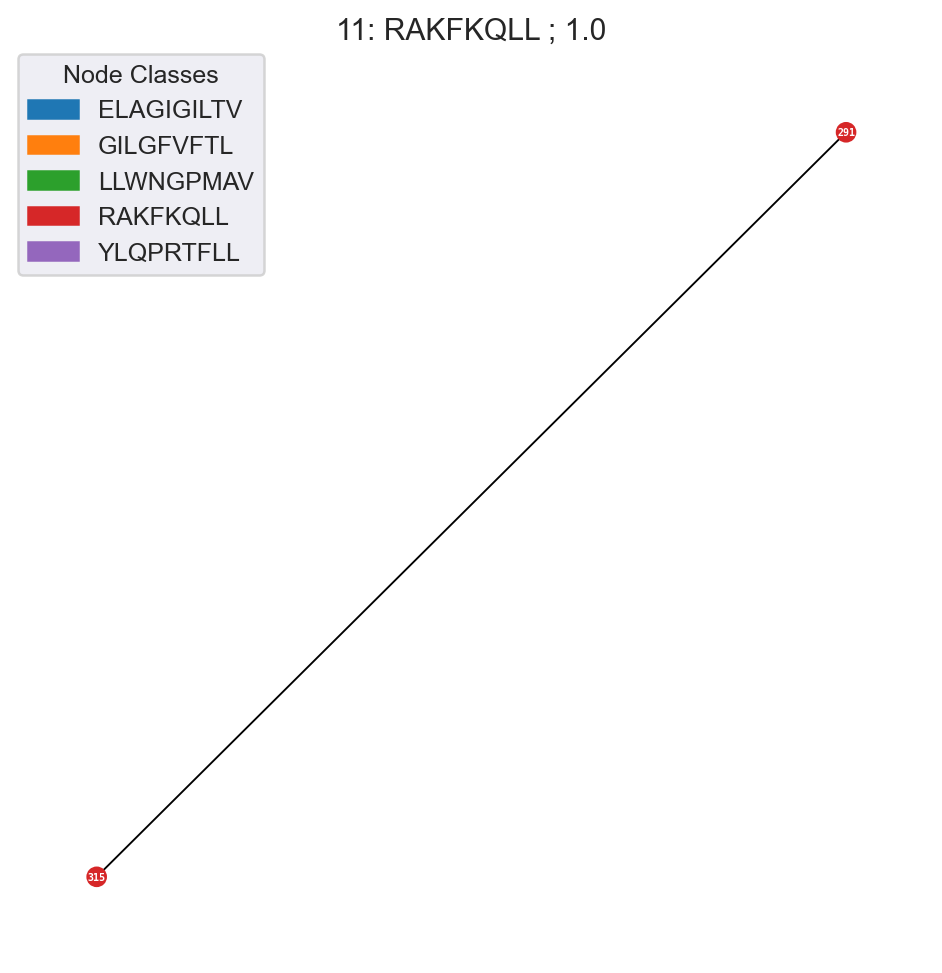

[((299, 311), 0.41842854022979736)]


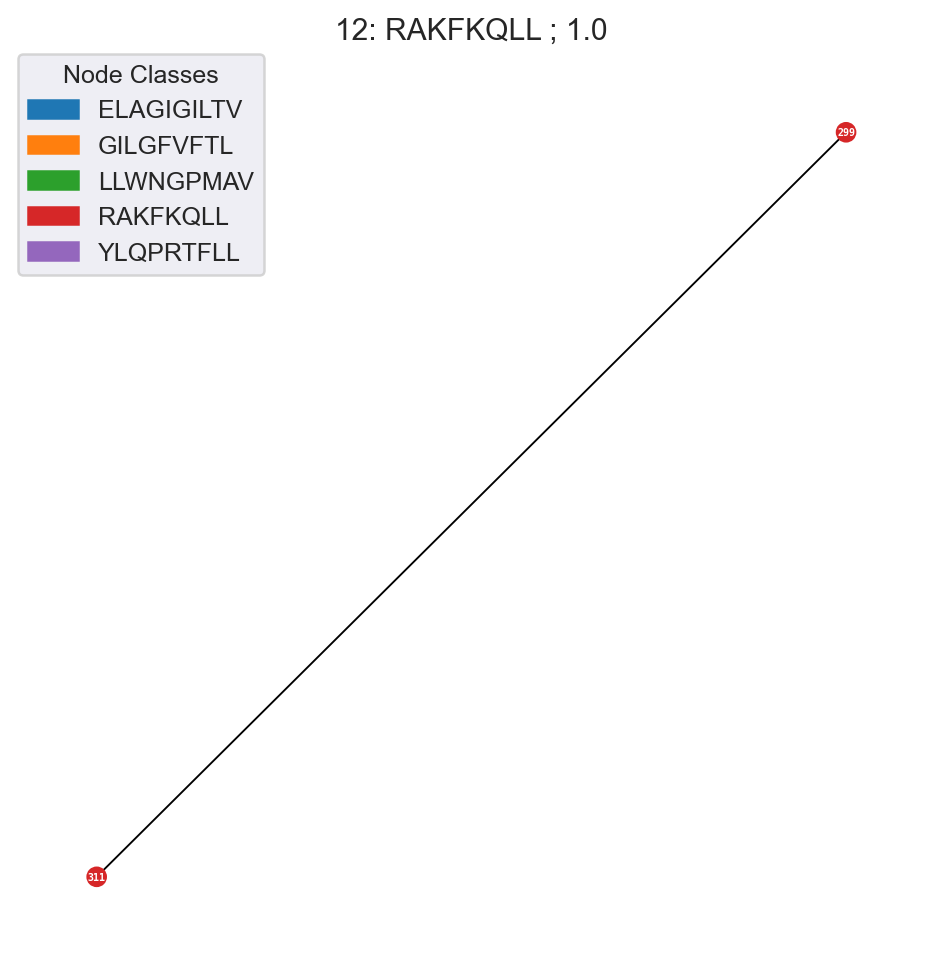

In [590]:
for i,c in enumerate(clusters_0):
    subgraph = nx.subgraph(tree_cut_0, c['members'])
    wb = {k:subgraph.edges[k]['weight']*v for k,v in nx.edge_betweenness_centrality(subgraph).items()}
    pprint(sorted(wb.items(), key=lambda x: x[1], reverse=True)[:10])
    plot_mst_spring(subgraph, color_map, title=f'{i}: {c["majority_label"]} ; {c["purity"]}',
                    figsize=(6.5,6.5), iterations=300, threshold=1e-5, scale=1, k=0.08, seed=131)

[((224, 229), 0.138672460349592),
 ((224, 228), 0.10579356741397938),
 ((75, 229), 0.10571777214064408),
 ((220, 224), 0.1041515572659954),
 ((31, 75), 0.08648574627956564),
 ((199, 229), 0.074636821499806),
 ((265, 31), 0.07387684463462159),
 ((79, 220), 0.05899803986933141),
 ((210, 217), 0.0519992138477082),
 ((75, 208), 0.047388187720751346)]


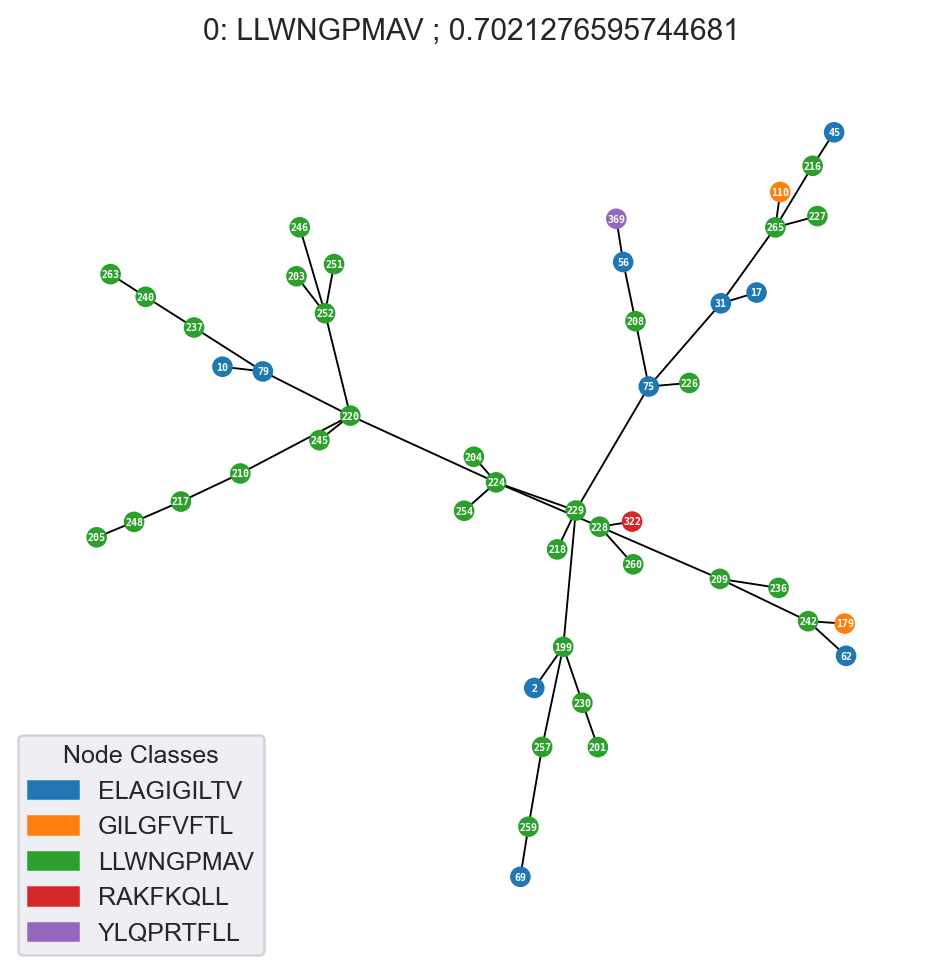

[((392, 200), 0.2498853351423132),
 ((392, 355), 0.22543946805431453),
 ((262, 253), 0.22466888247552994),
 ((262, 59), 0.2119892449514103),
 ((200, 215), 0.19855835193242782),
 ((47, 59), 0.18664933280584461),
 ((141, 47), 0.1430990522207036),
 ((262, 24), 0.13770431256004673),
 ((420, 355), 0.10735183270514896),
 ((29, 41), 0.08426770185812925)]


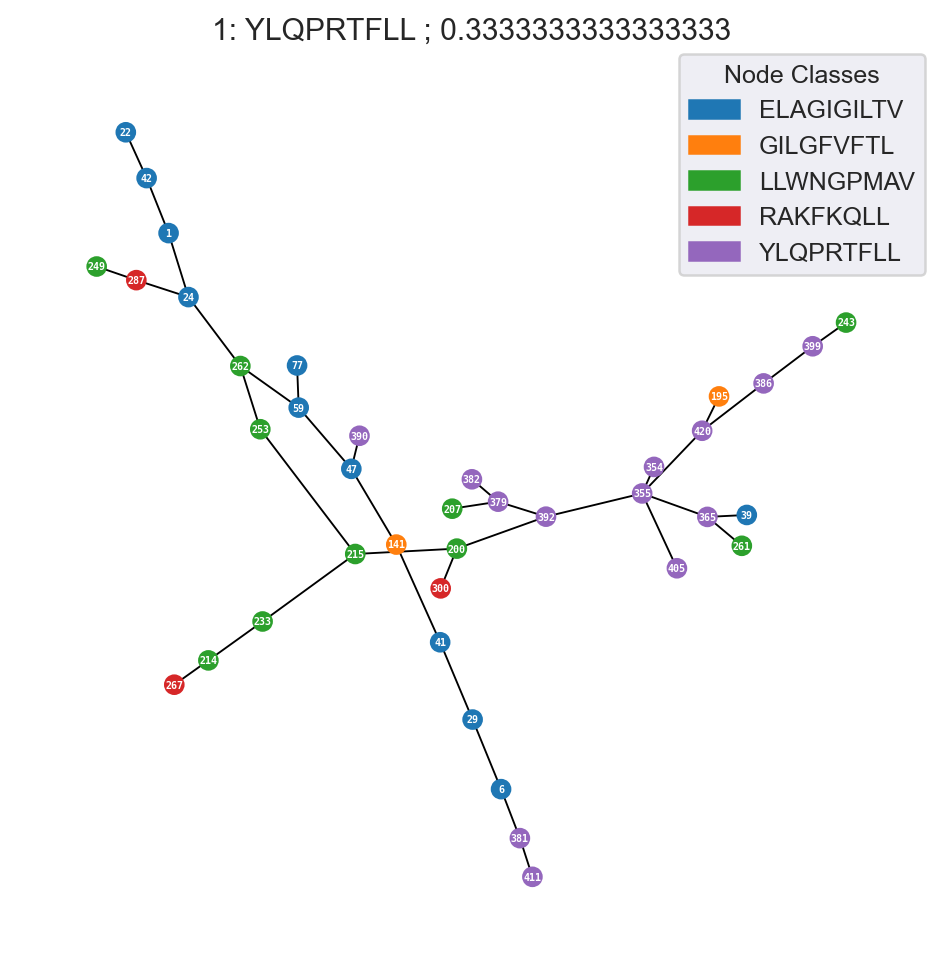

[((9, 30), 0.2285250433029667),
 ((30, 70), 0.2057417336330619),
 ((25, 30), 0.15247192690449374),
 ((65, 70), 0.1455432561136061),
 ((48, 65), 0.14385713454215757),
 ((9, 35), 0.13338350480602634),
 ((9, 36), 0.12623450448436122),
 ((48, 364), 0.11095435696263467),
 ((231, 378), 0.10919480939065256),
 ((54, 212), 0.10612541014148343)]


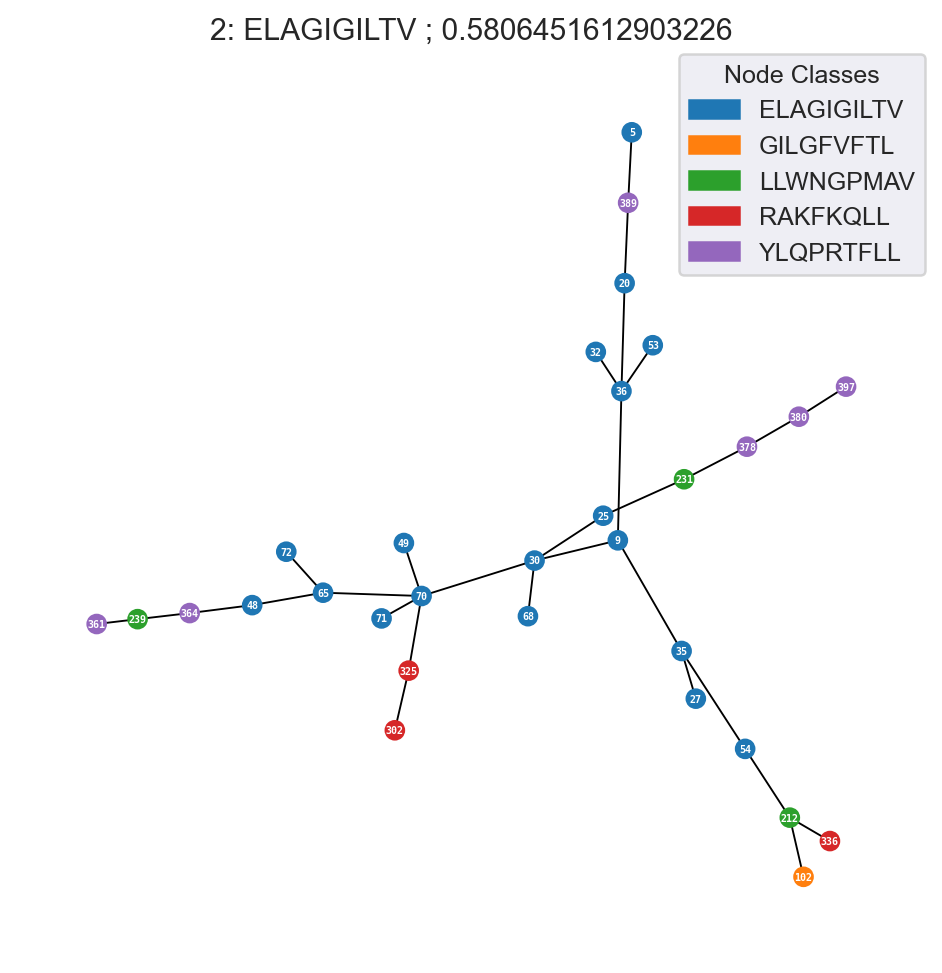

[((11, 73), 0.2616737711499309),
 ((0, 11), 0.20423338775746305),
 ((73, 372), 0.1983938161392658),
 ((63, 372), 0.1976332329867179),
 ((11, 282), 0.17082918735972621),
 ((282, 91), 0.1284323854056018),
 ((0, 81), 0.11682350314848604),
 ((26, 63), 0.11000085295292368),
 ((0, 57), 0.10420679348951194),
 ((11, 23), 0.10352820471713417)]


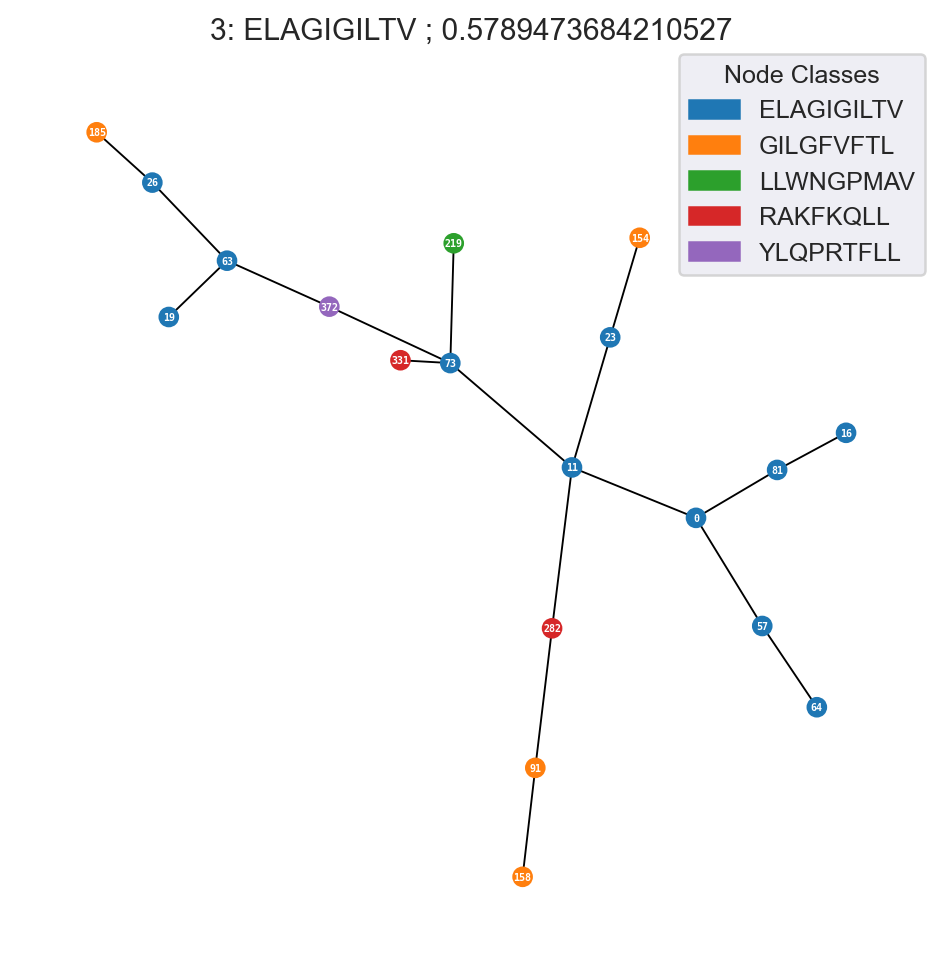

[((14, 55), 0.2109973132610321),
 ((8, 74), 0.1990736855400933),
 ((8, 55), 0.1800110936164856),
 ((8, 13), 0.1293058925204807),
 ((74, 15), 0.11368743578592935),
 ((34, 14), 0.1064714855617947),
 ((33, 14), 0.1057438055674235),
 ((4, 55), 0.07423549228244357)]


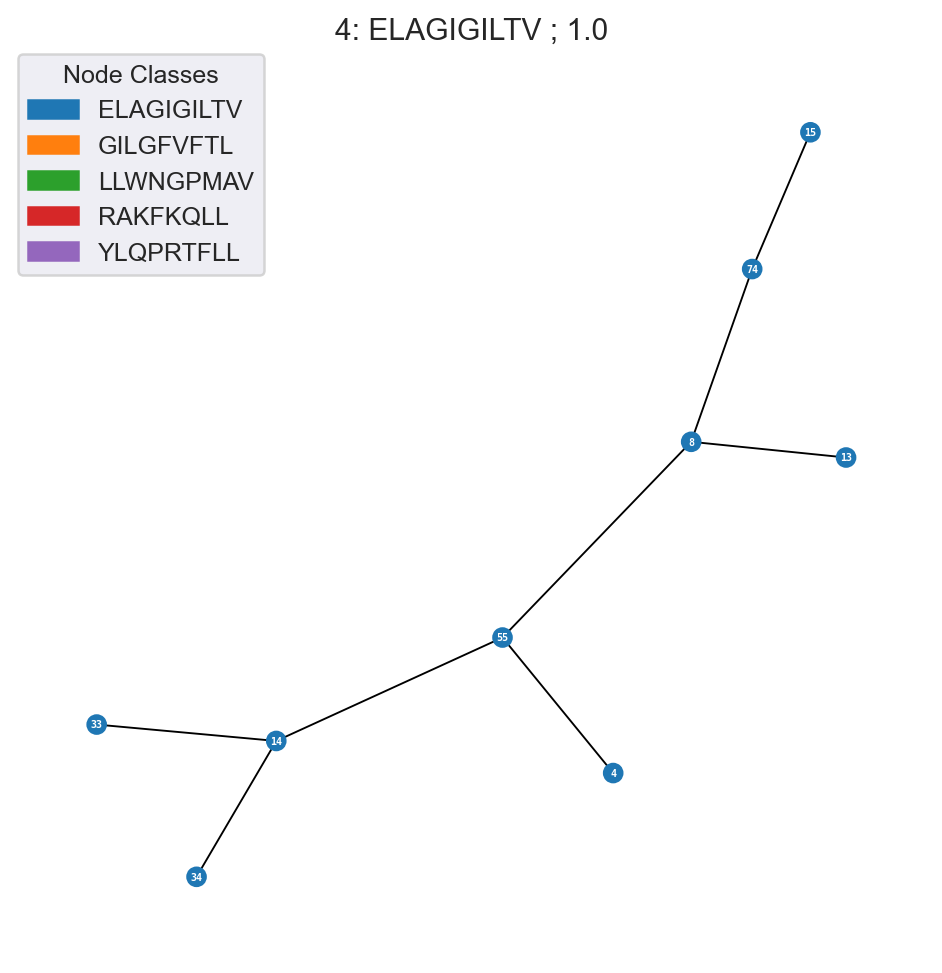

[((67, 50), 0.27873643807002474),
 ((67, 52), 0.2631558690752302),
 ((50, 309), 0.23096665314265657),
 ((18, 52), 0.15710461139678955),
 ((44, 52), 0.145011305809021),
 ((294, 309), 0.13916972279548645),
 ((67, 12), 0.05256275832653046)]


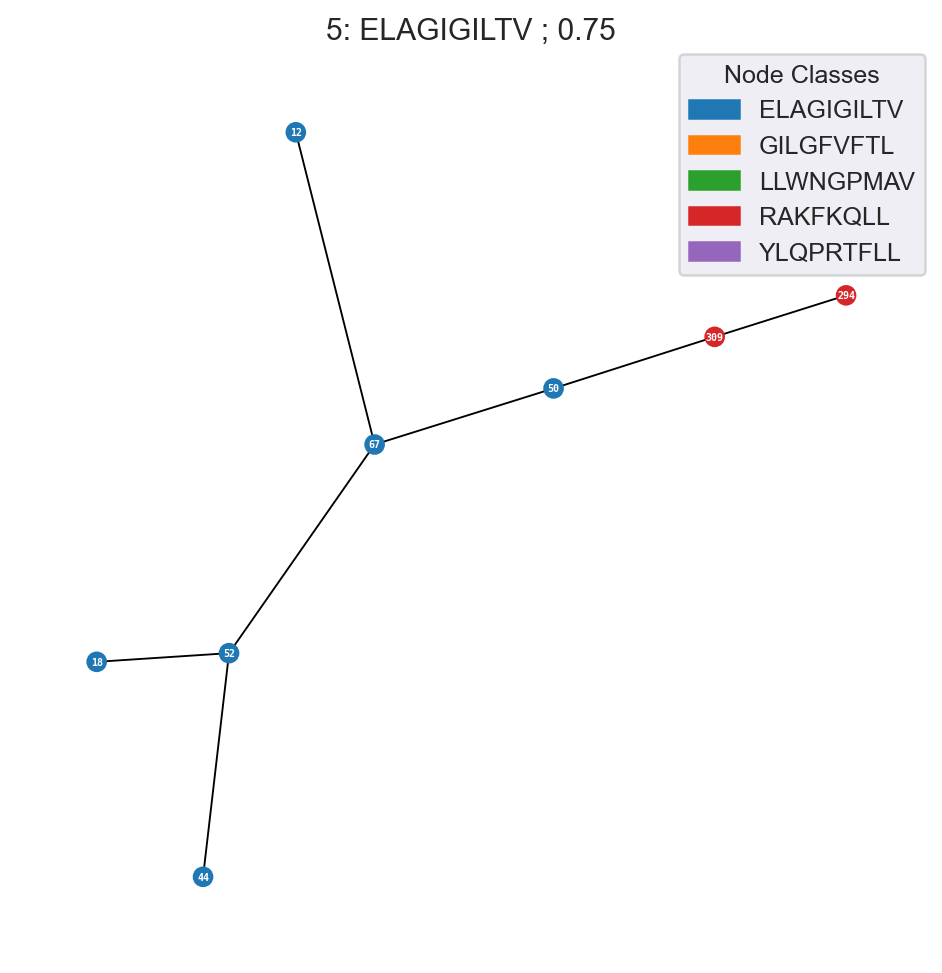

[((174, 247), 0.3271112124125163),
 ((38, 82), 0.25106080373128253),
 ((174, 82), 0.2448350429534912),
 ((371, 247), 0.2096187671025594),
 ((38, 43), 0.14444277683893839)]


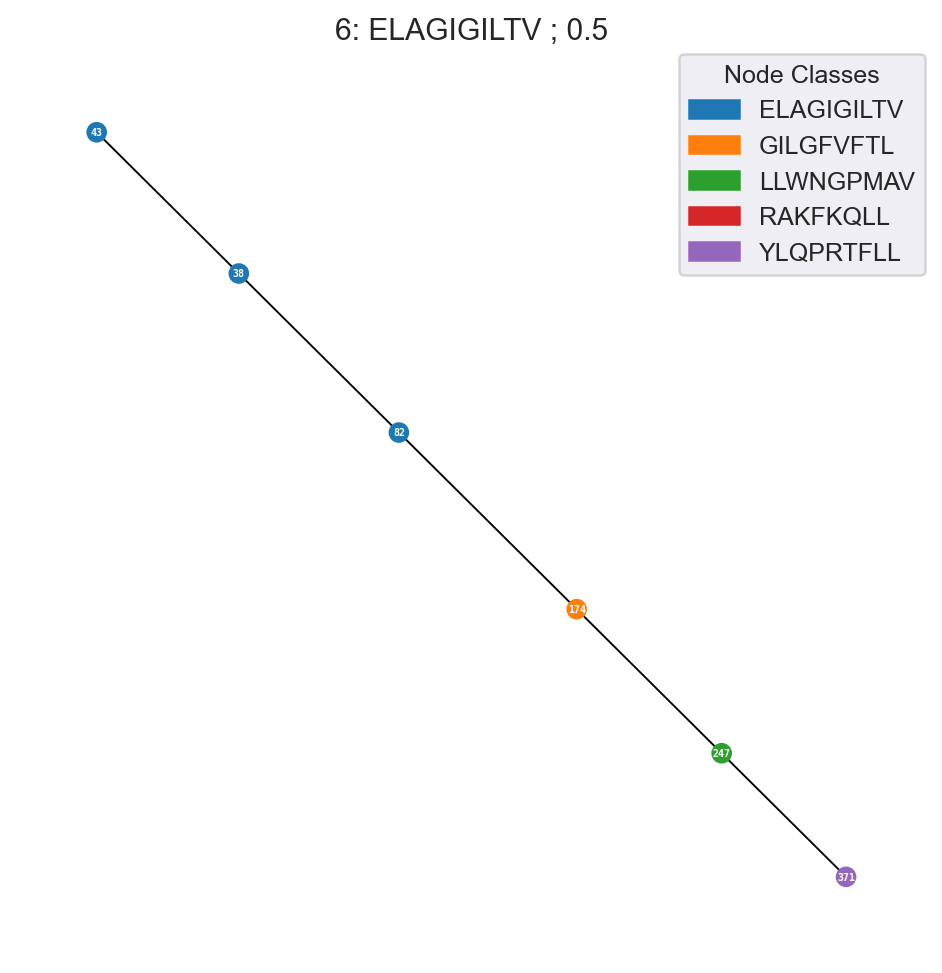

In [589]:
for i,c in enumerate(clusters_1):
    subgraph = nx.subgraph(tree_pruned, c['members'])
    wb = {k:subgraph.edges[k]['weight']*v for k,v in nx.edge_betweenness_centrality(subgraph).items()}
    pprint(sorted(wb.items(), key=lambda x: x[1], reverse=True)[:10])
    plot_mst_spring(subgraph, color_map, title=f'{i}: {c["majority_label"]} ; {c["purity"]}',
                    figsize=(6.5,6.5), iterations=300, threshold=1e-5, scale=1, k=0.08, seed=131)

## Size iterative

In [633]:
import random
# Loop test:
max_size=6
clusters = [{'cluster_size':12}, {'cluster_size':15}, {'cluster_size':5}, {'cluster_size':3}, {'cluster_size':9}]
print(clusters)
while any([x['cluster_size']>=max_size for x in clusters]):
    for i,c in enumerate(clusters):
        if c['cluster_size']>=max_size:
        # simulate a cut by just randomly making it smaller
            current_cluster = clusters.pop(i)
            new_clusters = [{'cluster_size':random.randint(2, max(3,current_cluster['cluster_size']-2))} for _ in range((current_cluster['cluster_size']%max_size)+1)]
            clusters.extend(new_clusters)

print(clusters)

[{'cluster_size': 12}, {'cluster_size': 15}, {'cluster_size': 5}, {'cluster_size': 3}, {'cluster_size': 9}]
[{'cluster_size': 5}, {'cluster_size': 3}, {'cluster_size': 5}, {'cluster_size': 3}, {'cluster_size': 2}, {'cluster_size': 4}, {'cluster_size': 5}, {'cluster_size': 4}, {'cluster_size': 3}, {'cluster_size': 3}, {'cluster_size': 4}, {'cluster_size': 5}, {'cluster_size': 4}, {'cluster_size': 2}, {'cluster_size': 2}, {'cluster_size': 2}, {'cluster_size': 4}, {'cluster_size': 2}, {'cluster_size': 2}, {'cluster_size': 4}, {'cluster_size': 3}, {'cluster_size': 2}, {'cluster_size': 4}, {'cluster_size': 4}, {'cluster_size': 3}, {'cluster_size': 5}, {'cluster_size': 2}, {'cluster_size': 4}, {'cluster_size': 3}, {'cluster_size': 3}, {'cluster_size': 3}, {'cluster_size': 2}, {'cluster_size': 3}, {'cluster_size': 4}, {'cluster_size': 3}, {'cluster_size': 4}, {'cluster_size': 2}, {'cluster_size': 4}]


In [735]:
da_ld128 = dm_ld128[dm_ld128.index].values
da_ld256 = dm_ld256[dm_ld256.index].values

In [737]:
da_ld256[da_ld256!=0].mean()

0.23637518

In [738]:
da_ts128[da_ts128!=0].mean()

0.96713334

In [739]:
from src.networkx_utils import create_mst_from_distance_matrix, prune_by_distance, betweenness_cut, get_cluster_stats_from_graph, plot_mst_spring, get_color_map
from src.networkx_utils import iterative_top_cut
# Now using a cleaner code version for this: 
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
print(values[values!=0].min(), values[values!=0].mean(), np.median(values[values!=0]), values[values!=0].std(), values[values!=0].max())
# Initial pruning based on distance
print
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)
# Iterative tree cutting, u ing a distance-weighted initial cut
tree_cut, subgraphs, clusters, edges_cut, nodes_cut = iterative_top_cut(tree_pruned, initial_cut_threshold=0.21, initial_cut_method='threshold', 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=6)

sum([x['cluster_size'] for x in clusters])/len(G), np.mean([x['purity'] for x in clusters]), np.mean([x['cluster_size'] for x in clusters])

0.08901167 0.96713334 0.9873117 0.14298433 1.3716043


(0.9407582938388626, 0.8059322033898305, 3.364406779661017)

In [806]:
def bonsai_pipeline(input_dist_matrix, distance_threshold, initial_cut_threshold, top_n=1, weighted=True, verbose=2, max_size=6):
    G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(input_dist_matrix, label_col='peptide', index_col='raw_index', algorithm='kruskal')
    print('*'*50)
    print('matrix values')
    print(values[values!=0].min(), values[values!=0].mean(), np.median(values[values!=0]), values[values!=0].std(), values[values!=0].max())
    print('*'*50)
    # Initial pruning based on distance
    tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, distance_threshold, prune_node=True, labels=labels, verbose=True)

    # Iterative tree cutting, u ing a distance-weighted initial cut
    tree_cut, subgraphs, clusters, edges_cut, nodes_cut = iterative_top_cut(tree_pruned, initial_cut_threshold=initial_cut_threshold, initial_cut_method='threshold',
                                                                            top_n=top_n, which='edge', weighted=weighted, verbose=verbose, max_size=max_size)
    print('retention\tpurity\tmean clust. size')
    print(round(sum([x['cluster_size'] for x in clusters])/len(G),4),'\t\t', round(np.mean([x['purity'] for x in clusters]),4),'\t', round(np.mean([x['cluster_size'] for x in clusters]),4))
    return clusters, G, tree_pruned, tree_cut, pruned_nodes, nodes_cut

def ret_pur_mean(clusters):
    return round(sum([x['cluster_size'] for x in clusters])/len(G),7), round(np.mean([x['purity'] for x in clusters]),7), round(np.mean([x['cluster_size'] for x in clusters]),7)


In [808]:
max_size=6
print('#'*30,'\n','tbcr')
tbcr_clusters, tbcr_G, tbcr_tree_pruned, tbcr_tree_cut, tbcr_pruned_nodes, tbcr_nodes_cut = bonsai_pipeline(tbcr_test, distance_threshold=0.16, initial_cut_threshold=0.025, top_n=1, weighted=True, verbose=0, max_size=max_size)
print('#'*30,'\n')

print('#'*30,'\n','LD128')
ld128_clusters, ld128_G, ld128_tree_pruned, ld128_tree_cut, ld128_pruned_nodes, ld128_nodes_cut = bonsai_pipeline(dm_ld128, distance_threshold=0.175, initial_cut_threshold=0.02, top_n=1, weighted=True, verbose=0, max_size=max_size)
print('#'*30,'\n')

print('#'*30,'\n','LD256')
ld256_clusters, ld256_G, ld256_tree_pruned, ld256_tree_cut, ld256_pruned_nodes, ld256_nodes_cut = bonsai_pipeline(dm_ld256, distance_threshold=0.175, initial_cut_threshold=0.02, top_n=1, weighted=True, verbose=0, max_size=max_size)
print('#'*30,'\n')

print('#'*30,'\n','TS128')
ts128_clusters, ts128_G, ts128_tree_pruned, ts128_tree_cut, ts128_pruned_nodes, ts128_nodes_cut = bonsai_pipeline(dm_ts128, distance_threshold=0.667, initial_cut_threshold=0.21, top_n=1, weighted=True, verbose=0, max_size=max_size)
print('#'*30,'\n')

############################## 
 tbcr
**************************************************
matrix values
0.0355119166666666 0.18185597771517448 0.1827079166666666 0.026103136434186065 0.2906513333333334
**************************************************
***
before pruning : 421 edges, 422 nodes
***
***
after pruning : 413 edges, 414 nodes
***
8 removed edges 
25.00% of the removed edges were actually same-class
retention	purity	mean clust. size
0.9431 		 0.7697 	 3.4609
############################## 

############################## 
 LD128
**************************************************
matrix values
0.01782453 0.23988804 0.24380529 0.036677968 0.37300664
**************************************************
***
before pruning : 421 edges, 422 nodes
***
***
after pruning : 415 edges, 416 nodes
***
6 removed edges 
16.67% of the removed edges were actually same-class
retention	purity	mean clust. size
0.9384 		 0.7784 	 3.4737
############################## 

#############################

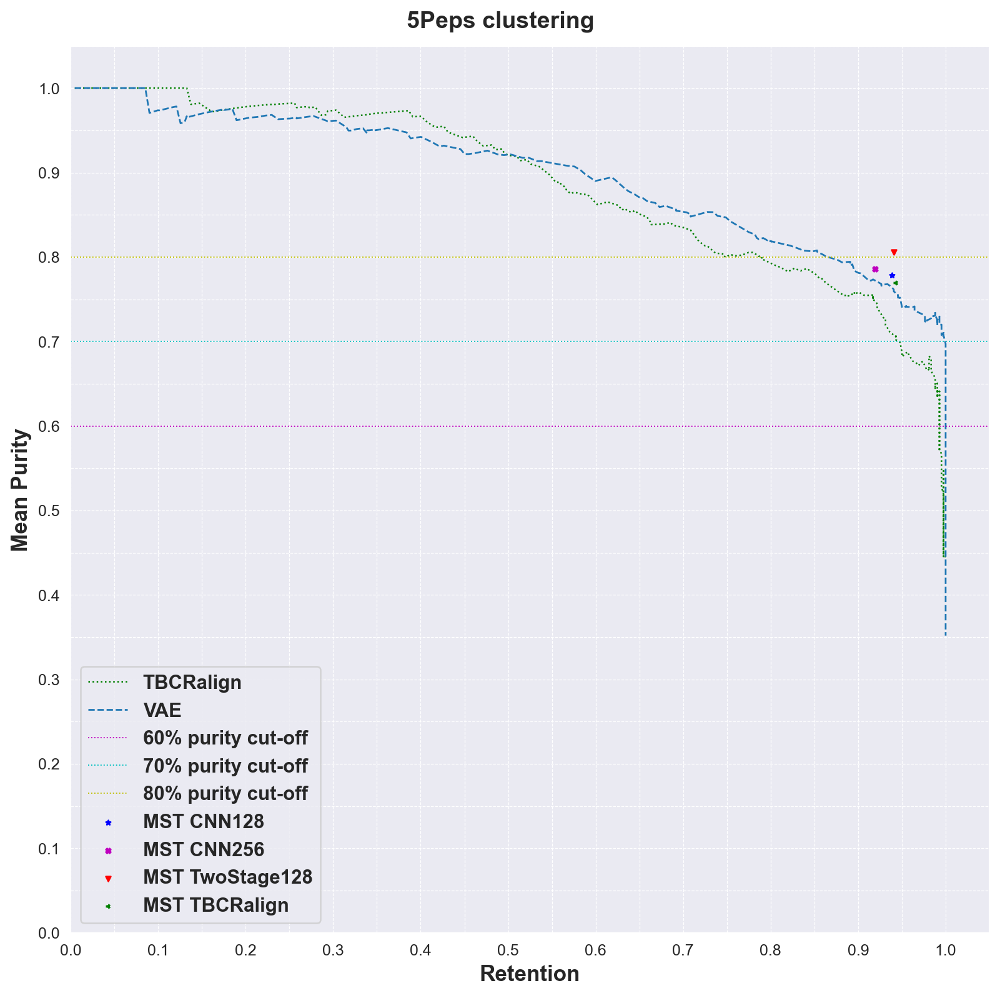

In [805]:
from src.cluster_utils import plot_retention_purities
f,ax = plot_retention_purities(pd.concat([tbcr_cluster.assign(input_type='TBCRalign'),  vae_cluster.assign(input_type='vae'.upper())]), title='5Peps clustering', add_clustersize=False)
for name, cluster, color, marker in zip(['MST CNN128', 'MST CNN256', 'MST TwoStage128', 'MST TBCRalign'],
                                        [ld128_clusters, ld256_clusters, ts128_clusters, tbcr_clusters],
                                        ['b', 'm', 'r', 'g'], 
                                        ['*', 'X', 'v', '3']):
    
    a,b,c = ret_pur_mean(cluster)
    ax.scatter([a],[b], c=color, marker=marker, s=10, label=name)
    
ax.legend(title_fontproperties={'weight':'semibold','size':14}, prop={'weight':'semibold','size':12.5})

## Score iterative

In [902]:
# Notes: Collecting the trash / singletons and recovering the true labels + creating a predicted labels list (that matches the order of the original labels)

# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# Initial pruning based on distance
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)

# Initial cut based on weighted edge betweenness
tree_cut, clusters, cut_edges, cut_nodes = betweenness_cut(tree_pruned, 0.15, 'threshold', which='edge', weighted=True,verbose=0)

# Need to collect ALL pruned nodes in a list (in order to make unique "singleton cluster labels"), and then do all the clusters followed by all the singletons leading to X different labels
# Actually this is not needed.
# pruned_nodes.extend(cut_nodes)


In [904]:
from src.networkx_utils import get_silhouette_score_at_cut

get_silhouette_score_at_cut(values, clusters)

-0.08855862

### some timing issues with get_labels

In [894]:
def get_labels1(G, clusters, pruned_nodes):
    pred_labels = np.full(len(G), -1, dtype=np.int16)
    for i,c in enumerate(clusters):
        pred_labels[list(c['members'])]=i
    
    singleton_indices = np.where(pred_labels==-1)[0]
    n_classes = np.max(pred_labels)+1
    n_singletons = len(singleton_indices)
    pred_labels[singleton_indices]=range(n_classes, n_classes+n_singletons)
    return pred_labels

def get_labels2(G, clusters, pruned_nodes):
    # Initialize pred_labels with -1
    pred_labels = np.full(len(G), -1, dtype=np.int16)
    
    # Flatten cluster indices and labels
    cluster_indices = np.hstack([list(c['members']) for c in clusters])
    cluster_labels = np.hstack([[i] * len(c['members']) for i, c in enumerate(clusters)])
    
    # Assign cluster labels in a vectorized manner
    pred_labels[cluster_indices] = cluster_labels
    
    # Identify singleton indices
    singleton_indices = np.where(pred_labels == -1)[0]
    
    # Calculate the number of clusters and singletons
    n_classes = len(clusters)
    n_singletons = len(singleton_indices)
    
    # Assign unique labels to singletons using vectorized operation
    pred_labels[singleton_indices] = np.arange(n_classes, n_classes + n_singletons)
    
    return 

def get_labels3(G, clusters, pruned_nodes):
    pred_labels = np.full(len(G), -1, dtype=np.int16)
    
    # Preallocate arrays for indices and labels
    total_members = sum(len(c['members']) for c in clusters)
    cluster_indices = np.empty(total_members, dtype=int)
    cluster_labels = np.empty(total_members, dtype=int)
    
    idx = 0
    for i, c in enumerate(clusters):
        members = np.array(list(c['members']))
        cluster_indices[idx:idx+len(members)] = members
        cluster_labels[idx:idx+len(members)] = i
        idx += len(members)
    
    pred_labels[cluster_indices] = cluster_labels
    
    singleton_indices = np.where(pred_labels == -1)[0]
    n_classes = len(clusters)
    n_singletons = len(singleton_indices)
    
    pred_labels[singleton_indices] = np.arange(n_classes, n_classes + n_singletons)
    
    return pred_labels

In [885]:
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)
# Get a lot of subclusters to time the get_labels functions
tree_cut, subgraphs, clusters, edges_cut, nodes_cut = iterative_top_cut(tree_pruned, initial_cut_threshold=0.21, initial_cut_method='threshold', 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=6)
pruned_nodes.extend(nodes_cut)

In [886]:
sum([c['cluster_size'] for c in clusters]) + len(set(pruned_nodes))

422

In [887]:
len(clusters)

118

In [893]:
print('labels1')
%timeit -r 50 -n 1000 get_labels1(G, clusters, pruned_nodes)
print('labels2')
%timeit -r 50 -n 1000 get_labels2(G, clusters, pruned_nodes)

labels1
80.2 µs ± 595 ns per loop (mean ± std. dev. of 50 runs, 1,000 loops each)
labels2
139 µs ± 3.07 µs per loop (mean ± std. dev. of 50 runs, 1,000 loops each)


In [895]:
print('labels3')
%timeit -r 50 -n 1000 get_labels3(G, clusters, pruned_nodes)

labels3
117 µs ± 1.96 µs per loop (mean ± std. dev. of 50 runs, 1,000 loops each)


In [899]:
def get_labels4(G, clusters, pruned_nodes):
    # Initialize pred_labels with -1
    pred_labels = np.full(len(G), -1, dtype=np.int16)
    
    # Assign cluster labels
    for i, c in enumerate(clusters):
        members = np.array(list(c['members']))
        pred_labels[members] = i
    
    # Identify singleton indices
    singleton_indices = np.where(pred_labels == -1)[0]
    
    # Calculate the number of clusters and singletons
    n_classes = len(clusters)
    n_singletons = len(singleton_indices)
    
    # Assign unique labels to singletons
    pred_labels[singleton_indices] = np.arange(n_classes, n_classes + n_singletons)
    
    return pred_labels
%timeit -r 50 -n 1000 get_labels1(G, clusters, pruned_nodes)
%timeit -r 50 -n 1000 get_labels4(G, clusters, pruned_nodes)


78.9 µs ± 1.77 µs per loop (mean ± std. dev. of 50 runs, 1,000 loops each)
68.1 µs ± 1.07 µs per loop (mean ± std. dev. of 50 runs, 1,000 loops each)


### Cuts algo comparisons

In [ ]:
# REDO 

In [1088]:
exp17.query('partition==1 and peptide in @dm_ts128.peptide.unique()')

,Unnamed: 0.1,Unnamed: 0,peptide,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
1,1,4,ELAGIGILTV,DRGSQS,IYSNGD,AAPQGAGTALI,LGHNA,YSLEER,ASSRALLMGNTIY,HLA-A*02:01,1,1,10x,ELAGIGILTV,ITRAP_4414,37133356,NaN,paired,nettcr
14,14,25,GILGFVFTL,DSSSTY,IFSNMDM,AERQNFV,LNHDA,SQIVND,ASSISSTGELF,HLA-A*02:01,1,1,10x,GILGFVFTL,ITRAP_4946,37133356,NaN,paired,nettcr
18,18,30,GILGFVFTL,NSAFQY,TYSSGN,AMSGDGGSQGNLI,LNHDA,SQIVND,ASSIRAGETQY,HLA-A*02:01,1,1,10x,GILGFVFTL,ITRAP_624,37133356,NaN,paired,nettcr
20,20,35,GILGFVFTL,TTLSN,LVKSGEV,AGNYGGSQGNLI,LNHDA,SQIVND,ASSTRSHEPQH,HLA-A*02:01,1,1,10x,GILGFVFTL,ITRAP_1356,37133356,NaN,paired,nettcr
23,23,38,LLWNGPMAV,NSASQS,VYSSG,VVSGFKTI,MNHEY,SVGEGT,ASSDTDRGIYGYT,HLA-A*02:01,1,1,VDJdb,LLWNGPMAV,VDJdb_6564,28103239,YFV,paired,nettcr
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7311,7312,9740,GILGFVFTL,DRGSQS,IYSNGD,AALGGGADGLT,DFQATT,SNEGSKA,SAPPGDHTEAF,HLA-A*02:01,1,1,10x,GILGFVFTL,ITRAP_1242,37133356,NaN,paired,nettcr
7316,7317,9745,ELAGIGILTV,DRGSQS,IYSNGD,AVINYQLI,MNHNY,SVGAGI,ASSYYLAGTSIYEQY,HLA-A*02:01,1,1,10x,ELAGIGILTV,ITRAP_626,37133356,NaN,paired,nettcr
7317,7318,9746,RAKFKQLL,TSGFNG,NVLDGL,AVRDPGRDYKLS,DFQATT,SNEGSKA,SARGHETTGELF,HLA-B*08:01,1,1,10x,RAKFKQLL,ITRAP_5246,37133356,NaN,paired,nettcr
7318,7319,9747,RAKFKQLL,NSASDY,IRSNMDK,ADSGGGADGLT,SGHDT,YYEEEE,ASSLGASMNTEAF,HLA-B*08:01,1,1,10x,RAKFKQLL,ITRAP_3903,37133356,NaN,paired,nettcr


In [1089]:
# Run the same for TCRdist
dm_tbcr = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv')
dm_tcrdist = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_cdr3_distmatrix_140peps_labeled.csv')
# resort_baseline(dm_tcrdist, dm_ts128
dm_tcrdist.head()

,Unnamed: 0,q_index,0,1,2,3,4,5,6,7,...,9764,9765,9766,9767,9768,peptide,original_peptide,raw_index,partition,binder
0,0,0,0,185,162,151,181,209,168,138,...,165,185,194,134,137,TTDPSFLGRY,TTDPSFLGRY,VDJdb_69875,1,1
1,1,1,185,0,185,179,214,233,181,214,...,212,177,201,178,179,RLPGVLPRA,RLPGVLPRA,VDJdb_73754,4,1
2,2,2,162,185,0,181,205,227,207,207,...,207,209,233,191,170,LLDFVRFMGV,LLDFVRFMGV,ITRAP_4812,4,1
3,3,3,151,179,181,0,195,183,191,189,...,169,204,178,165,178,VYFLQSINF,VYFLQSINF,IEDB_191829,3,1
4,4,4,181,214,205,195,0,220,209,167,...,196,202,181,198,189,ELAGIGILTV,ELAGIGILTV,ITRAP_4414,1,1


In [1263]:
dm_ts128.groupby('partition').count()

KeyError: 'partition'

In [1261]:
exp17.query('raw_index in @dm_ts128.raw_index.unique()')

,Unnamed: 0.1,Unnamed: 0,peptide,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
73,73,108,LLWNGPMAV,DRGSQS,IYSNGD,AVSASKII,MNHNS,SASEGT,ASSDQTGDAYEQY,HLA-A*02:01,0,1,VDJdb,LLWNGPMAV,VDJdb_6432,28103239,YFV,paired,nettcr
95,95,135,YLQPRTFLL,TTLSN,LVKSGEV,AGLGDGGSQGNLI,LGHNA,YNFKEQ,ATQDANTGELF,HLA-A*02:01,0,1,VDJdb,YLQPRTFLL,VDJdb_79888,33951417,SARS-CoV-2,paired,nettcr
112,112,161,RAKFKQLL,DSSSTY,IFSNMDM,AEGGNTGKLI,SGHNS,FNNNVP,ASSFPSGDGTQY,HLA-B*08:01,0,1,10x,RAKFKQLL,ITRAP_3266,37133356,NaN,paired,nettcr
118,118,168,RAKFKQLL,DSASNY,IRSNVGE,AAKEGGSEKLV,SQVTM,ANQGSEA,SAGGNTEAF,HLA-B*08:01,0,1,10x,RAKFKQLL,ITRAP_4328,37133356,NaN,paired,nettcr
133,133,185,LLWNGPMAV,NSASQS,VYSSG,VADSWGKLQ,LNHDA,SQIVND,ASSIPAGGAYGYT,HLA-A*02:01,0,1,IEDB,LLWNGPMAV,IEDB_56359,32081129,Yellow fever virus (Flavivirus febricis),paired,nettcr
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7257,7258,9669,ELAGIGILTV,DRGSQS,IYSNGD,AVKRGSQGNLI,MDHEN,SYDVKM,ASSLAWGQPQH,HLA-A*02:01,0,1,10x,ELAGIGILTV,ITRAP_5737,37133356,NaN,paired,nettcr
7294,7295,9718,GILGFVFTL,DSAIYN,IQSSQRE,AVSRIKAAGNKLT,LNHDA,SQIVND,ASSIYSNQPQH,HLA-A*02:01,0,1,10x,GILGFVFTL,ITRAP_2140,37133356,NaN,paired,nettcr
7297,7298,9722,GILGFVFTL,SVFSS,VVTGGEV,AGGGSQGNLI,LNHDA,SQIVND,ASSTGTLYGYT,HLA-A*02:01,0,1,10x,GILGFVFTL,ITRAP_5460,37133356,NaN,paired,nettcr
7324,7325,9753,LLWNGPMAV,NSASQS,VYSSG,VVFNFNKFY,KGHSH,LQKENI,ASSPDGGHSTDTQY,HLA-A*02:01,0,1,VDJdb,LLWNGPMAV,VDJdb_74067,28934479,YFV,paired,nettcr


In [1060]:
dm_tcrdist = dm_tcrdist.drop(columns=['Unnamed: 0']).set_index('q_index')
dm_tcrdist, values_tcrdist = resort_baseline(dm_tcrdist, dm_ts128, 'raw_index')

In [1064]:
values_tcrdist[values_tcrdist!=0].mean(), values_tcrdist.max()

(177.8141189449629, 321)

In [1073]:
from src.networkx_utils import silhouette_score_cut
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tcrdist, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tcrdist, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# Initial pruning based on distance
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 127, prune_node=True, labels=labels)
print(len(tree), len(tree_pruned))
tree_cut, subgraphs, clusters, edges_cut, nodes_cut, tcrdist_it_scores, tcrdist_it_purities, tcrdist_it_rets = iterative_top_cut(values_tcrdist, tree_pruned, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)
tree_cut, subgraphs, clusters, edges_removed, nodes_removed, tcrdist_sh_scores, tcrdist_sh_purities, tcrdist_sh_rets = silhouette_score_cut(values_tcrdist, tree_pruned, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)

422 405
Initial mean purity, silhouette score, retention
0.479 -0.0247 0.9597


In [1027]:
from src.networkx_utils import silhouette_score_cut
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# Initial pruning based on distance
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 0.667, prune_node=True, labels=labels)
print(len(tree), len(tree_pruned))
tree_cut, subgraphs, clusters, edges_cut, nodes_cut, it_scores, it_purities, it_rets = iterative_top_cut(values, tree_pruned, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)
tree_cut, subgraphs, clusters, edges_removed, nodes_removed, sh_scores, sh_purities, sh_rets = silhouette_score_cut(values, tree_pruned, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)

422 407
Initial mean purity, silhouette score, retention
0.7355 -0.0983 0.9621


In [1028]:
from src.networkx_utils import silhouette_score_cut
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(tbcr_test, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# Initial pruning based on distance
tree_pruned, pruned_edges, pruned_nodes = prune_by_distance(tree, 0.155, prune_node=True, labels=labels)
print(len(tree), len(tree_pruned))

tree_cut, subgraphs, clusters, edges_cut, nodes_cut, tbcr_it_scores, tbcr_it_purities, tbcr_it_rets = iterative_top_cut(values, tree_pruned, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)
tree_cut, subgraphs, clusters, edges_removed, nodes_removed, tbcr_sh_scores, tbcr_sh_purities, tbcr_sh_rets = silhouette_score_cut(values, tree_pruned, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)

422 408
Initial mean purity, silhouette score, retention
0.6002 -0.0706 0.9645


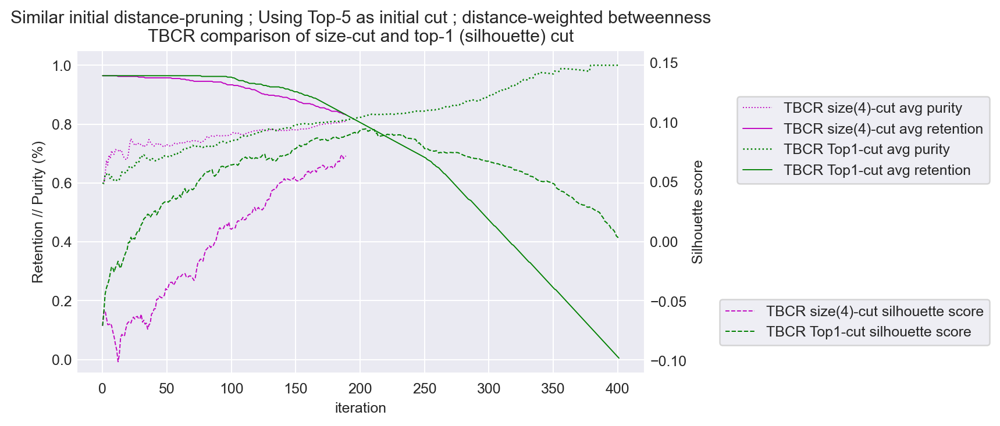

In [1040]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('Similar initial distance-pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nTBCR comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tbcr_it_purities)), tbcr_it_purities, lw=.75, ls=':', c='m',
       label='TBCR size(4)-cut avg purity')
a.plot(range(len(tbcr_it_rets)), tbcr_it_rets, lw=.75, ls='-', c='m',
       label='TBCR size(4)-cut avg retention')
a2.plot(range(len(tbcr_it_scores)), tbcr_it_scores, lw=.75, ls='--', c='m',
       label='TBCR size(4)-cut silhouette score')

a.plot(range(len(tbcr_sh_purities)), tbcr_sh_purities, lw=1, ls=':', c='g',
       label='TBCR Top1-cut avg purity')
a.plot(range(len(tbcr_sh_rets)), tbcr_sh_rets, lw=.75, ls='-', c='g',
       label='TBCR Top1-cut avg retention')
a2.plot(range(len(tbcr_sh_scores)), tbcr_sh_scores, lw=.8, ls='--', c='g',
       label='TBCR Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.15,.88))

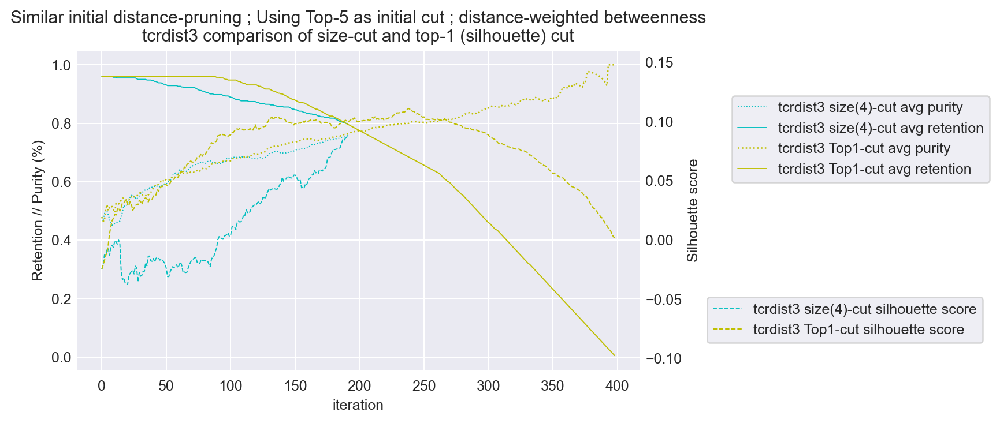

In [1083]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('Similar initial distance-pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\ntcrdist3 comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tcrdist_it_purities)), tcrdist_it_purities, lw=.75, ls=':', c='c',
       label='tcrdist3 size(4)-cut avg purity')
a.plot(range(len(tcrdist_it_rets)), tcrdist_it_rets, lw=.75, ls='-', c='c',
       label='tcrdist3 size(4)-cut avg retention')
a2.plot(range(len(tcrdist_it_scores)), tcrdist_it_scores, lw=.75, ls='--', c='c',
       label='tcrdist3 size(4)-cut silhouette score')

a.plot(range(len(tcrdist_sh_purities)), tcrdist_sh_purities, lw=1, ls=':', c='y',
       label='tcrdist3 Top1-cut avg purity')
a.plot(range(len(tcrdist_sh_rets)), tcrdist_sh_rets, lw=.75, ls='-', c='y',
       label='tcrdist3 Top1-cut avg retention')
a2.plot(range(len(tcrdist_sh_scores)), tcrdist_sh_scores, lw=.8, ls='--', c='y',
       label='tcrdist3 Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.15,.88))

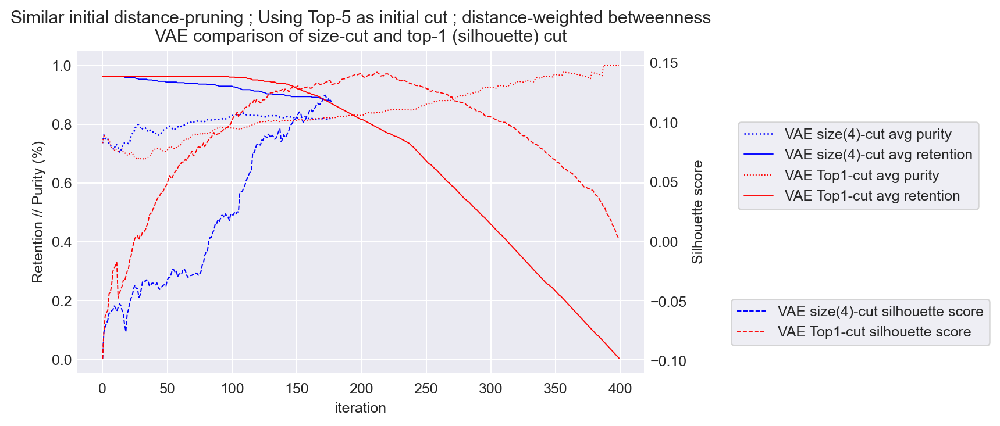

In [1042]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('Similar initial distance-pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nVAE comparison of size-cut and top-1 (silhouette) cut')
a.plot(range(len(it_purities)), it_purities, lw=1, ls=':', c='b',
       label='VAE size(4)-cut avg purity')
a.plot(range(len(it_rets)), it_rets, lw=.75, ls='-', c='b',
       label='VAE size(4)-cut avg retention')
a2.plot(range(len(it_scores)), it_scores, lw=.8, ls='--', c='b',
       label='VAE size(4)-cut silhouette score')

a.plot(range(len(sh_purities)), sh_purities, lw=.75, ls=':', c='r',
       label='VAE Top1-cut avg purity')
a.plot(range(len(sh_rets)), sh_rets, lw=.75, ls='-', c='r',
       label='VAE Top1-cut avg retention')
a2.plot(range(len(sh_scores)), sh_scores, lw=.75, ls='--', c='r',
       label='VAE Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.6,.8))

In [1045]:
np.argmax(sh_scores)

212

In [1047]:
# Identify best point (based on Silhouette score) for each of the 4 conditions and add them as scatter points
best_sh = sh_rets[np.argmax(sh_scores)], sh_purities[np.argmax(sh_scores)]
best_it = it_rets[np.argmax(it_scores)], it_purities[np.argmax(it_scores)]
best_tbcr_sh = tbcr_sh_rets[np.argmax(tbcr_sh_scores)], tbcr_sh_purities[np.argmax(tbcr_sh_scores)]
best_tbcr_it = tbcr_it_rets[np.argmax(tbcr_it_scores)], tbcr_it_purities[np.argmax(tbcr_it_scores)]

Text(0, 0.5, 'mean purity')

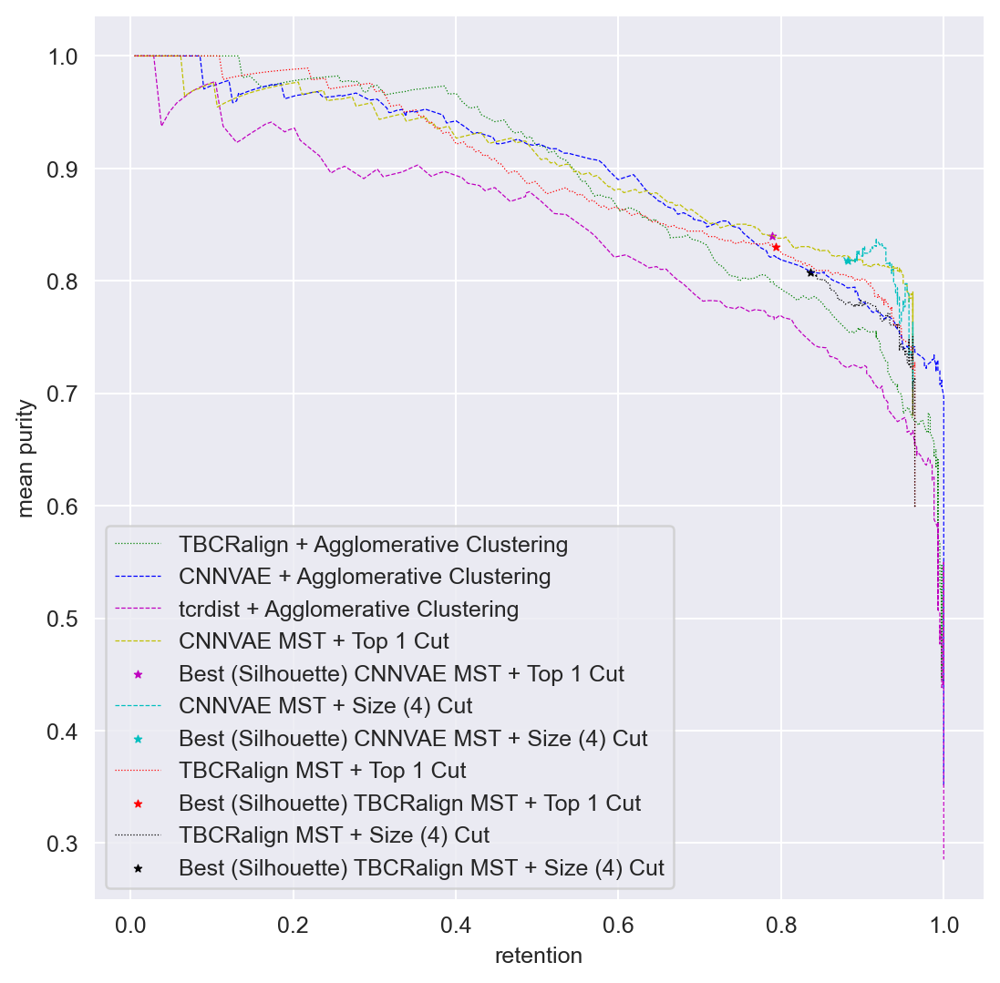

In [1082]:
f,a = plt.subplots(1,1, figsize=(7,7))
lw=.5
marker_size=12
marker='*'
a.plot(tbcr_cluster['retention'].values[1:-1], tbcr_cluster['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=lw, ls=':', c='g')
a.plot(vae_cluster['retention'].values[1:-1], vae_cluster['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=lw, ls='--', c='b')
a.plot(tcrdist_cluster['retention'].values[1:-1], tcrdist_cluster['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=lw, ls='--', c='m')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_sh[0], best_sh[1], c='m', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='c')
a.scatter(best_it[0], best_it[1], c='c', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls=':', c='r')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='r', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls=':', c='k')
a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='k', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)
a.legend()
a.set_xlabel('retention')
a.set_ylabel('mean purity')


## Redo this properly using the test partition only (partition==1) and subsampling to have about the same number of peptides

In [96]:
# Redo by sampling exactly the same number as the one used in the valid set 
counts=tbcr_test.groupby('peptide').agg(count=('binder','count')).to_dict()['count']
# Take test partition only, subsample
easy5peps = ['ELAGIGILTV', 'GILGFVFTL', 'LLWNGPMAV', 'RAKFKQLL', 'YLQPRTFLL']
testset = exp17.query('peptide in @easy5peps and partition==1')
# Randomly subsample between 60 and 74 datapoints for each peptide:
testset_subsample = []
for p in easy5peps:
    tmp = testset.query('peptide==@p')
    testset_subsample.append(tmp.sample(min(len(tmp), counts[p]), random_state=seed))
testset_subsample = pd.concat(testset_subsample)
testset_idx = testset_subsample.query('partition==1')['raw_index'].unique()
testset_subsample.groupby('peptide').count()

,Unnamed: 0.1,Unnamed: 0,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
peptide,,,,,,,,,,,,,,,,,,
ELAGIGILTV,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,12,83,83
GILGFVFTL,116,116,116,116,116,116,116,116,116,116,116,116,116,116,116,43,116,116
LLWNGPMAV,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68
RAKFKQLL,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,0,83,83
YLQPRTFLL,72,72,72,72,72,72,72,72,72,72,72,72,72,72,72,72,72,72


In [97]:
%ls ../data/filtered | grep pair


231212_nettcr_expanded_pairedAB_412peps_with_swaps.csv
240326_nettcr_exp_paired_withswaps.csv
240326_nettcr_paired_NOswaps.csv
240326_nettcr_paired_withswaps.csv


In [98]:
# re-get the baseline and re-filter based on the subset test set
dm_tbcr_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')
dm_tcrdist_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')

In [99]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

422 422 422


In [100]:
# Best model picked on validation performance
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_5000_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df_testset = get_latent_df(model, testset_subsample)
dm_ts128_testset, values_ts128_testset, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df_testset, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 5000
total: 0.2245618547955234
reconstruction: 0.06651628997370614
kld: 0.0
triplet: 0.0
BCE: 0.15804556644786044
seq_accuracy: 0.9947178959846497
pos_accuracy: 0.9971309900283813
auc: 0.7345
auc_01: 0.62808
auc_01_real: 0.29334
precision: 0.49085
recall: 0.3692
accuracy: 0.83052
AP: 0.4586


In [101]:
# Resort it just so that we can re-use the labels and indices in the same order
dm_tbcr_testset, values_tbcr_testset = resort_baseline(dm_tbcr_testset, dm_ts128_testset, 'raw_index')
dm_tcrdist_testset, values_tcrdist_testset = resort_baseline(dm_tcrdist_testset, dm_ts128_testset, 'raw_index')

In [102]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

422 422 422


In [103]:
values_tcrdist_testset[values_tcrdist_testset!=0].mean(), values_tcrdist_testset[values_tcrdist_testset!=0].min(), values_tcrdist_testset.max()

(723.881291441051, 99, 1172)

In [104]:
# Import with aliases after refactor
from src.networkx_utils import iterative_topn_cut as silhouette_score_cut, iterative_size_cut as iterative_top_cut

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tcrdist_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tcrdist_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, clusters, edges_cut, nodes_cut, tcrdist_it_scores, tcrdist_it_purities, tcrdist_it_rets = iterative_top_cut(values_tcrdist_testset, tree, 
                                                                                                                                 initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                 initial_cut_method=initial_cut_method, 
                                                                                                                                 top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, clusters, edges_removed, nodes_removed, tcrdist_sh_scores, tcrdist_sh_purities, tcrdist_sh_rets = silhouette_score_cut(values_tcrdist_testset, tree, 
                                                                                                                                            initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                            initial_cut_method=initial_cut_method, 
                                                                                                                                            top_n=1, which='edge', weighted=True, 
                                                                                                                                            verbose=0, score_threshold=.5)

Initial mean purity, silhouette score, retention
0.5624 -0.0967 0.9976


In [105]:
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_ts128_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, clusters, edges_cut, nodes_cut, it_scores, it_purities, it_rets = iterative_top_cut(values_ts128_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, clusters, edges_removed, nodes_removed, sh_scores, sh_purities, sh_rets = silhouette_score_cut(values_ts128_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)

Initial mean purity, silhouette score, retention
0.4788 -0.0276 0.9976


In [106]:
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tbcr_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tbcr_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, clusters, edges_cut, nodes_cut, tbcr_it_scores, tbcr_it_purities, tbcr_it_rets = iterative_top_cut(values_tbcr_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, clusters, edges_removed, nodes_removed, tbcr_sh_scores, tbcr_sh_purities, tbcr_sh_rets = silhouette_score_cut(values_tbcr_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)

Initial mean purity, silhouette score, retention
0.5351 -0.0733 1.0


In [107]:
print(len(values_tcrdist_testset), len(values_tbcr_testset), len(values_ts128_testset))

422 422 422


In [108]:
tcrdist_cluster_testset = cluster_all_thresholds(values_tcrdist_testset, torch.rand([len(values_tcrdist_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tbcr_cluster_testset = cluster_all_thresholds(values_tbcr_testset, torch.rand([len(values_tbcr_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
vae_cluster_testset = cluster_all_thresholds(values_ts128_testset, torch.rand([len(values_ts128_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)

HERE


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:03<00:00, 141.37it/s]


HERE


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:03<00:00, 161.55it/s]


HERE


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:03<00:00, 133.04it/s]


### silhouette score plots

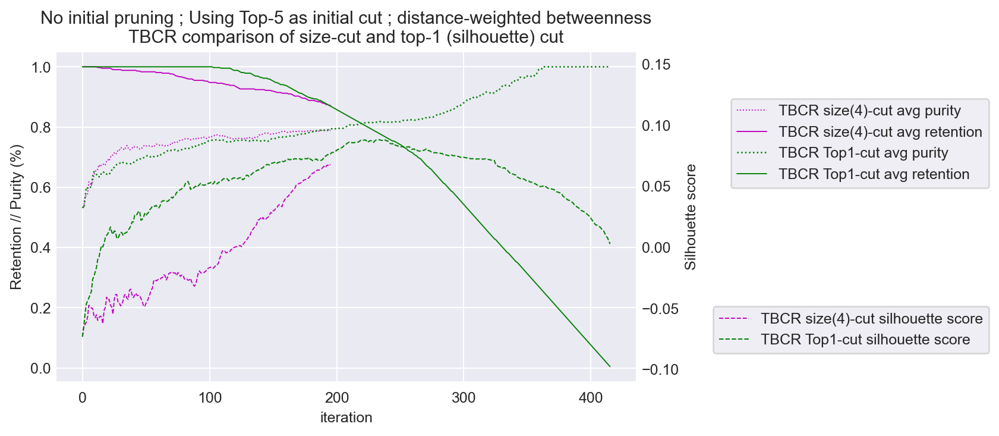

In [109]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nTBCR comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tbcr_it_purities)), tbcr_it_purities, lw=.75, ls=':', c='m',
       label='TBCR size(4)-cut avg purity')
a.plot(range(len(tbcr_it_rets)), tbcr_it_rets, lw=.75, ls='-', c='m',
       label='TBCR size(4)-cut avg retention')
a2.plot(range(len(tbcr_it_scores)), tbcr_it_scores, lw=.75, ls='--', c='m',
       label='TBCR size(4)-cut silhouette score')

a.plot(range(len(tbcr_sh_purities)), tbcr_sh_purities, lw=1, ls=':', c='g',
       label='TBCR Top1-cut avg purity')
a.plot(range(len(tbcr_sh_rets)), tbcr_sh_rets, lw=.75, ls='-', c='g',
       label='TBCR Top1-cut avg retention')
a2.plot(range(len(tbcr_sh_scores)), tbcr_sh_scores, lw=.8, ls='--', c='g',
       label='TBCR Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/easy5peps_subsampled_tbcr_testset_silhouette.png', dpi=150, bbox_inches='tight')


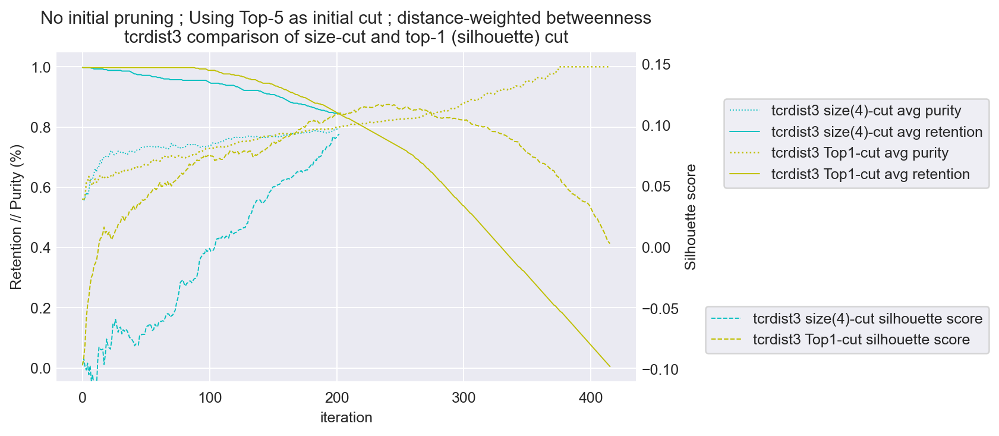

In [110]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\ntcrdist3 comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tcrdist_it_purities)), tcrdist_it_purities, lw=.75, ls=':', c='c',
       label='tcrdist3 size(4)-cut avg purity')
a.plot(range(len(tcrdist_it_rets)), tcrdist_it_rets, lw=.75, ls='-', c='c',
       label='tcrdist3 size(4)-cut avg retention')
a2.plot(range(len(tcrdist_it_scores)), tcrdist_it_scores, lw=.75, ls='--', c='c',
       label='tcrdist3 size(4)-cut silhouette score')

a.plot(range(len(tcrdist_sh_purities)), tcrdist_sh_purities, lw=1, ls=':', c='y',
       label='tcrdist3 Top1-cut avg purity')
a.plot(range(len(tcrdist_sh_rets)), tcrdist_sh_rets, lw=.75, ls='-', c='y',
       label='tcrdist3 Top1-cut avg retention')
a2.plot(range(len(tcrdist_sh_scores)), tcrdist_sh_scores, lw=.8, ls='--', c='y',
       label='tcrdist3 Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/easy5peps_subsampled_tcrdist3_testset_silhouette.png', dpi=150, bbox_inches='tight')

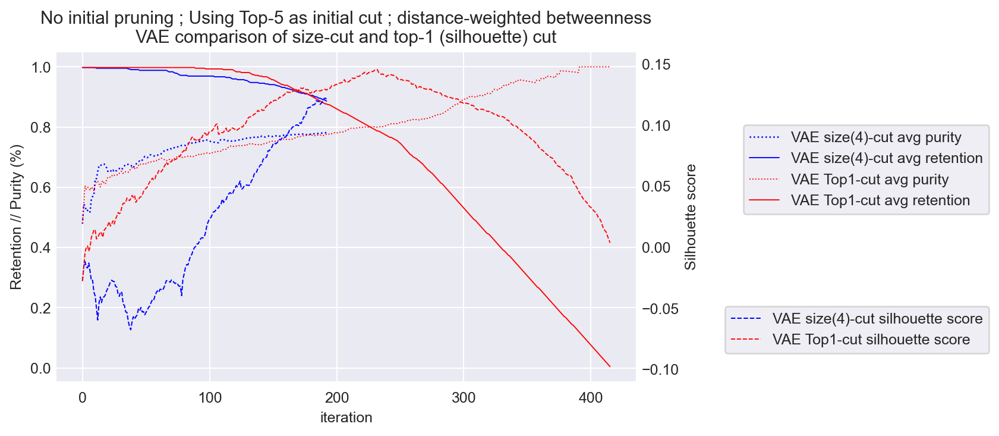

In [111]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nVAE comparison of size-cut and top-1 (silhouette) cut')
a.plot(range(len(it_purities)), it_purities, lw=1, ls=':', c='b',
       label='VAE size(4)-cut avg purity')
a.plot(range(len(it_rets)), it_rets, lw=.75, ls='-', c='b',
       label='VAE size(4)-cut avg retention')
a2.plot(range(len(it_scores)), it_scores, lw=.8, ls='--', c='b',
       label='VAE size(4)-cut silhouette score')

a.plot(range(len(sh_purities)), sh_purities, lw=.75, ls=':', c='r',
       label='VAE Top1-cut avg purity')
a.plot(range(len(sh_rets)), sh_rets, lw=.75, ls='-', c='r',
       label='VAE Top1-cut avg retention')
a2.plot(range(len(sh_scores)), sh_scores, lw=.75, ls='--', c='r',
       label='VAE Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.8))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/easy5peps_subsampled_vae_testset_silhouette.png', dpi=150, bbox_inches='tight')

### retpur curves

In [112]:
# Identify best point (based on Silhouette score) for each of the 4 conditions and add them as scatter points
best_sh = sh_rets[np.argmax(sh_scores)], sh_purities[np.argmax(sh_scores)]
best_it = it_rets[np.argmax(it_scores)], it_purities[np.argmax(it_scores)]
best_tbcr_sh = tbcr_sh_rets[np.argmax(tbcr_sh_scores)], tbcr_sh_purities[np.argmax(tbcr_sh_scores)]
best_tbcr_it = tbcr_it_rets[np.argmax(tbcr_it_scores)], tbcr_it_purities[np.argmax(tbcr_it_scores)]
best_tcrdist_sh = tcrdist_sh_rets[np.argmax(tcrdist_sh_scores)], tcrdist_sh_purities[np.argmax(tcrdist_sh_scores)]
best_tcrdist_it = tcrdist_it_rets[np.argmax(tcrdist_it_scores)], tcrdist_it_purities[np.argmax(tcrdist_it_scores)]

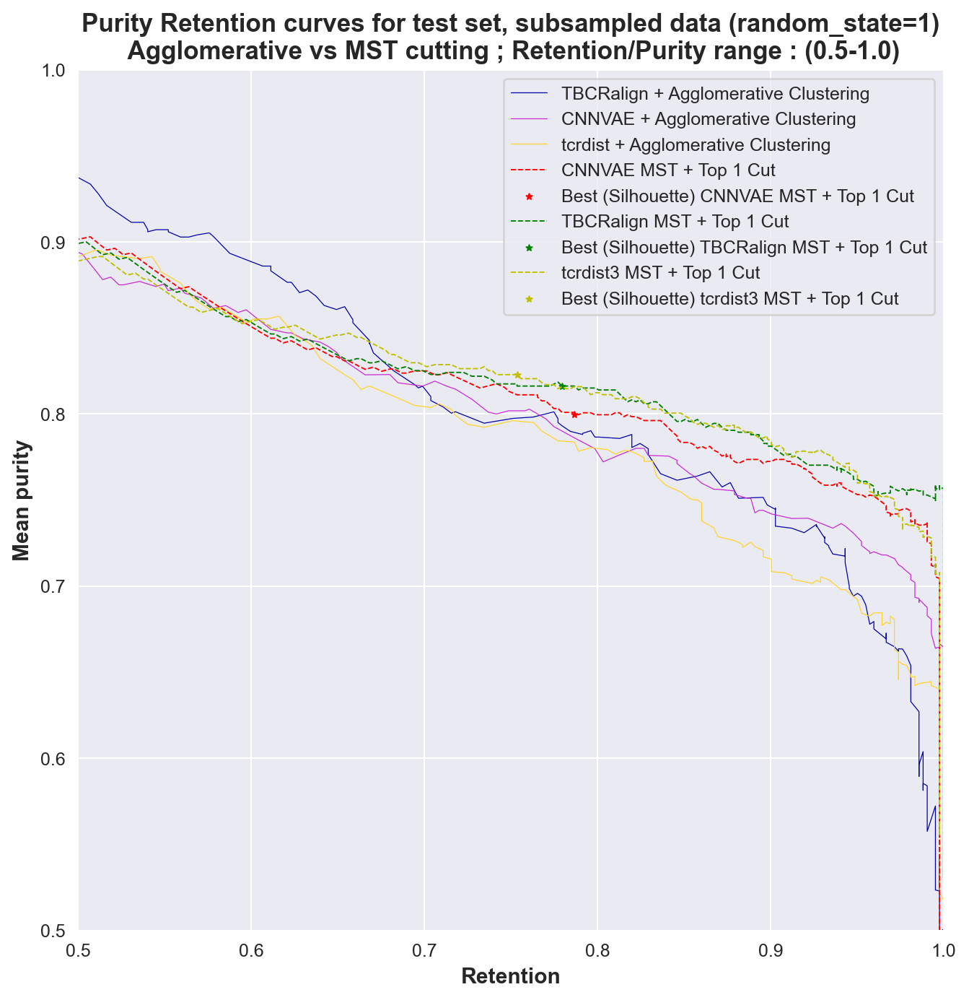

In [113]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.legend()
a.set_ylim([.5,1.])
a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/easy5peps_subsampled_testset_retpur_curves.png', dpi=200, bbox_inches='tight')

# 17 peps

## Test set, subsampled

In [220]:
import random
seed=1
random.seed(seed)
# Take test partition only, subsample
easy5peps = exp17.peptide.unique()#['ELAGIGILTV', 'GILGFVFTL', 'LLWNGPMAV', 'RAKFKQLL', 'YLQPRTFLL']
testset = exp17.query('peptide in @easy5peps and partition==1')
# Randomly subsample between 60 and 74 datapoints for each peptide:
testset_subsample = []
for p in easy5peps:
    tmp = testset.query('peptide==@p')
    testset_subsample.append(tmp.sample(min(len(tmp), random.randint(70,90)), random_state=seed))
testset_subsample = pd.concat(testset_subsample)
testset_idx = testset_subsample.query('partition==1')['raw_index'].unique()
testset_subsample.groupby('peptide').count()

,Unnamed: 0.1,Unnamed: 0,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
peptide,,,,,,,,,,,,,,,,,,
ATDALMTGF,20,20,20,20,20,20,20,20,20,20,20,20,20,20,0,20,20,20
AVFDRKSDAK,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,0,85,85
CINGVCWTV,45,45,45,45,45,45,45,45,45,45,45,45,45,45,16,45,45,45
ELAGIGILTV,88,88,88,88,88,88,88,88,88,88,88,88,88,88,88,13,88,88
GILGFVFTL,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,32,85,85
GLCTLVAML,54,54,54,54,54,54,54,54,54,54,54,54,54,54,54,33,54,54
IVTDFSVIK,64,64,64,64,64,64,64,64,64,64,64,64,64,64,64,0,64,64
KLGGALQAK,72,72,72,72,72,72,72,72,72,72,72,72,72,72,72,0,72,72
KTFPPTEPK,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [68]:
len(testset), len(testset_subsample)

(1470, 1037)

In [69]:
# re-get the baseline and re-filter based on the subset test set
dm_tbcr_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')
dm_tcrdist_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')

In [70]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1037 1037 1037


In [221]:
# Best model picked on validation performance
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_5000_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df_testset = get_latent_df(model, testset_subsample)
dm_ts128_testset, values_ts128_testset, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df_testset, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 5000
total: 0.2245618547955234
reconstruction: 0.06651628997370614
kld: 0.0
triplet: 0.0
BCE: 0.15804556644786044
seq_accuracy: 0.9947178959846497
pos_accuracy: 0.9971309900283813
auc: 0.7345
auc_01: 0.62808
auc_01_real: 0.29334
precision: 0.49085
recall: 0.3692
accuracy: 0.83052
AP: 0.4586


In [72]:
# Resort it just so that we can re-use the labels and indices in the same order
dm_tbcr_testset, values_tbcr_testset = resort_baseline(dm_tbcr_testset, dm_ts128_testset, 'raw_index')
dm_tcrdist_testset, values_tcrdist_testset = resort_baseline(dm_tcrdist_testset, dm_ts128_testset, 'raw_index')

In [73]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1037 1037 1037


In [74]:
values_tcrdist_testset[values_tcrdist_testset!=0].mean(), values_tcrdist_testset[values_tcrdist_testset!=0].min(), values_tcrdist_testset.max()

(766.1541609111522, 72, 1305)

In [79]:
print(len(values_tcrdist_testset), len(values_tbcr_testset), len(values_ts128_testset))

1037 1037 1037


In [ ]:
# Import with aliases after refactor
from src.networkx_utils import iterative_topn_cut as silhouette_score_cut, iterative_size_cut as iterative_top_cut


# Running TCRdist distmatrix
initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tcrdist_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tcrdist_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tcrdist_it_scores, tcrdist_it_purities, tcrdist_it_rets = iterative_size_cut(values_tcrdist_testset, tree, 
                                                                                                                                 initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                 initial_cut_method=initial_cut_method, 
                                                                                                                                 top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tcrdist_sh_scores, tcrdist_sh_purities, tcrdist_sh_rets = iterative_topn_cut(values_tcrdist_testset, tree, 
                                                                                                                                            initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                            initial_cut_method=initial_cut_method, 
                                                                                                                                            top_n=1, which='edge', weighted=True, 
                                                                                                                                            verbose=0, score_threshold=.5)
print(np.mean(x['cluster_size'] for x in topn_clusters), np.mean(x['cluster_size'] for x in size_clusters))

Initial mean purity, silhouette score, retention
0.3907 -0.1147 1.0


In [ ]:
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_ts128_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, it_scores, it_purities, it_rets = iterative_size_cut(values_ts128_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, sh_scores, sh_purities, sh_rets = iterative_topn_cut(values_ts128_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(x['cluster_size'] for x in topn_clusters), np.mean(x['cluster_size'] for x in size_clusters))

In [ ]:
# USING tbcralign DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tbcr_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tbcr_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tbcr_it_scores, tbcr_it_purities, tbcr_it_rets = iterative_size_cut(values_tbcr_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tbcr_sh_scores, tbcr_sh_purities, tbcr_sh_rets = iterative_topn_cut(values_tbcr_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(x['cluster_size'] for x in topn_clusters), np.mean(x['cluster_size'] for x in size_clusters))

In [ ]:
vae_cluster_testset = cluster_all_thresholds(values_ts128_testset, torch.rand([len(values_ts128_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tcrdist_cluster_testset = cluster_all_thresholds(values_tcrdist_testset, torch.rand([len(values_tcrdist_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tbcr_cluster_testset = cluster_all_thresholds(values_tbcr_testset, torch.rand([len(values_tbcr_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)

### silhouette score plots

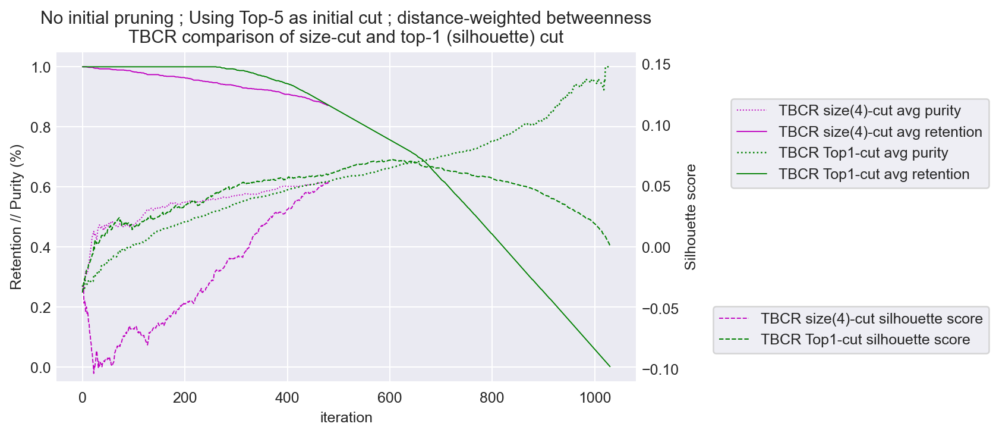

In [91]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nTBCR comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tbcr_it_purities)), tbcr_it_purities, lw=.75, ls=':', c='m',
       label='TBCR size(4)-cut avg purity')
a.plot(range(len(tbcr_it_rets)), tbcr_it_rets, lw=.75, ls='-', c='m',
       label='TBCR size(4)-cut avg retention')
a2.plot(range(len(tbcr_it_scores)), tbcr_it_scores, lw=.75, ls='--', c='m',
       label='TBCR size(4)-cut silhouette score')

a.plot(range(len(tbcr_sh_purities)), tbcr_sh_purities, lw=1, ls=':', c='g',
       label='TBCR Top1-cut avg purity')
a.plot(range(len(tbcr_sh_rets)), tbcr_sh_rets, lw=.75, ls='-', c='g',
       label='TBCR Top1-cut avg retention')
a2.plot(range(len(tbcr_sh_scores)), tbcr_sh_scores, lw=.8, ls='--', c='g',
       label='TBCR Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_subsampled_tbcr_testset_silhouette.png', dpi=150, bbox_inches='tight')


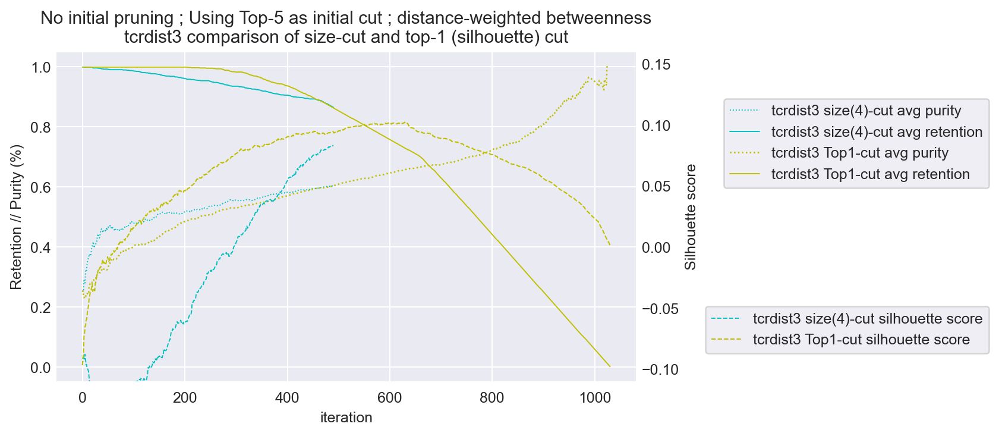

In [92]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\ntcrdist3 comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tcrdist_it_purities)), tcrdist_it_purities, lw=.75, ls=':', c='c',
       label='tcrdist3 size(4)-cut avg purity')
a.plot(range(len(tcrdist_it_rets)), tcrdist_it_rets, lw=.75, ls='-', c='c',
       label='tcrdist3 size(4)-cut avg retention')
a2.plot(range(len(tcrdist_it_scores)), tcrdist_it_scores, lw=.75, ls='--', c='c',
       label='tcrdist3 size(4)-cut silhouette score')

a.plot(range(len(tcrdist_sh_purities)), tcrdist_sh_purities, lw=1, ls=':', c='y',
       label='tcrdist3 Top1-cut avg purity')
a.plot(range(len(tcrdist_sh_rets)), tcrdist_sh_rets, lw=.75, ls='-', c='y',
       label='tcrdist3 Top1-cut avg retention')
a2.plot(range(len(tcrdist_sh_scores)), tcrdist_sh_scores, lw=.8, ls='--', c='y',
       label='tcrdist3 Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_subsampled_tcrdist3_testset_silhouette.png', dpi=150, bbox_inches='tight')

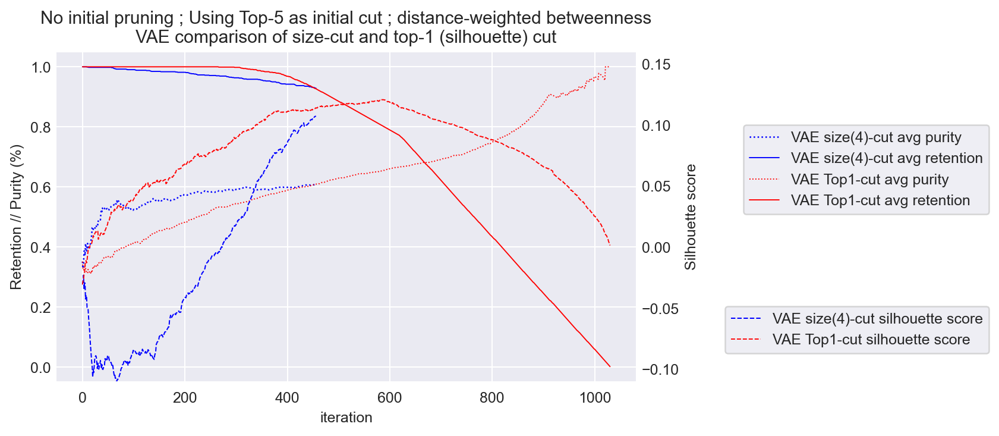

In [93]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nVAE comparison of size-cut and top-1 (silhouette) cut')
a.plot(range(len(it_purities)), it_purities, lw=1, ls=':', c='b',
       label='VAE size(4)-cut avg purity')
a.plot(range(len(it_rets)), it_rets, lw=.75, ls='-', c='b',
       label='VAE size(4)-cut avg retention')
a2.plot(range(len(it_scores)), it_scores, lw=.8, ls='--', c='b',
       label='VAE size(4)-cut silhouette score')

a.plot(range(len(sh_purities)), sh_purities, lw=.75, ls=':', c='r',
       label='VAE Top1-cut avg purity')
a.plot(range(len(sh_rets)), sh_rets, lw=.75, ls='-', c='r',
       label='VAE Top1-cut avg retention')
a2.plot(range(len(sh_scores)), sh_scores, lw=.75, ls='--', c='r',
       label='VAE Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.8))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_subsampled_vae_testset_silhouette.png', dpi=150, bbox_inches='tight')

### retpur curves

In [1295]:
pd.DataFrame([{'iteration':152, 'silhouette':.5, 'purity':.3, 'retention':.76},
              {'iteration':123, 'silhouette':.3, 'purity':.7, 'retention':.25}], index=['size_cut', 'topn_cut'])

,iteration,silhouette,purity,retention
size_cut,152,0.5,0.3,0.76
topn_cut,123,0.3,0.7,0.25


In [89]:
# Identify best point (based on Silhouette score) for each of the 4 conditions and add them as scatter points
best_sh = sh_rets[np.argmax(sh_scores)], sh_purities[np.argmax(sh_scores)]
best_it = it_rets[np.argmax(it_scores)], it_purities[np.argmax(it_scores)]
best_tbcr_sh = tbcr_sh_rets[np.argmax(tbcr_sh_scores)], tbcr_sh_purities[np.argmax(tbcr_sh_scores)]
best_tbcr_it = tbcr_it_rets[np.argmax(tbcr_it_scores)], tbcr_it_purities[np.argmax(tbcr_it_scores)]
best_tcrdist_sh = tcrdist_sh_rets[np.argmax(tcrdist_sh_scores)], tcrdist_sh_purities[np.argmax(tcrdist_sh_scores)]
best_tcrdist_it = tcrdist_it_rets[np.argmax(tcrdist_it_scores)], tcrdist_it_purities[np.argmax(tcrdist_it_scores)]

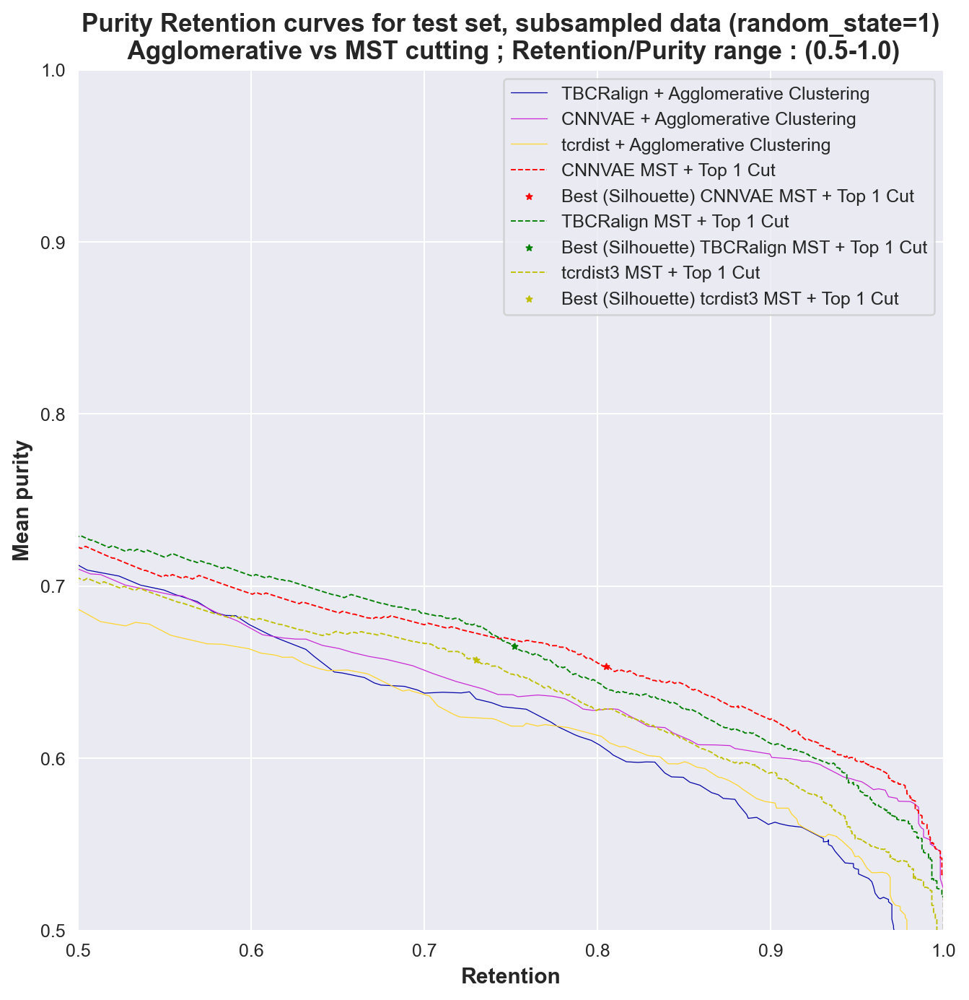

In [90]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.legend()
a.set_ylim([.5,1.])
a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_subsampled_testset_retpur_curves.png', dpi=200, bbox_inches='tight')

## 17 peps no sub

In [249]:
import random
seed=1
random.seed(seed)
# Take test partition only, subsample
easy5peps = exp17.peptide.unique()#['ELAGIGILTV', 'GILGFVFTL', 'LLWNGPMAV', 'RAKFKQLL', 'YLQPRTFLL']
testset = exp17.query('peptide in @easy5peps and partition==1')
# Randomly subsample between 60 and 74 datapoints for each peptide:
testset_subsample = []
for p in easy5peps:
    tmp = testset.query('peptide==@p')
    testset_subsample.append(tmp)#.sample(min(len(tmp), random.randint(70,90)), random_state=seed))
testset_subsample = pd.concat(testset_subsample)
testset_idx = testset_subsample.query('partition==1')['raw_index'].unique()
testset_subsample.groupby('peptide').count()

,Unnamed: 0.1,Unnamed: 0,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
peptide,,,,,,,,,,,,,,,,,,
ATDALMTGF,20,20,20,20,20,20,20,20,20,20,20,20,20,20,0,20,20,20
AVFDRKSDAK,144,144,144,144,144,144,144,144,144,144,144,144,144,144,144,0,144,144
CINGVCWTV,45,45,45,45,45,45,45,45,45,45,45,45,45,45,16,45,45,45
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,92,92,92,92,92,13,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,233,233,233,233,233,76,233,233
GLCTLVAML,54,54,54,54,54,54,54,54,54,54,54,54,54,54,54,33,54,54
IVTDFSVIK,64,64,64,64,64,64,64,64,64,64,64,64,64,64,64,0,64,64
KLGGALQAK,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,0,180,180
KTFPPTEPK,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [250]:
len(testset), len(testset_subsample)

(1470, 1470)

In [251]:
# re-get the baseline and re-filter based on the subset test set
dm_tbcr_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')
dm_tcrdist_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')

In [252]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1470 1470 1470


In [253]:
# Best model picked on validation performance
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_5000_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df_testset = get_latent_df(model, testset_subsample)
dm_ts128_testset, values_ts128_testset, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df_testset, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 5000
total: 0.2245618547955234
reconstruction: 0.06651628997370614
kld: 0.0
triplet: 0.0
BCE: 0.15804556644786044
seq_accuracy: 0.9947178959846497
pos_accuracy: 0.9971309900283813
auc: 0.7345
auc_01: 0.62808
auc_01_real: 0.29334
precision: 0.49085
recall: 0.3692
accuracy: 0.83052
AP: 0.4586


In [254]:
# Resort it just so that we can re-use the labels and indices in the same order
dm_tbcr_testset, values_tbcr_testset = resort_baseline(dm_tbcr_testset, dm_ts128_testset, 'raw_index')
dm_tcrdist_testset, values_tcrdist_testset = resort_baseline(dm_tcrdist_testset, dm_ts128_testset, 'raw_index')

In [255]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1470 1470 1470


In [121]:
values_tcrdist_testset[values_tcrdist_testset!=0].mean(), values_tcrdist_testset[values_tcrdist_testset!=0].min(), values_tcrdist_testset.max()

(760.9754351842847, 27, 1305)

In [263]:
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_ts128_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, it_scores, it_purities, it_rets = iterative_size_cut(values_ts128_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, sh_scores, sh_purities, sh_rets = iterative_topn_cut(values_ts128_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.2122 -0.0101 1.0
2.217948717948718 2.4671532846715327


In [264]:
# Running TCRdist distmatrix
initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tcrdist_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tcrdist_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tcrdist_it_scores, tcrdist_it_purities, tcrdist_it_rets = iterative_size_cut(values_tcrdist_testset, tree, 
                                                                                                                                 initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                 initial_cut_method=initial_cut_method, 
                                                                                                                                 top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tcrdist_sh_scores, tcrdist_sh_purities, tcrdist_sh_rets = iterative_topn_cut(values_tcrdist_testset, tree, 
                                                                                                                                            initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                            initial_cut_method=initial_cut_method, 
                                                                                                                                            top_n=1, which='edge', weighted=True, 
                                                                                                                                            verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.3907 -0.1147 1.0
2.204081632653061 2.5356415478615073


In [265]:
# USING tbcralign DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tbcr_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tbcr_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tbcr_it_scores, tbcr_it_purities, tbcr_it_rets = iterative_size_cut(values_tbcr_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tbcr_sh_scores, tbcr_sh_purities, tbcr_sh_rets = iterative_topn_cut(values_tbcr_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.3527 -0.0287 1.0
2.2052313883299797 2.5291750503018107


In [266]:
vae_cluster_testset = cluster_all_thresholds(values_ts128_testset, torch.rand([len(values_ts128_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tcrdist_cluster_testset = cluster_all_thresholds(values_tcrdist_testset, torch.rand([len(values_tcrdist_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tbcr_cluster_testset = cluster_all_thresholds(values_tbcr_testset, torch.rand([len(values_tbcr_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)

HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:36<00:00, 13.87it/s]


HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:24<00:00, 20.38it/s]


HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:27<00:00, 17.89it/s]


### silhouette score plots

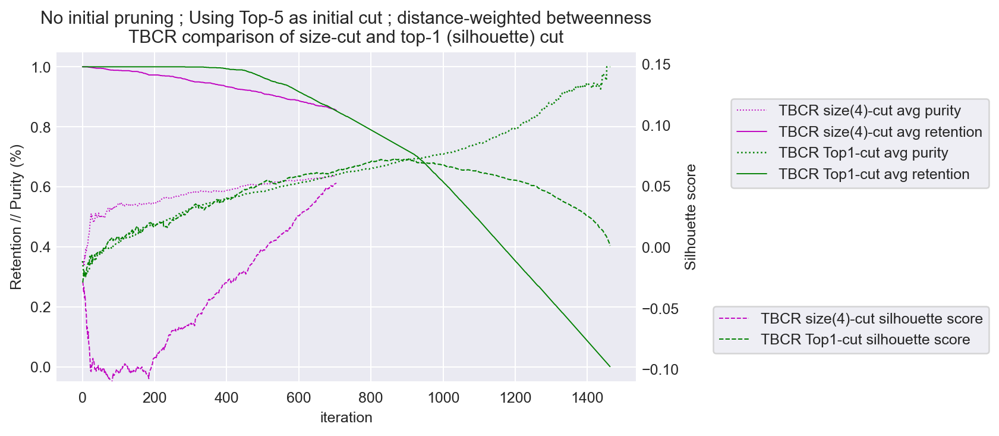

In [128]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nTBCR comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tbcr_it_purities)), tbcr_it_purities, lw=.75, ls=':', c='m',
       label='TBCR size(4)-cut avg purity')
a.plot(range(len(tbcr_it_rets)), tbcr_it_rets, lw=.75, ls='-', c='m',
       label='TBCR size(4)-cut avg retention')
a2.plot(range(len(tbcr_it_scores)), tbcr_it_scores, lw=.75, ls='--', c='m',
       label='TBCR size(4)-cut silhouette score')

a.plot(range(len(tbcr_sh_purities)), tbcr_sh_purities, lw=1, ls=':', c='g',
       label='TBCR Top1-cut avg purity')
a.plot(range(len(tbcr_sh_rets)), tbcr_sh_rets, lw=.75, ls='-', c='g',
       label='TBCR Top1-cut avg retention')
a2.plot(range(len(tbcr_sh_scores)), tbcr_sh_scores, lw=.8, ls='--', c='g',
       label='TBCR Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_tbcr_testset_silhouette.png', dpi=150, bbox_inches='tight')


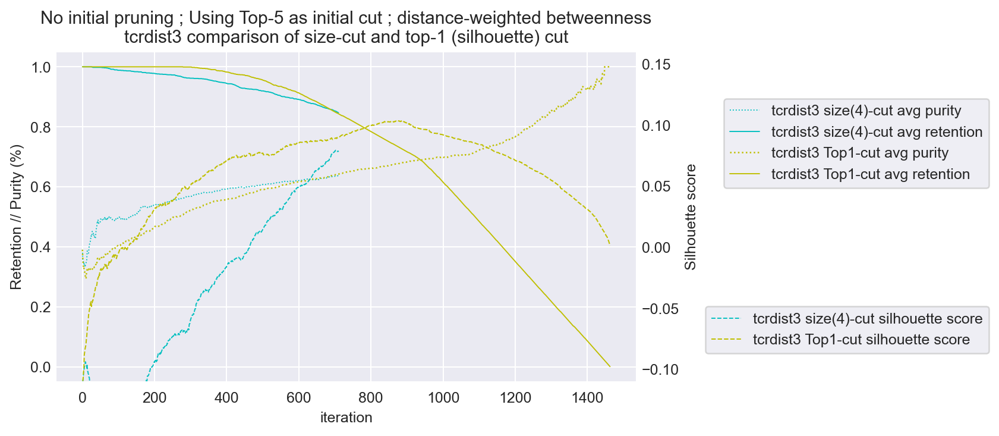

In [129]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\ntcrdist3 comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tcrdist_it_purities)), tcrdist_it_purities, lw=.75, ls=':', c='c',
       label='tcrdist3 size(4)-cut avg purity')
a.plot(range(len(tcrdist_it_rets)), tcrdist_it_rets, lw=.75, ls='-', c='c',
       label='tcrdist3 size(4)-cut avg retention')
a2.plot(range(len(tcrdist_it_scores)), tcrdist_it_scores, lw=.75, ls='--', c='c',
       label='tcrdist3 size(4)-cut silhouette score')

a.plot(range(len(tcrdist_sh_purities)), tcrdist_sh_purities, lw=1, ls=':', c='y',
       label='tcrdist3 Top1-cut avg purity')
a.plot(range(len(tcrdist_sh_rets)), tcrdist_sh_rets, lw=.75, ls='-', c='y',
       label='tcrdist3 Top1-cut avg retention')
a2.plot(range(len(tcrdist_sh_scores)), tcrdist_sh_scores, lw=.8, ls='--', c='y',
       label='tcrdist3 Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_tcrdist3_testset_silhouette.png', dpi=150, bbox_inches='tight')

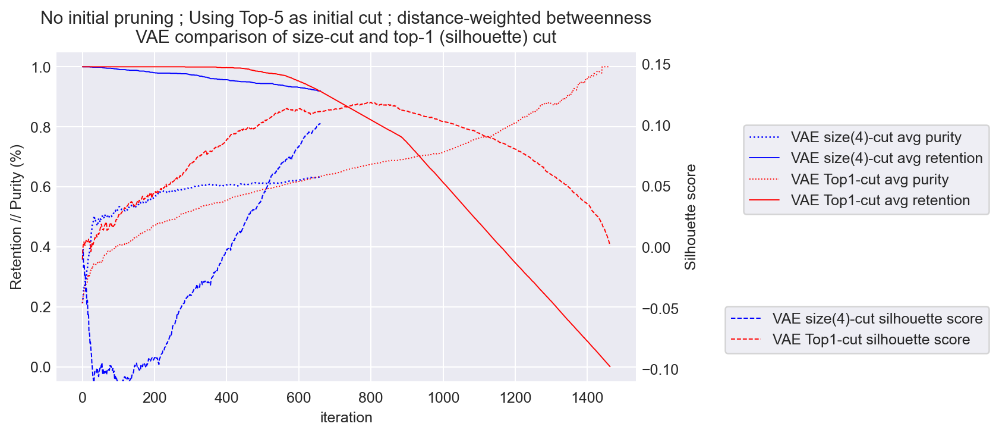

In [130]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nVAE comparison of size-cut and top-1 (silhouette) cut')
a.plot(range(len(it_purities)), it_purities, lw=1, ls=':', c='b',
       label='VAE size(4)-cut avg purity')
a.plot(range(len(it_rets)), it_rets, lw=.75, ls='-', c='b',
       label='VAE size(4)-cut avg retention')
a2.plot(range(len(it_scores)), it_scores, lw=.8, ls='--', c='b',
       label='VAE size(4)-cut silhouette score')

a.plot(range(len(sh_purities)), sh_purities, lw=.75, ls=':', c='r',
       label='VAE Top1-cut avg purity')
a.plot(range(len(sh_rets)), sh_rets, lw=.75, ls='-', c='r',
       label='VAE Top1-cut avg retention')
a2.plot(range(len(sh_scores)), sh_scores, lw=.75, ls='--', c='r',
       label='VAE Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.8))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_vae_testset_silhouette.png', dpi=150, bbox_inches='tight')

### retpur curves

In [131]:
# Identify best point (based on Silhouette score) for each of the 4 conditions and add them as scatter points
best_sh = sh_rets[np.argmax(sh_scores)], sh_purities[np.argmax(sh_scores)]
best_it = it_rets[np.argmax(it_scores)], it_purities[np.argmax(it_scores)]
best_tbcr_sh = tbcr_sh_rets[np.argmax(tbcr_sh_scores)], tbcr_sh_purities[np.argmax(tbcr_sh_scores)]
best_tbcr_it = tbcr_it_rets[np.argmax(tbcr_it_scores)], tbcr_it_purities[np.argmax(tbcr_it_scores)]
best_tcrdist_sh = tcrdist_sh_rets[np.argmax(tcrdist_sh_scores)], tcrdist_sh_purities[np.argmax(tcrdist_sh_scores)]
best_tcrdist_it = tcrdist_it_rets[np.argmax(tcrdist_it_scores)], tcrdist_it_purities[np.argmax(tcrdist_it_scores)]

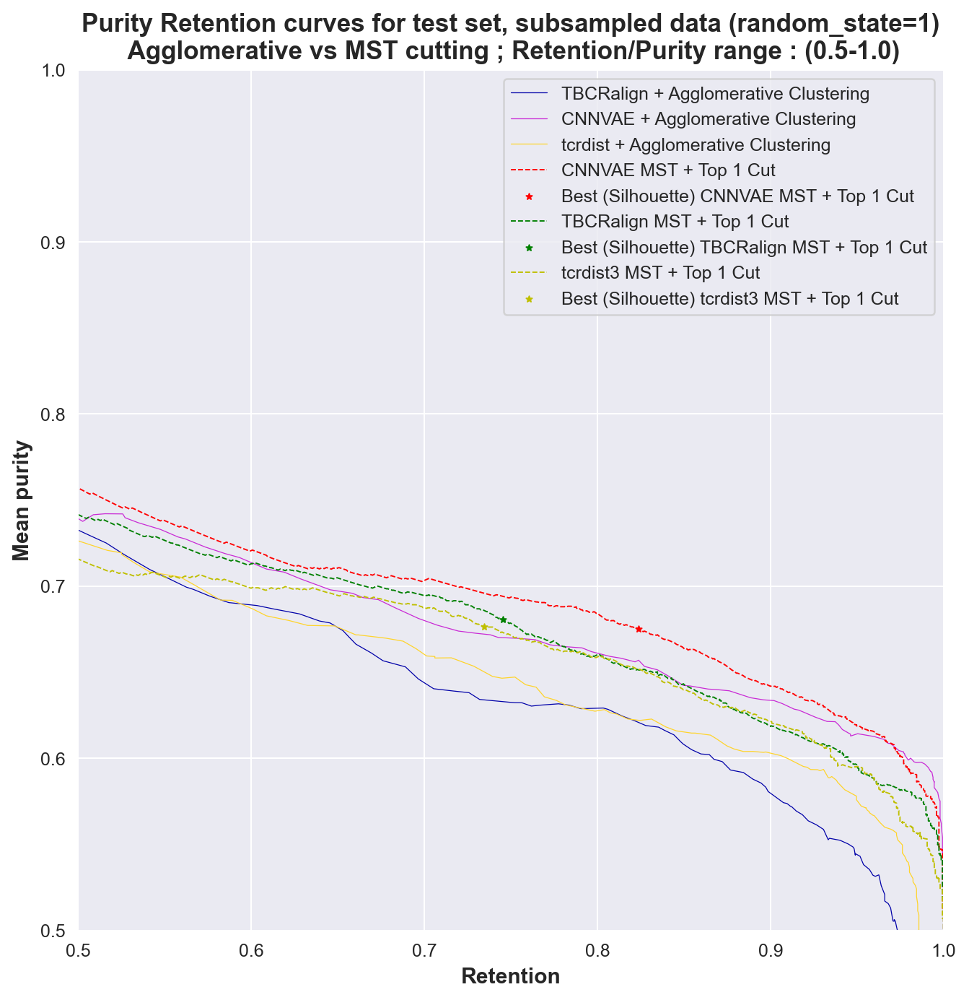

In [132]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.legend()
a.set_ylim([.5,1.])
a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for test set, no subsampling\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_testset_retpur_curves.png', dpi=200, bbox_inches='tight')

Text(0.5, 1.0, 'Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)')

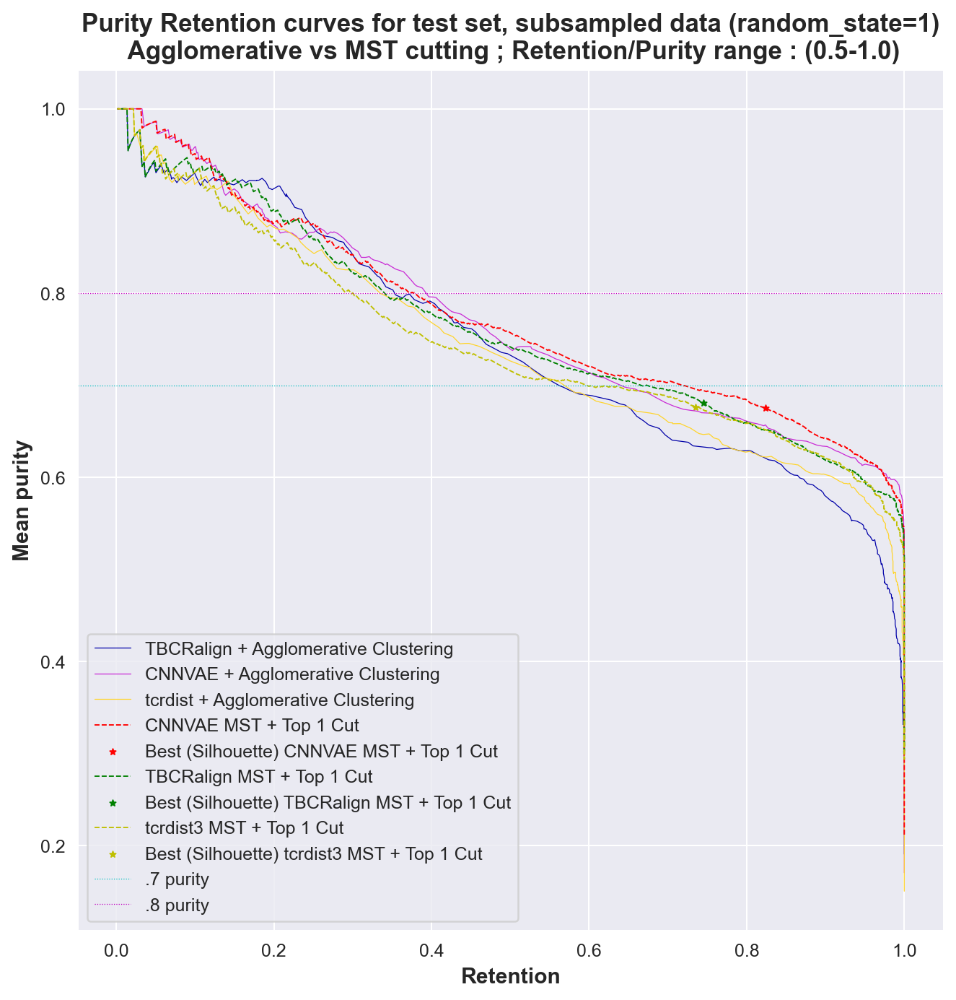

In [135]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.axhline(.7, c='c', ls=':', label='.7 purity', lw=.5)
a.axhline(.8, c='m', ls=':', label='.8 purity', lw=.5)
a.legend()
# a.set_ylim([.5,1.])
# a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
# f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_testset_retpur_curves.png', dpi=200, bbox_inches='tight')

## 17 peps no sub valid

In [267]:
import random
seed=1
random.seed(seed)
# Take test partition only, subsample
easy5peps = exp17.peptide.unique()#['ELAGIGILTV', 'GILGFVFTL', 'LLWNGPMAV', 'RAKFKQLL', 'YLQPRTFLL']
testset = exp17.query('peptide in @easy5peps and partition==0')
# Randomly subsample between 60 and 74 datapoints for each peptide:
testset_subsample = []
for p in easy5peps:
    tmp = testset.query('peptide==@p')
    testset_subsample.append(tmp)#.sample(min(len(tmp), random.randint(70,90)), random_state=seed))
testset_subsample = pd.concat(testset_subsample)
testset_idx = testset_subsample.query('partition==0')['raw_index'].unique()
testset_subsample.groupby('peptide').count()

,Unnamed: 0.1,Unnamed: 0,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
peptide,,,,,,,,,,,,,,,,,,
ATDALMTGF,20,20,20,20,20,20,20,20,20,20,20,20,20,20,0,20,20,20
AVFDRKSDAK,143,143,143,143,143,143,143,143,143,143,143,143,143,143,143,0,143,143
CINGVCWTV,45,45,45,45,45,45,45,45,45,45,45,45,45,45,17,45,45,45
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,92,92,92,92,92,7,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,233,233,233,233,233,98,233,233
GLCTLVAML,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,29,55,55
IVTDFSVIK,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,2,63,63
KLGGALQAK,181,181,181,181,181,181,181,181,181,181,181,181,181,181,181,0,181,181
KTFPPTEPK,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [268]:
len(testset), len(testset_subsample)

(1471, 1471)

In [269]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1470 1470 1471


In [270]:
# Best model picked on validation performance
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_5000_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df_testset = get_latent_df(model, testset_subsample)
dm_ts128_testset, values_ts128_testset, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df_testset, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 5000
total: 0.2245618547955234
reconstruction: 0.06651628997370614
kld: 0.0
triplet: 0.0
BCE: 0.15804556644786044
seq_accuracy: 0.9947178959846497
pos_accuracy: 0.9971309900283813
auc: 0.7345
auc_01: 0.62808
auc_01_real: 0.29334
precision: 0.49085
recall: 0.3692
accuracy: 0.83052
AP: 0.4586


In [271]:
# re-get the baseline and re-filter based on the subset test set
dm_tbcr_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('partition==0 and raw_index in @testset_idx')
dm_tcrdist_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0).query('partition==0 and raw_index in @testset_idx')
# Resort it just so that we can re-use the labels and indices in the same order
dm_tbcr_testset, values_tbcr_testset = resort_baseline(dm_tbcr_testset, dm_ts128_testset, 'raw_index')
dm_tcrdist_testset, values_tcrdist_testset = resort_baseline(dm_tcrdist_testset, dm_ts128_testset, 'raw_index')
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1471 1471 1471


In [272]:
# USING TWO STAGE VAE DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_ts128_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_ts128_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, it_scores, it_purities, it_rets = iterative_size_cut(values_ts128_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, sh_scores, sh_purities, sh_rets = iterative_topn_cut(values_ts128_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.3539 -0.0596 0.9993
2.261278195488722 2.4720149253731343


In [273]:
# Running TCRdist distmatrix
initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tcrdist_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tcrdist_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tcrdist_it_scores, tcrdist_it_purities, tcrdist_it_rets = iterative_size_cut(values_tcrdist_testset, tree, 
                                                                                                                                 initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                 initial_cut_method=initial_cut_method, 
                                                                                                                                 top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tcrdist_sh_scores, tcrdist_sh_purities, tcrdist_sh_rets = iterative_topn_cut(values_tcrdist_testset, tree, 
                                                                                                                                            initial_cut_threshold=initial_cut_threshold, 
                                                                                                                                            initial_cut_method=initial_cut_method, 
                                                                                                                                            top_n=1, which='edge', weighted=True, 
                                                                                                                                            verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.2385 0.0067 1.0
2.2131147540983607 2.5274949083503055


In [274]:
# USING tbcralign DIST MATRIX

initial_cut_threshold=5
initial_cut_method='top'
# Same starting point as usual : Create a graph, mst, then prune it by distance (that might or might not just be useless)
G, tree, dist_matrix, values_tbcr_testset, labels, encoded_labels, label_encoder, raw_indices = create_mst_from_distance_matrix(dm_tbcr_testset, label_col='peptide',
                                                                                                                   index_col='raw_index', algorithm='kruskal')
# NO INITIAL PRUNING
tree_cut, subgraphs, size_clusters, edges_cut, nodes_cut, tbcr_it_scores, tbcr_it_purities, tbcr_it_rets = iterative_size_cut(values_tbcr_testset, tree, 
                                                                                                         initial_cut_threshold=initial_cut_threshold, 
                                                                                                         initial_cut_method=initial_cut_method, 
                                                                        top_n=1, which='edge', weighted=True, verbose=0, max_size=4)

tree_cut, subgraphs, topn_clusters, edges_removed, nodes_removed, tbcr_sh_scores, tbcr_sh_purities, tbcr_sh_rets = iterative_topn_cut(values_tbcr_testset, tree, 
                                                                                                                    initial_cut_threshold=initial_cut_threshold, 
                                                                                                                    initial_cut_method=initial_cut_method, 
                                                                                                                    top_n=1, which='edge', weighted=True, 
                                                                                                                    verbose=0, score_threshold=.5)
print(np.mean(list(x['cluster_size'] for x in topn_clusters)), np.mean(list(x['cluster_size'] for x in size_clusters)))

Initial mean purity, silhouette score, retention
0.3361 -0.0224 1.0
2.1488095238095237 2.5237154150197627


In [275]:
vae_cluster_testset = cluster_all_thresholds(values_ts128_testset, torch.rand([len(values_ts128_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tcrdist_cluster_testset = cluster_all_thresholds(values_tcrdist_testset, torch.rand([len(values_tcrdist_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)
tbcr_cluster_testset = cluster_all_thresholds(values_tbcr_testset, torch.rand([len(values_tbcr_testset), 1]), labels, encoded_labels, label_encoder, n_jobs=8)

HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:28<00:00, 17.40it/s]


HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:18<00:00, 26.78it/s]


HERE


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:18<00:00, 26.60it/s]


### silhouette score plots

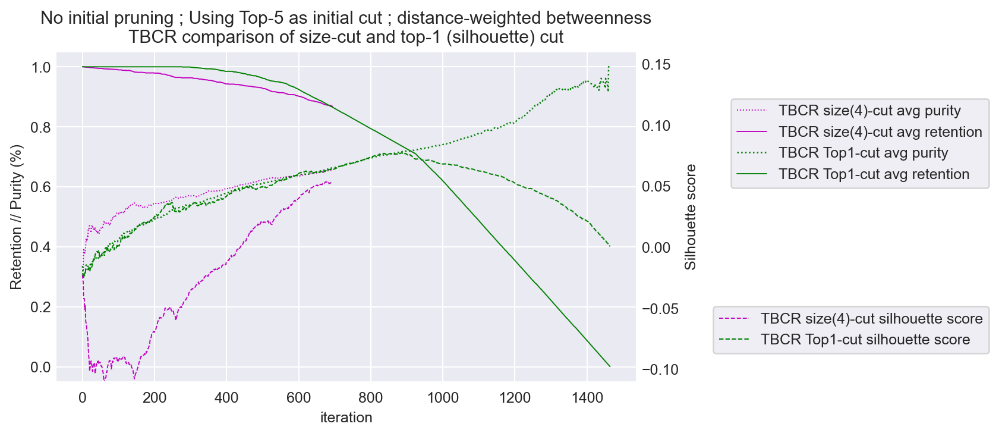

In [149]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nTBCR comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tbcr_it_purities)), tbcr_it_purities, lw=.75, ls=':', c='m',
       label='TBCR size(4)-cut avg purity')
a.plot(range(len(tbcr_it_rets)), tbcr_it_rets, lw=.75, ls='-', c='m',
       label='TBCR size(4)-cut avg retention')
a2.plot(range(len(tbcr_it_scores)), tbcr_it_scores, lw=.75, ls='--', c='m',
       label='TBCR size(4)-cut silhouette score')

a.plot(range(len(tbcr_sh_purities)), tbcr_sh_purities, lw=1, ls=':', c='g',
       label='TBCR Top1-cut avg purity')
a.plot(range(len(tbcr_sh_rets)), tbcr_sh_rets, lw=.75, ls='-', c='g',
       label='TBCR Top1-cut avg retention')
a2.plot(range(len(tbcr_sh_scores)), tbcr_sh_scores, lw=.8, ls='--', c='g',
       label='TBCR Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_tbcr_validset_silhouette.png', dpi=150, bbox_inches='tight')


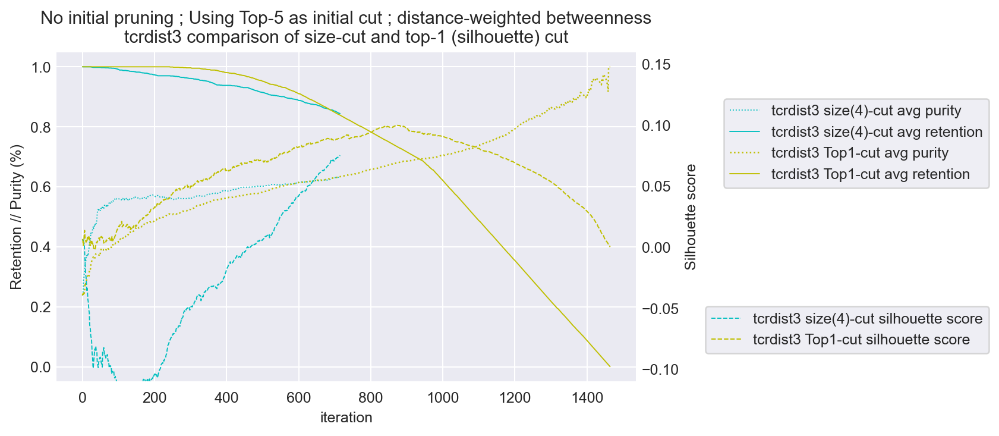

In [150]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\ntcrdist3 comparison of size-cut and top-1 (silhouette) cut')

a.plot(range(len(tcrdist_it_purities)), tcrdist_it_purities, lw=.75, ls=':', c='c',
       label='tcrdist3 size(4)-cut avg purity')
a.plot(range(len(tcrdist_it_rets)), tcrdist_it_rets, lw=.75, ls='-', c='c',
       label='tcrdist3 size(4)-cut avg retention')
a2.plot(range(len(tcrdist_it_scores)), tcrdist_it_scores, lw=.75, ls='--', c='c',
       label='tcrdist3 size(4)-cut silhouette score')

a.plot(range(len(tcrdist_sh_purities)), tcrdist_sh_purities, lw=1, ls=':', c='y',
       label='tcrdist3 Top1-cut avg purity')
a.plot(range(len(tcrdist_sh_rets)), tcrdist_sh_rets, lw=.75, ls='-', c='y',
       label='tcrdist3 Top1-cut avg retention')
a2.plot(range(len(tcrdist_sh_scores)), tcrdist_sh_scores, lw=.8, ls='--', c='y',
       label='tcrdist3 Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.88))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_tcrdist3_validset_silhouette.png', dpi=150, bbox_inches='tight')

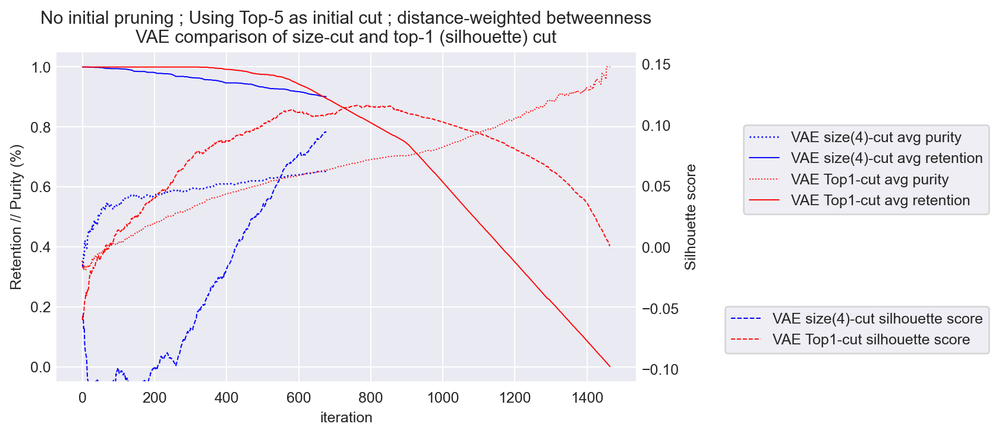

In [151]:
f,a = plt.subplots(1,1, figsize=(7,4))
a2 = a.twinx()
a.set_title('No initial pruning ; Using Top-5 as initial cut ; distance-weighted betweenness\nVAE comparison of size-cut and top-1 (silhouette) cut')
a.plot(range(len(it_purities)), it_purities, lw=1, ls=':', c='b',
       label='VAE size(4)-cut avg purity')
a.plot(range(len(it_rets)), it_rets, lw=.75, ls='-', c='b',
       label='VAE size(4)-cut avg retention')
a2.plot(range(len(it_scores)), it_scores, lw=.8, ls='--', c='b',
       label='VAE size(4)-cut silhouette score')

a.plot(range(len(sh_purities)), sh_purities, lw=.75, ls=':', c='r',
       label='VAE Top1-cut avg purity')
a.plot(range(len(sh_rets)), sh_rets, lw=.75, ls='-', c='r',
       label='VAE Top1-cut avg retention')
a2.plot(range(len(sh_scores)), sh_scores, lw=.75, ls='--', c='r',
       label='VAE Top1-cut silhouette score')

# Align the tick marks
a.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from primary y-axis
a2.yaxis.set_tick_params(which='both', length=0)  # Remove tick marks from secondary y-axis
# Align the gridlines
a.grid(True)
a2.grid(False)  # Disable secondary y-axis gridlines
a.set_ylabel('Retention // Purity (%)')
a2.set_ylabel('Silhouette score')
a2.set_ylim([-0.11,0.16])
a2.legend(bbox_to_anchor=(1.62,.25))
a.set_xlabel('iteration')
a.legend(bbox_to_anchor=(1.62,.8))
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_vae_validset_silhouette.png', dpi=150, bbox_inches='tight')

### retpur curves

In [152]:
# Identify best point (based on Silhouette score) for each of the 4 conditions and add them as scatter points
best_sh = sh_rets[np.argmax(sh_scores)], sh_purities[np.argmax(sh_scores)]
best_it = it_rets[np.argmax(it_scores)], it_purities[np.argmax(it_scores)]
best_tbcr_sh = tbcr_sh_rets[np.argmax(tbcr_sh_scores)], tbcr_sh_purities[np.argmax(tbcr_sh_scores)]
best_tbcr_it = tbcr_it_rets[np.argmax(tbcr_it_scores)], tbcr_it_purities[np.argmax(tbcr_it_scores)]
best_tcrdist_sh = tcrdist_sh_rets[np.argmax(tcrdist_sh_scores)], tcrdist_sh_purities[np.argmax(tcrdist_sh_scores)]
best_tcrdist_it = tcrdist_it_rets[np.argmax(tcrdist_it_scores)], tcrdist_it_purities[np.argmax(tcrdist_it_scores)]

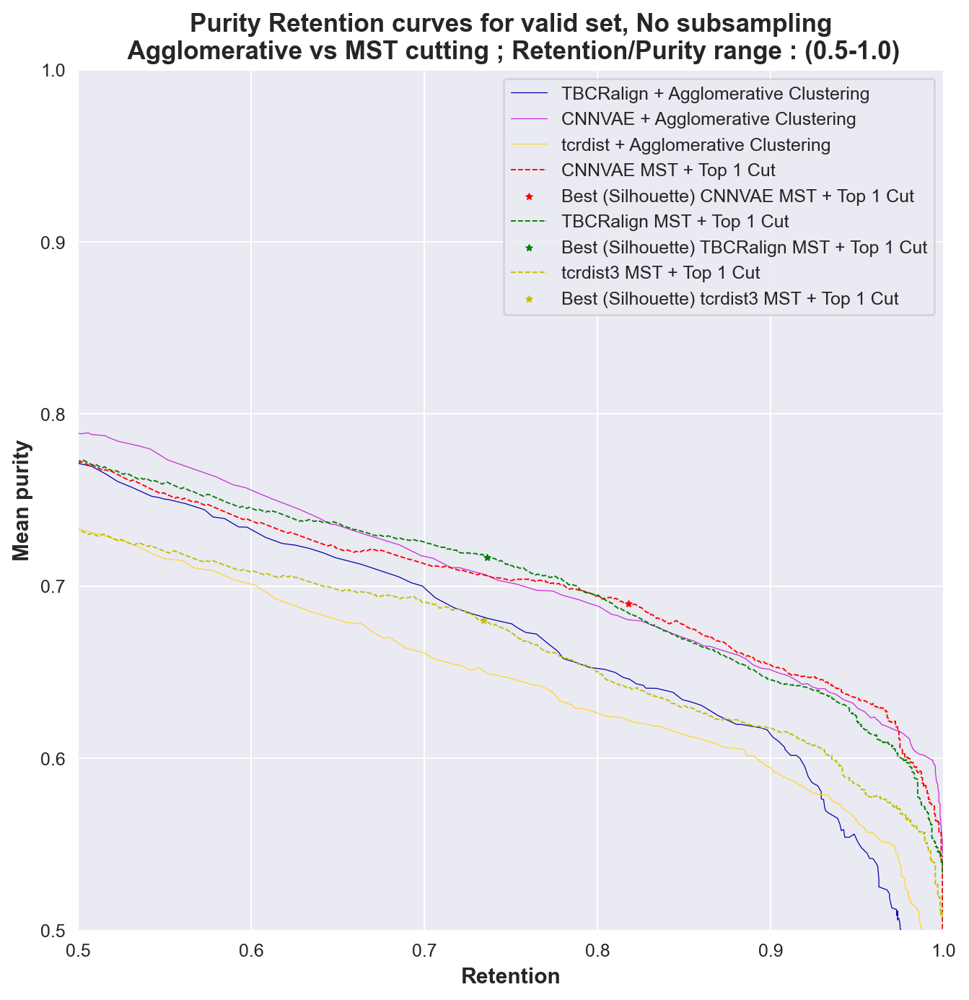

In [155]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.legend()
a.set_ylim([.5,1.])
a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for valid set, No subsampling\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_validset_retpur_curves.png', dpi=200, bbox_inches='tight')

Text(0.5, 1.0, 'Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)')

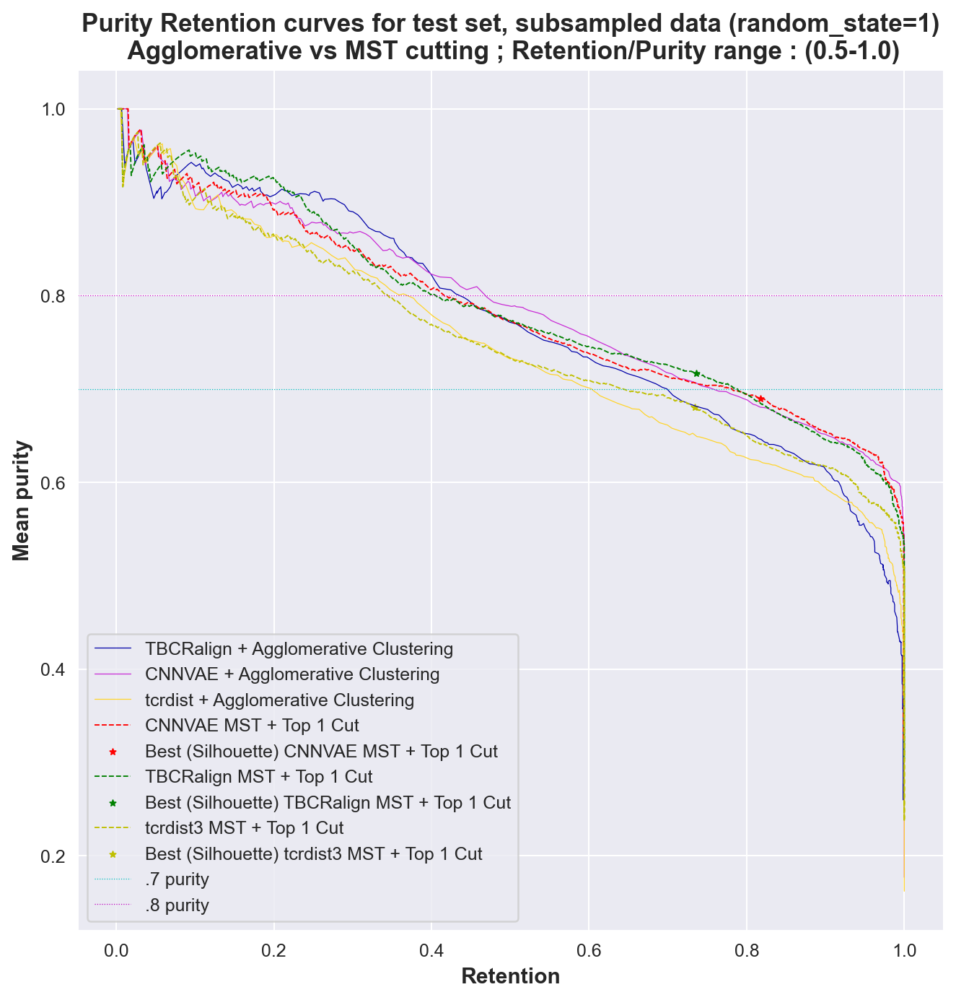

In [154]:
sns.set_palette(get_palette('gnuplot2', 3))
f,a = plt.subplots(1,1, figsize=(8.6,8.6))
lw=.75
marker_size=12
marker='*'

a.plot(tbcr_cluster_testset['retention'].values[1:-1], tbcr_cluster_testset['mean_purity'].values[1:-1], label = 'TBCRalign + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(vae_cluster_testset['retention'].values[1:-1], vae_cluster_testset['mean_purity'].values[1:-1], label = 'CNNVAE + Agglomerative Clustering', lw=0.5, ls='-')
a.plot(tcrdist_cluster_testset['retention'].values[1:-1], tcrdist_cluster_testset['mean_purity'].values[1:-1], label = 'tcrdist + Agglomerative Clustering', lw=0.5, ls='-')

a.plot(sh_rets, sh_purities, label = 'CNNVAE MST + Top 1 Cut', lw = lw, ls='--', c='r')
a.scatter(best_sh[0], best_sh[1], c='r', label = 'Best (Silhouette) CNNVAE MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(it_rets, it_purities, label = 'CNNVAE MST + Size (4) Cut', lw = lw, ls='--', c='b')
# a.scatter(best_it[0], best_it[1], c='b', label = 'Best (Silhouette) CNNVAE MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.plot(tbcr_sh_rets, tbcr_sh_purities, label = 'TBCRalign MST + Top 1 Cut', lw = lw, ls='--', c='g')
a.scatter(best_tbcr_sh[0], best_tbcr_sh[1], c='g', label = 'Best (Silhouette) TBCRalign MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tbcr_it_rets, tbcr_it_purities, label = 'TBCRalign MST + Size (4) Cut', lw = lw, ls='--', c='m')
# a.scatter(best_tbcr_it[0], best_tbcr_it[1], c='m', label = 'Best (Silhouette) TBCRalign MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)


a.plot(tcrdist_sh_rets, tcrdist_sh_purities, label = 'tcrdist3 MST + Top 1 Cut', lw = lw, ls='--', c='y')
a.scatter(best_tcrdist_sh[0], best_tcrdist_sh[1], c='y', label = 'Best (Silhouette) tcrdist3 MST + Top 1 Cut', s=marker_size, marker=marker, lw=lw)

# a.plot(tcrdist_it_rets, tcrdist_it_purities, label = 'tcrdist3 MST + Size (4) Cut', lw = lw, ls='--', c='c')
# a.scatter(best_tcrdist_it[0], best_tcrdist_it[1], c='c', label = 'Best (Silhouette) tcrdist3 MST + Size (4) Cut', s=marker_size, marker=marker, lw=lw)

a.axhline(.7, c='c', ls=':', label='.7 purity', lw=.5)
a.axhline(.8, c='m', ls=':', label='.8 purity', lw=.5)
a.legend()
# a.set_ylim([.5,1.])
# a.set_xlim([.5,1.])
a.set_xlabel('Retention', fontsize=12, fontweight='semibold')
a.set_ylabel('Mean purity', fontsize=12, fontweight='semibold')
a.set_title('Purity Retention curves for test set, subsampled data (random_state=1)\n Agglomerative vs MST cutting ; Retention/Purity range : (0.5-1.0)', fontweight='semibold', fontsize=14)
# f.savefig('../output/240618_NestedKCV_CNNVAE/notebook_figs/17peps_nosub_testset_retpur_curves.png', dpi=200, bbox_inches='tight')

# Compare all 3 CNNs vs TBCR and tcrdist

# Louvain / Leiden with thresholding ?

In [226]:
import random
seed=131
random.seed(seed)
# Take test partition only, subsample
easy5peps = exp17.peptide.unique()#['ELAGIGILTV', 'GILGFVFTL', 'LLWNGPMAV', 'RAKFKQLL', 'YLQPRTFLL']
testset = exp17.query('peptide in @easy5peps and partition==1')
# Randomly subsample between 60 and 74 datapoints for each peptide:
testset_subsample = []
for p in easy5peps:
    tmp = testset.query('peptide==@p')
    testset_subsample.append(tmp.sample(min(len(tmp), random.randint(70,90)), random_state=seed))
testset_subsample = pd.concat(testset_subsample)
testset_idx = testset_subsample.query('partition==1')['raw_index'].unique()
testset_subsample.groupby('peptide').count()

,Unnamed: 0.1,Unnamed: 0,A1,A2,A3,B1,B2,B3,allele,partition,binder,origin,original_peptide,raw_index,reference,source_organism,input_type,db
peptide,,,,,,,,,,,,,,,,,,
ATDALMTGF,20,20,20,20,20,20,20,20,20,20,20,20,20,20,0,20,20,20
AVFDRKSDAK,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,0,82,82
CINGVCWTV,45,45,45,45,45,45,45,45,45,45,45,45,45,45,16,45,45,45
ELAGIGILTV,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,11,81,81
GILGFVFTL,79,79,79,79,79,79,79,79,79,79,79,79,79,79,79,22,79,79
GLCTLVAML,54,54,54,54,54,54,54,54,54,54,54,54,54,54,54,33,54,54
IVTDFSVIK,64,64,64,64,64,64,64,64,64,64,64,64,64,64,64,0,64,64
KLGGALQAK,86,86,86,86,86,86,86,86,86,86,86,86,86,86,86,0,86,86
KTFPPTEPK,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [227]:
len(testset), len(testset_subsample)

(1470, 1054)

In [228]:
# re-get the baseline and re-filter based on the subset test set
dm_tbcr_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')
dm_tcrdist_testset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/tcrdist3_distmatrix_140peps_new_labeled.csv', index_col=0).query('partition==1 and raw_index in @testset_idx')

In [229]:
# Best model picked on validation performance
model = load_model_full('../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/epoch_5000_interval_checkpoint__kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj.pt',
                        '../output/240618_NestedKCV_CNNVAE/Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj/checkpoint_best_kcv_fold_00_Nested_TwoStageCNNVAE_latent_128_kld_1e-2_ExpData_KFold_0_240618_1608_pDQhj_JSON_kwargs.json',
                        map_location='cpu')
latent_df_testset = get_latent_df(model, testset_subsample)
dm_ts128_testset, values_ts128_testset, feats, labels, enc_labels, lab_enc = get_distances_labels_from_latent(latent_df_testset, index_col='raw_index')

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
Reloading best model:
epoch: 5000
total: 0.2245618547955234
reconstruction: 0.06651628997370614
kld: 0.0
triplet: 0.0
BCE: 0.15804556644786044
seq_accuracy: 0.9947178959846497
pos_accuracy: 0.9971309900283813
auc: 0.7345
auc_01: 0.62808
auc_01_real: 0.29334
precision: 0.49085
recall: 0.3692
accuracy: 0.83052
AP: 0.4586


In [230]:
# Resort it just so that we can re-use the labels and indices in the same order
dm_tbcr_testset, values_tbcr_testset = resort_baseline(dm_tbcr_testset, dm_ts128_testset, 'raw_index')
dm_tcrdist_testset, values_tcrdist_testset = resort_baseline(dm_tcrdist_testset, dm_ts128_testset, 'raw_index')

In [231]:
print(len(dm_tbcr_testset), len(dm_tcrdist_testset), len(testset_subsample))

1054 1054 1054


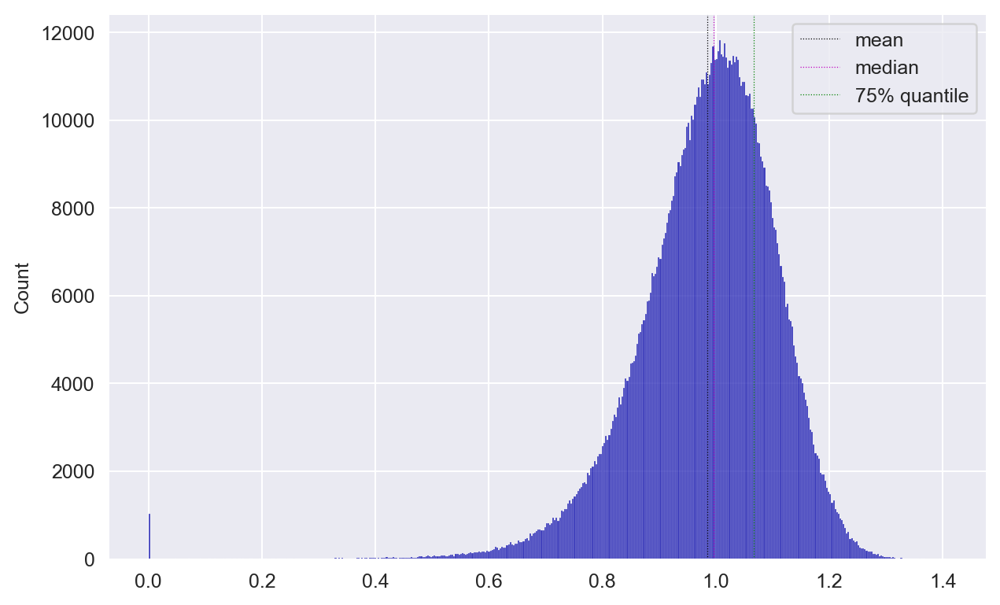

In [218]:
fig, ax = plt.subplots(1,1, figsize=(8,5))
sns.histplot(values_ts128_testset[values_ts128_testset!=-1], ax =ax)
ax.axvline(values_ts128_testset[values_ts128_testset!=0].mean(), label='mean', c='k', ls=':', lw=0.5)
ax.axvline(np.median(values_ts128_testset[values_ts128_testset!=0]), label='median', c='m', ls=':', lw=0.5)
ax.axvline(np.quantile(values_ts128_testset[values_ts128_testset!=0],0.75), label='75% quantile', c='g', ls=':', lw=0.5)
ax.legend()

In [217]:
import igraph as ig
import leidenalg

# threshold at 75% quantile and take that as sparse matrix
q = 0.9
thresholded = values_ts128_testset<np.quantile(values_ts128_testset[values_ts128_testset!=0], q)
thresholded = thresholded * values_ts128_testset
t_graph = nx.Graph(thresholded)
# Get igGraph
edges = [(u,v, data['weight']) for u,v ,data in t_graph.edges(data=True)]
t_ig_graph = ig.Graph.from_networkx(, weights=True)
partition = leidenalg.find_partition(t_ig_graph, leidenalg.ModularityVertexPartition)
print(max(partition.membership))
print(partition.membership)


2
[1, 1, 1, 0, 2, 1, 1, 1, 2, 2, 1, 0, 1, 2, 0, 0, 0, 1, 2, 2, 1, 1, 2, 0, 1, 2, 0, 1, 1, 0, 1, 0, 0, 1, 2, 0, 1, 1, 2, 2, 0, 0, 0, 1, 2, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 1, 0, 1, 2, 2, 2, 2, 1, 0, 0, 1, 2, 2, 1, 2, 1, 1, 0, 1, 0, 2, 0, 1, 2, 1, 0, 1, 0, 1, 1, 2, 1, 1, 0, 0, 1, 1, 1, 1, 2, 0, 0, 1, 1, 2, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 2, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 2, 0, 1, 0, 1, 0, 2, 1, 1, 1, 0, 1, 0, 2, 0, 0, 0, 1, 0, 1, 2, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 2, 1, 0, 2, 1, 0, 0, 1, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 2, 0, 1, 0, 0, 0, 2, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 2, 0, 1, 0, 1, 0, 2, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 0, 2, 0, 2, 1, 0, 2, 2, 2, 1, 0, 1, 0, 0, 1, 1, 0, 2, 2, 1, 1, 1, 0, 2, 0, 2, 1, 2, 1, 0, 2, 2, 0, 0, 2, 2, 1, 1, 2, 2, 0, 1, 1, 1, 0, 0, 0, 2, 0, 0, 2, 0, 0, 2, 0, 0, 2, 2, 1, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 1, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2